# Imports

In [2]:
import gdal

import pandas as pd
import numpy as np
from scipy import stats

 
from sklearn.preprocessing import PolynomialFeatures
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
import xgboost as xgb
import sklearn.metrics
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import permutation_test_score

import hazelbean as hb

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib 
from mpl_toolkits.axes_grid1 import AxesGrid
from mpl_toolkits.basemap import Basemap
%matplotlib inline

pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)


import pickle

# Load dataset

## Baseline data

In [3]:
###TODO load_new_data():

def load_baseline_df():
    crop_types_df = pd.read_csv('../ipbes_invest_crop_yield_project/intermediate/aggregate_crops_by_type/aggregated_crop_data.csv')
    df_land = pd.read_csv('../ipbes_invest_crop_yield_project/intermediate/create_baseline_regression_data/baseline_regression_data.csv')
    df = crop_types_df.merge(df_land,how='outer',on='pixel_id')
    
    #Remove cal_per_ha per crop type for now
    df = df.drop(labels=['c3_annual_calories_per_ha', 'c3_perennial_calories_per_ha',
           'c4_annual_calories_per_ha', 'c4_perennial_calories_per_ha',
           'nitrogen_fixer_calories_per_ha'], axis=1)

    #Remove helper columns (not features)
    df = df.drop(labels=['Unnamed: 0', 'country_ids',
           'ha_per_cell_5m'], axis=1)
    
    return df

def data_preprocessing(df):
    
    # Rename cols
    df = df.rename(columns={'minutes_to_market_5m': 'min_to_market',
                            'gdp_per_capita_2000_5m': 'gdp_per_capita',
                            'gdp_2000': 'gdp'})
    
    # Encode properly NaNs
    df['slope'] = df['slope'].replace({0: np.nan})  # 143 NaN in 'slope' variable
    for soil_var in ['workability_index', 'toxicity_index', 'rooting_conditions_index', 'oxygen_availability_index',
                     'nutrient_retention_index', 'nutrient_availability_index', 'excess_salts_index']:
        df[soil_var] = df[soil_var].replace({255: np.nan})
        
    # Drop NaN
    df = df.dropna()
    df = df[df['calories_per_ha'] != 0]    
    
    #Encode climate zones (as str)
    climate_zones_map = {1:'Af',2:'Am',3:'Aw',
                     5:'BWk',4:'BWh',7:'BSk',6:'BSh',
                     14:'Cfa',15:'Cfb',16:'Cfc',8:'Csa',
                     9:'Csb',10:'Csc',11:'Cwa',12:'Cwb',13:'Cwc',
                     25:'Dfa',26:'Dfb',27:'Dfc',28:'Dfd',17:'Dsa',18:'Dsb',19:'Dsc',
                     20:'Dsd',21:'Dwa',22:'Dwb',23:'Dwc',24:'Dwd',
                     30:'EF',29:'ET'}
    df['climate_zones'] = df['climate_zones'].map(climate_zones_map)
    
    # Encode climate zones as dummies
    climate_dummies_df = pd.get_dummies(df['climate_zones'])
    for col in climate_dummies_df.columns:
        climate_dummies_df = climate_dummies_df.rename({col:str('climatezone_'+col)},axis=1)
    
    df = df.merge(climate_dummies_df, right_index=True,left_index=True)
    df = df.drop('climate_zones',axis=1)
    
    # Lat/Lon
    df['sin_lon'] = df['lon'].apply(lambda x:np.sin(np.radians(x)))
    df = df.drop('lon',axis=1)
    #df['sin_lat'] = df['lat'].apply(lambda x:np.sin(np.radians(x)))
    
    # Log some skewed variables
    df['calories_per_ha'] = df['calories_per_ha'].apply(lambda x: np.log(x) if x != 0 else 0)

    for col in ['gdp_per_capita','altitude', 'min_to_market', 'gpw_population']:
        df[str('log_'+col)] = df[col].apply(lambda x: np.log(x) if x != 0 else 0)
        df = df.drop(col,axis=1)
        
        
    # Slope
    df['slope'] = df['slope'].apply(lambda x:x-90)
                
    
    # Cols to drop
    for col in ['pixel_id_float', 'land_mask']:
        df = df.drop(col,axis=1)
    
    #Set index 'pixel_id'
    df = df.set_index('pixel_id')

    return df

In [4]:
baseline_df = data_preprocessing(load_baseline_df())

In [4]:
baseline_df.name = 'baseline'

In [22]:
X = baseline_df.drop(['calories_per_ha'], axis=1)
y = baseline_df['calories_per_ha']

In [130]:
len(baseline_df)

579523

In [6]:
## Save baseline_df for future uses
#baseline_df = baseline_df.rename({'calories_per_ha':'log_cal_per_ha'}, axis='columns')
baseline_df.to_csv('../ipbes_invest_crop_yield_project/intermediate/create_baseline_regression_data/baseline_df.csv')

## Climate scenarios data

In [13]:
futureclimate = pd.read_csv('../ipbes_invest_crop_yield_project/intermediate/create_climate_regression_data/climate_regression_data.csv')


In [ ]:
#For reference:

rcp = ['45', '85']  # RCP4.5 and 8.4
var = ['bi']  # bi is the bioclimatic vars. otherws are all precip or temp sspecific
year = ['50', '70'] #2050 2070

In [16]:
rcp45_2050_df = create_newclimate_df('45bi50')
rcp45_2070_df = create_newclimate_df('45bi70')

rcp85_2050_df = create_newclimate_df('85bi50')
rcp85_2070_df = create_newclimate_df('85bi70')

In [15]:
baseline_wo_climate_cols = baseline_df.columns.drop(['temp_avg', 'temp_diurnalrange', 'temp_isothermality',
       'temp_seasonality', 'temp_annualmax', 'temp_annualmin',
       'temp_annualrange', 'precip', 'precip_wet_mth', 'precip_dry_mth',
       'precip_seasonality'])


def create_newclimate_df(rcp_year):

    rcp45_2050_cols = ['pixel_id'] 
    for col in futureclimate.columns:
        if rcp_year in col:
            rcp45_2050_cols.append(col)

    rcp45_2050 = futureclimate[rcp45_2050_cols].set_index('pixel_id')


    # Drop unused columns
    unused_climate_cols = [
        'ensemble_mean_'+rcp_year+"8_Mean_Temperature_of_Wettest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"9_Mean_Temperature_of_Driest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"10_Mean_Temperature_of_Warmest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"11_Mean_Temperature_of_Coldest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"16_Precipitation_of_Wettest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"17_Precipitation_of_Driest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"18_Precipitation_of_Warmest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"19_Precipitation_of_Coldest_Quarter_compressed.tif"]
    #rcp45_2050 = rcp45_2050.drop(unused_climate_cols,axis=1)


    # Rename columns to match
    rcp45_2050 = rcp45_2050.rename(columns={'ensemble_mean_'+rcp_year+'1_annual_mean_temperature_compressed' :'temp_avg',
                                            'ensemble_mean_'+rcp_year+"2_mean_diurnal_range_compressed":'temp_diurnalrange',
                                            'ensemble_mean_'+rcp_year+"3_isothermality_compressed":'temp_isothermality',
                                            'ensemble_mean_'+rcp_year+"4_temperature_seasonality_compressed":'temp_seasonality',
                                            'ensemble_mean_'+rcp_year+"5_max_temperature_of_warmest_month_compressed":'temp_annualmax',
                                            'ensemble_mean_'+rcp_year+"6_min_temperature_of_coldest_month_compressed":'temp_annualmin',
                                            'ensemble_mean_'+rcp_year+"7_temperature_annual_range_compressed":'temp_annualrange',

                                            'ensemble_mean_'+rcp_year+"12_annual_precipitation_compressed":'precip',
                                            'ensemble_mean_'+rcp_year+"13_precipitation_of_wettest_month_compressed":'precip_wet_mth',
                                            'ensemble_mean_'+rcp_year+"14_precipitation_of_driest_month_compressed":'precip_dry_mth',
                                            'ensemble_mean_'+rcp_year+"15_precipitation_seasonality_compressed":'precip_seasonality'})


    #Merge with baseline_df_wo_climate
    rcp45_2050_df = rcp45_2050.merge(baseline_df[baseline_wo_climate_cols],how='inner',right_index=True,left_index=True)
    
    # Sort cols in the same order as training data, or xgb fails
    # (This is dumb, xgb!)
    rcp45_2050_df = rcp45_2050_df[['slope', 'workability_index', 'toxicity_index',
       'rooting_conditions_index', 'protected_areas_index',
       'oxygen_availability_index', 'nutrient_retention_index',
       'nutrient_availability_index', 'excess_salts_index', 'gdp', 'temp_avg',
       'temp_diurnalrange', 'temp_isothermality', 'temp_seasonality',
       'temp_annualmax', 'temp_annualmin', 'temp_annualrange', 'precip',
       'precip_wet_mth', 'precip_dry_mth', 'precip_seasonality', 'lat',
       'climatezone_Af', 'climatezone_Am', 'climatezone_Aw', 'climatezone_BSh',
       'climatezone_BSk', 'climatezone_BWh', 'climatezone_BWk',
       'climatezone_Cfa', 'climatezone_Cfb', 'climatezone_Cfc',
       'climatezone_Csa', 'climatezone_Csb', 'climatezone_Csc',
       'climatezone_Cwa', 'climatezone_Cwb', 'climatezone_Cwc',
       'climatezone_Dfa', 'climatezone_Dfb', 'climatezone_Dfc',
       'climatezone_Dfd', 'climatezone_Dsa', 'climatezone_Dsb',
       'climatezone_Dsc', 'climatezone_Dsd', 'climatezone_Dwa',
       'climatezone_Dwb', 'climatezone_Dwc', 'climatezone_Dwd',
       'climatezone_EF', 'climatezone_ET', 'sin_lon', 'log_gdp_per_capita',
       'log_altitude', 'log_min_to_market', 'log_gpw_population']]
    
    rcp45_2050_df.name = rcp_year
    
    return rcp45_2050_df


# Utilities functions

In [51]:
def make_polynomial(df, degree = 2, interaction_terms = True):
#'''Returns a new dataFrame with added polynomial terms degree >= 2'''


    if interaction_terms == False:
        x = df.drop(['calories_per_ha'], axis=1)
        y = df['calories_per_ha']

        for deg in range(2,degree+1):
            for col in x.columns:
                x[str(col+'^'+str(deg))] = x[col].apply(lambda x:x**deg)
        
        Poly_df = x.merge(pd.DataFrame(y),right_index=True,left_index=True)

    if interaction_terms == True:
        x = df.drop(['calories_per_ha'], axis=1)
        y = df['calories_per_ha'].reset_index()

        poly = PolynomialFeatures(degree=degree, include_bias=False)
        X2 = poly.fit_transform(x)

        Poly_df = pd.DataFrame(data = np.concatenate((y.as_matrix(),X2),axis=1),
                               columns = ['pixel_id','calories_per_ha'] +
                               poly.get_feature_names((df.drop(['calories_per_ha'], axis=1)).columns))

        Poly_df = Poly_df.set_index('pixel_id')

    return Poly_df


# Output results Loops (over steps below)

## Loop - Make results from (Subset = None) * baseline_df


Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


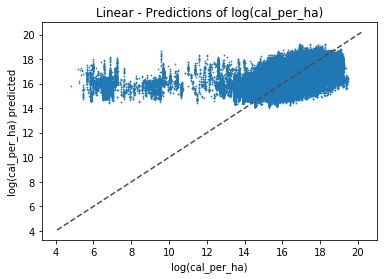

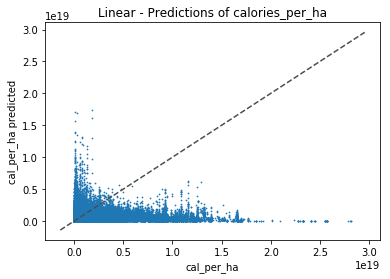

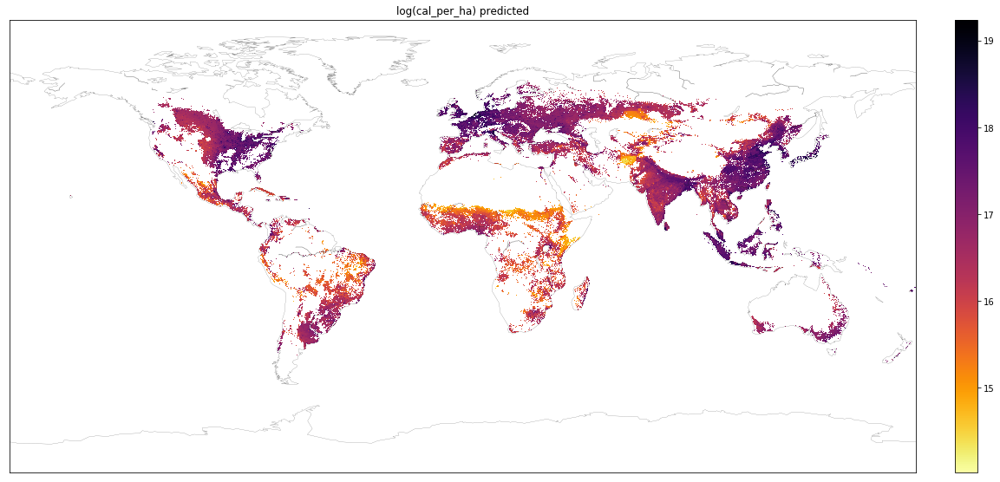

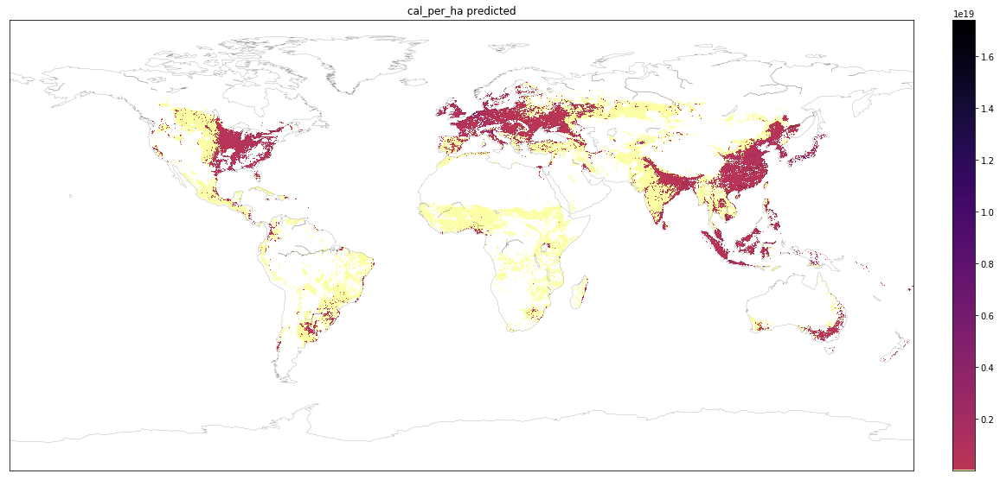

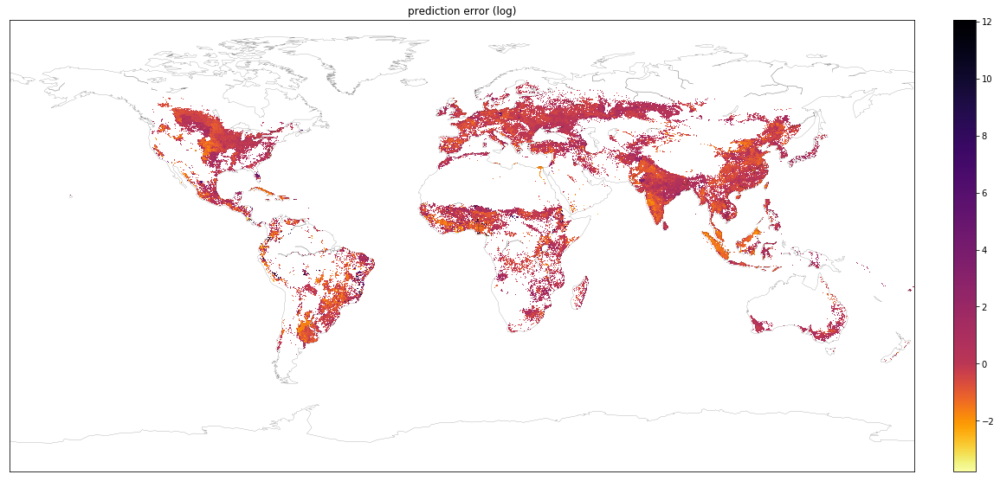

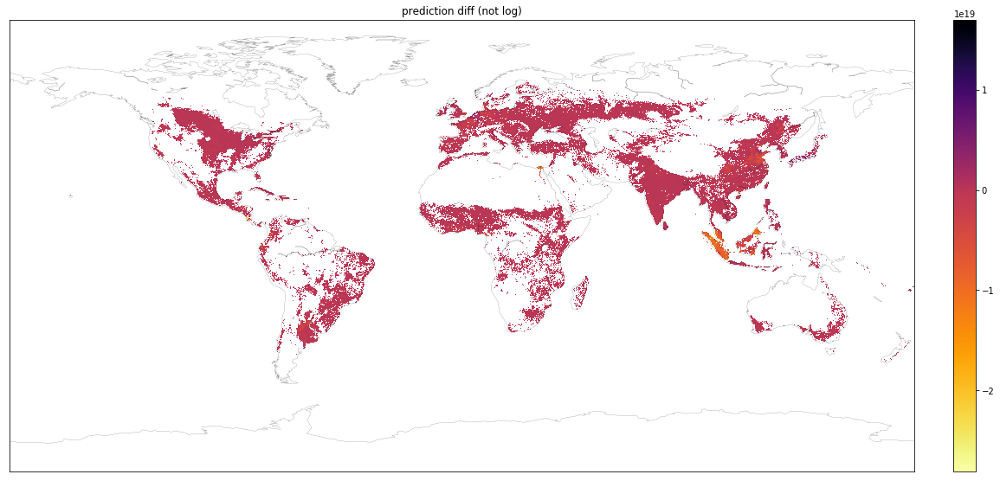

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


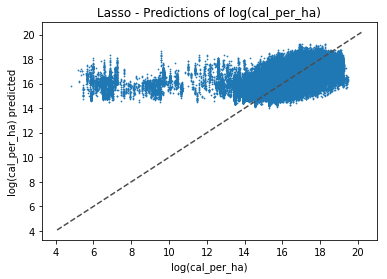

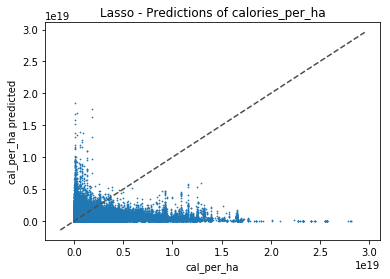

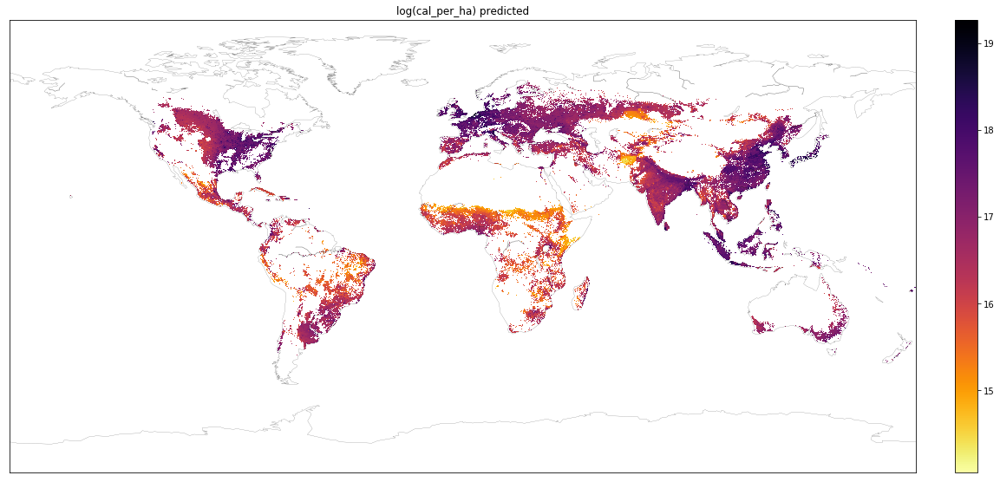

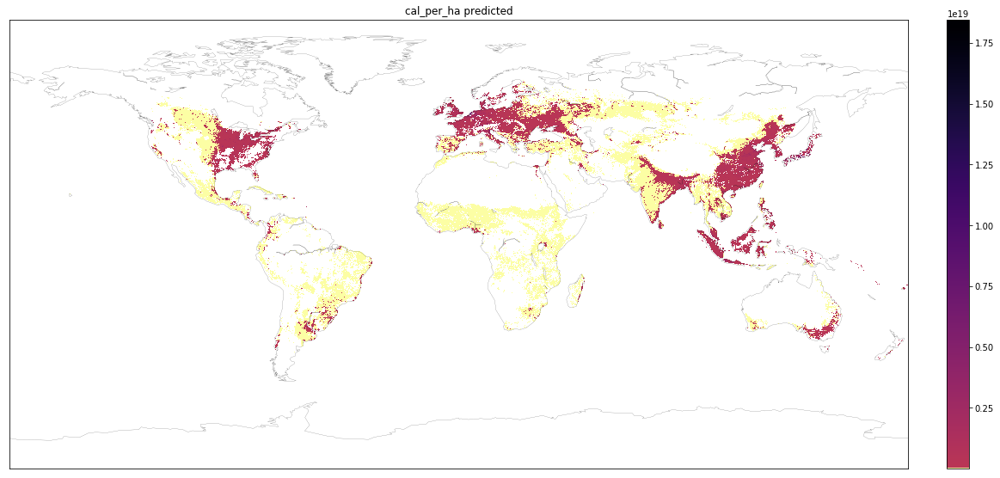

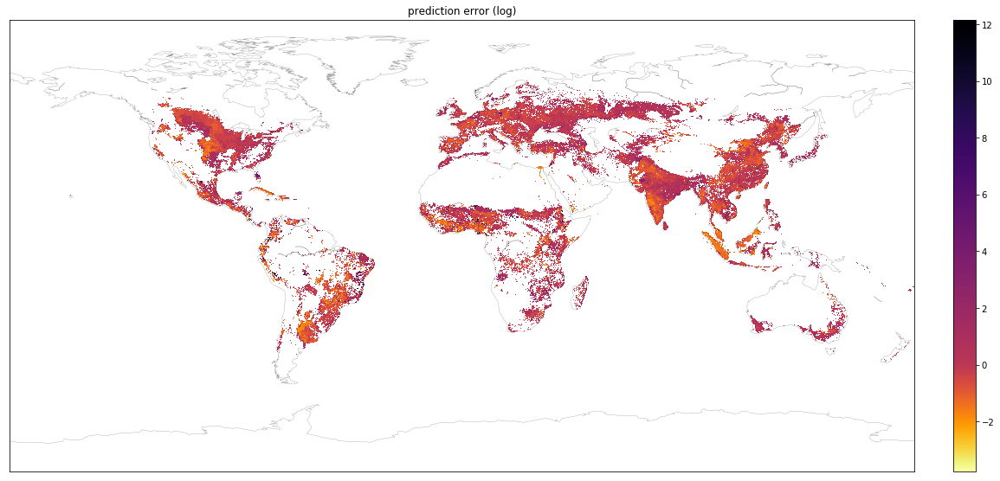

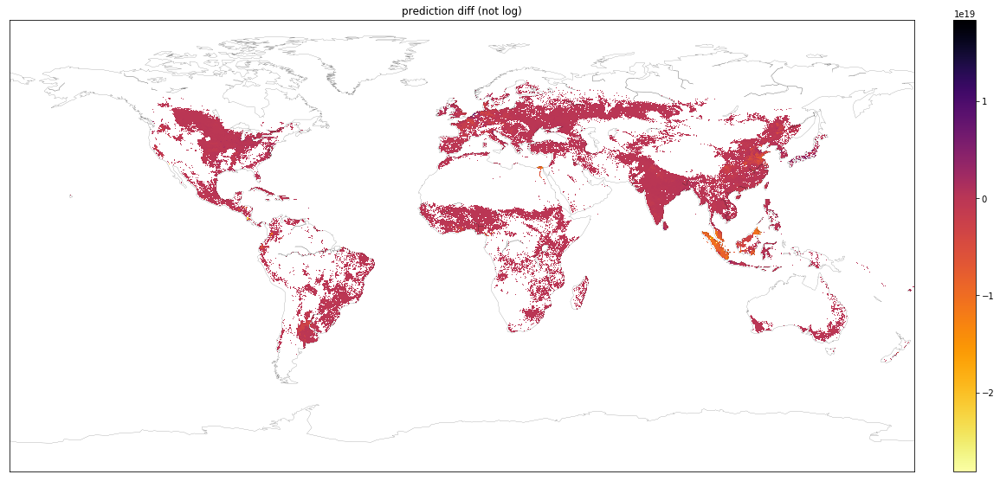

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


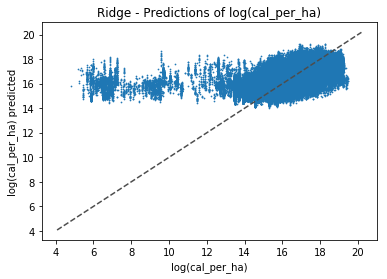

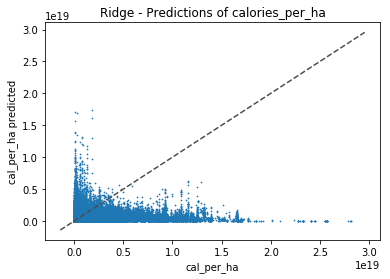

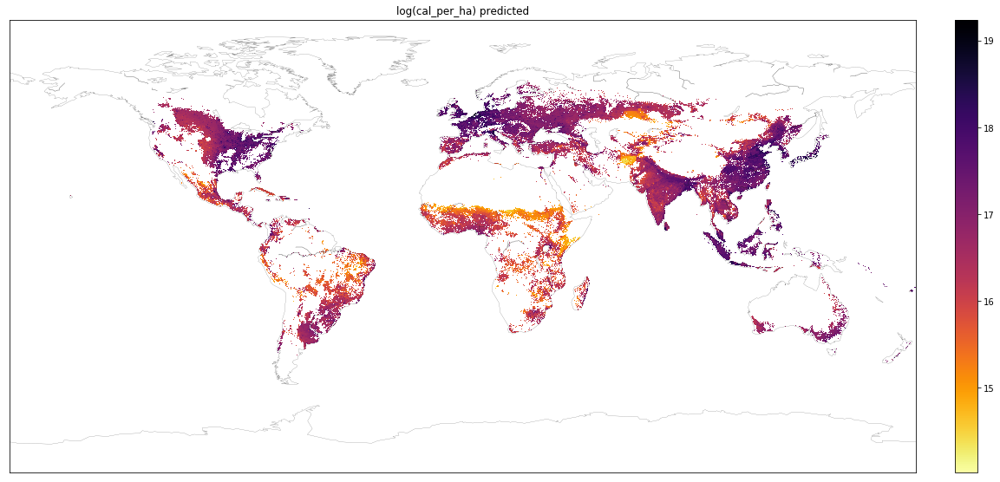

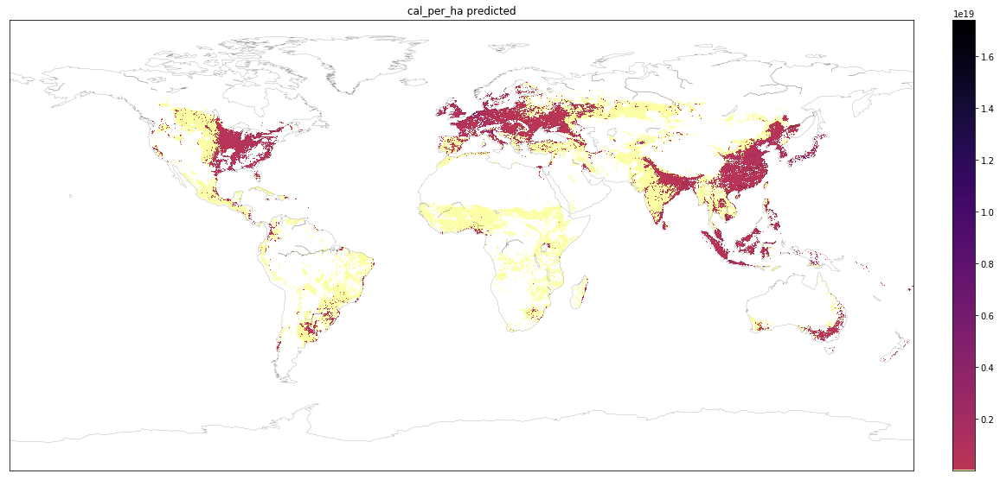

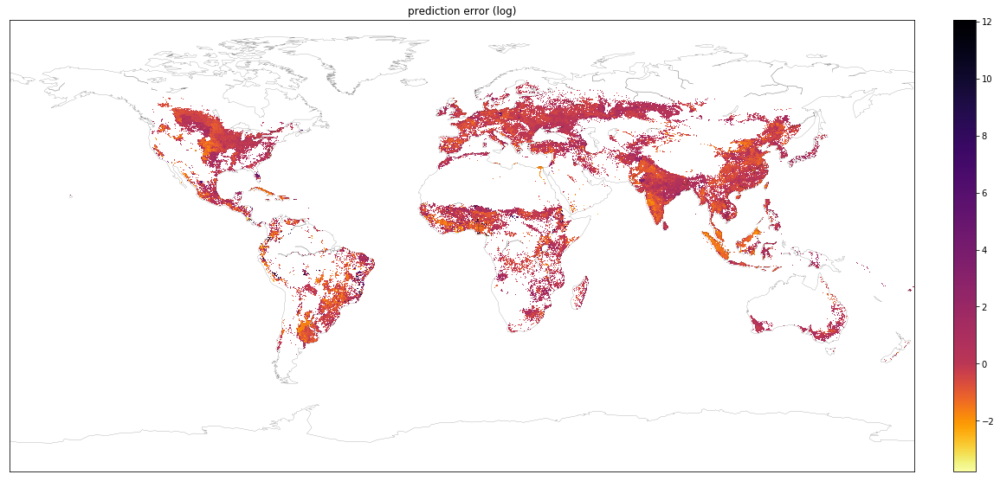

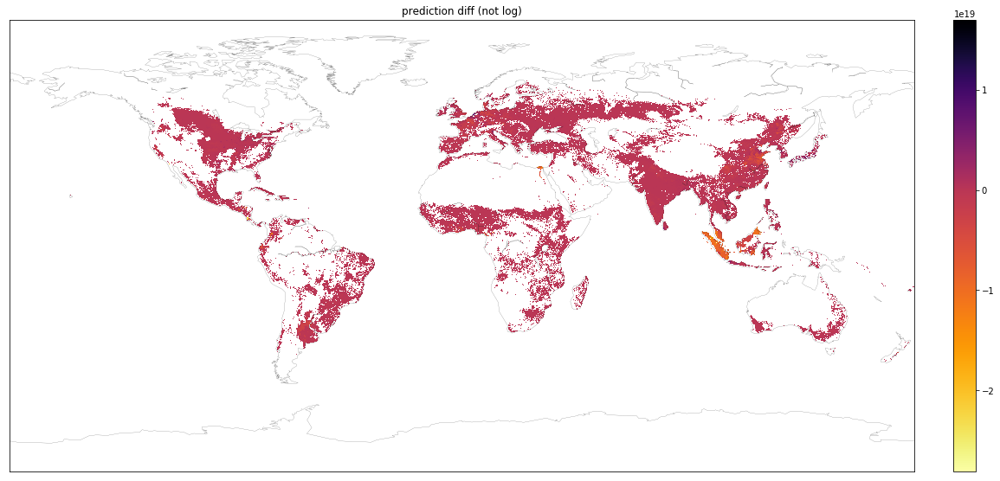

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


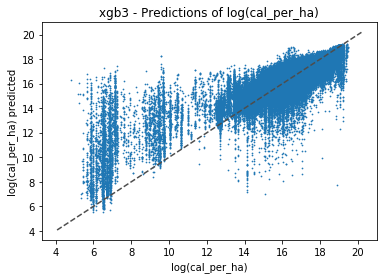

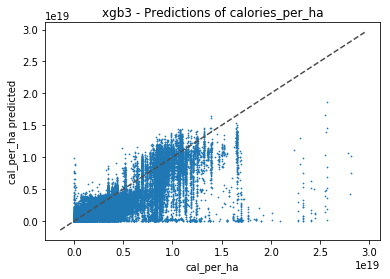

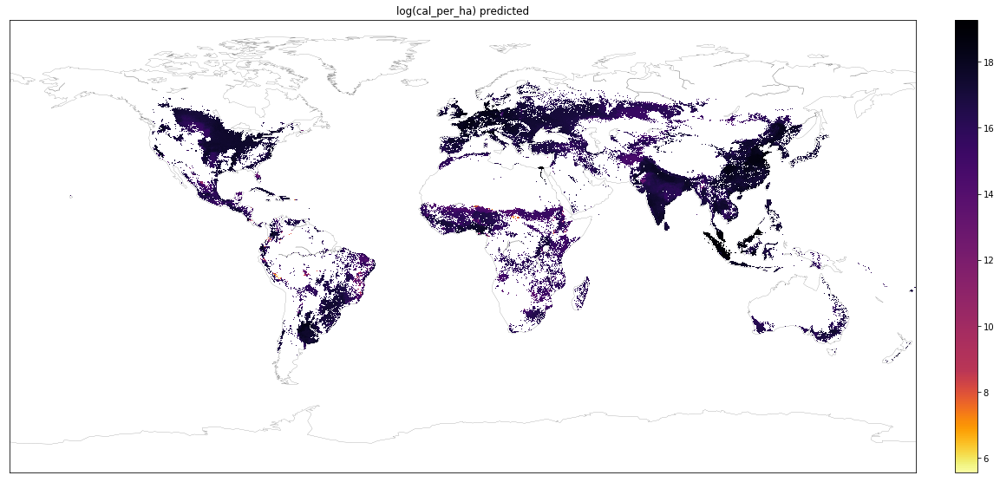

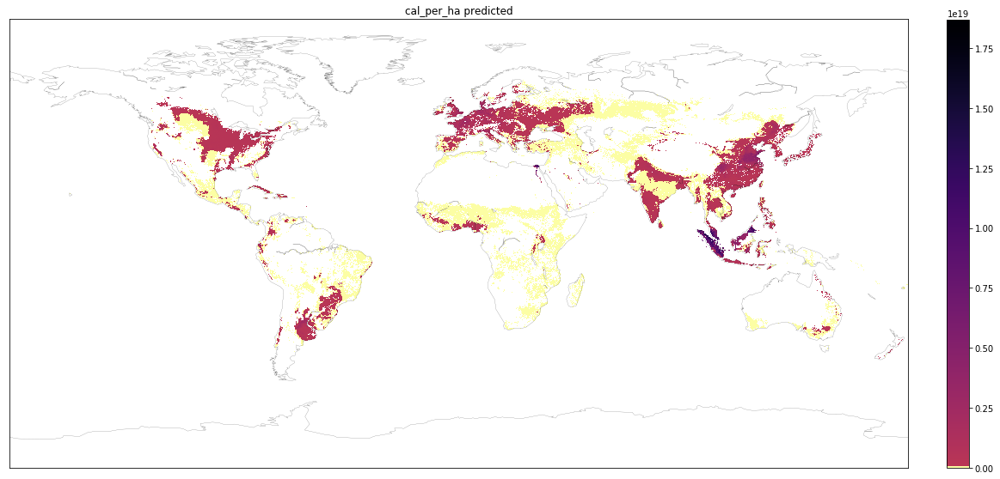

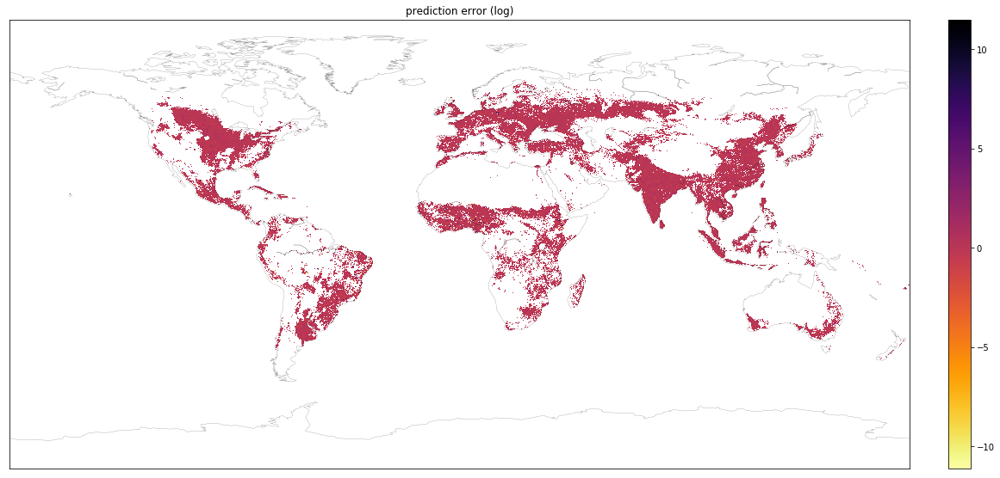

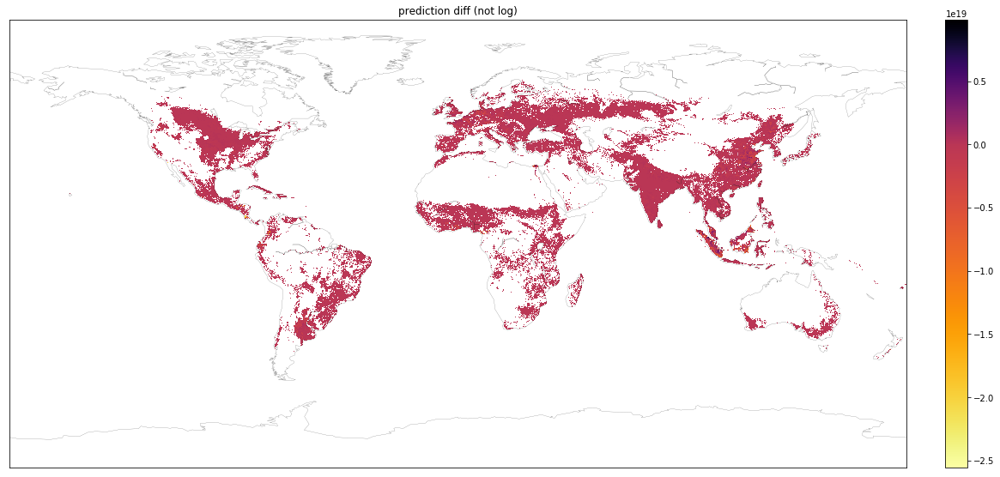

Maps & rasters done


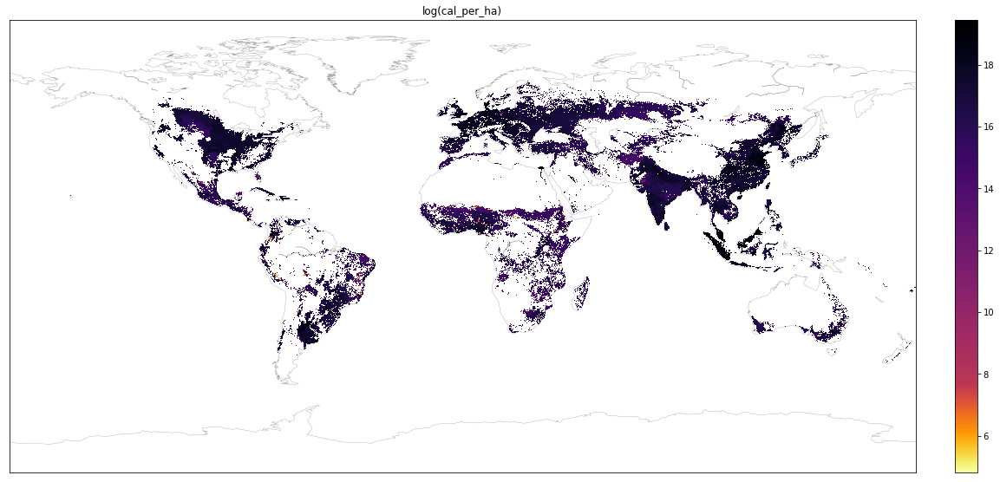

Baseline maps & rasters done


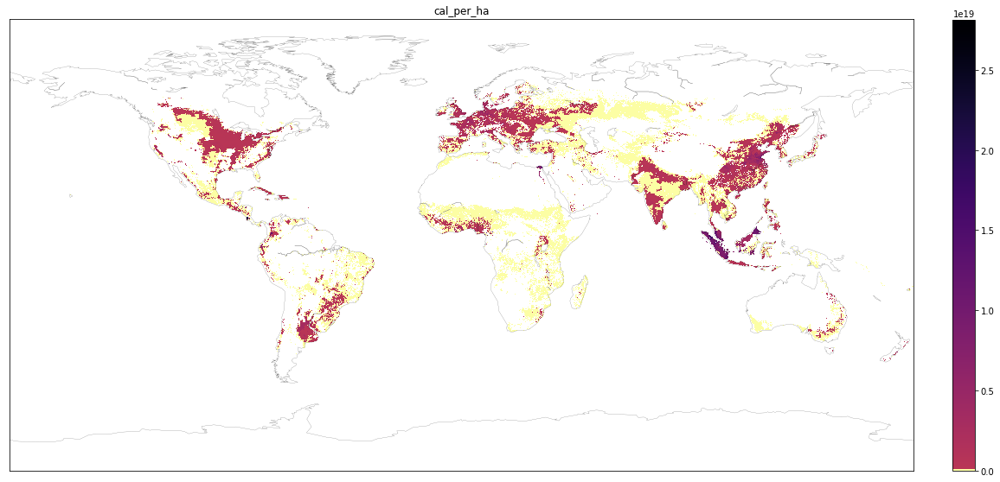

Baseline maps & rasters done


In [92]:
subset = None

for model in ['Linear','Lasso','Ridge','xgb3']: # TO DO Poly
    
    # Load model
    regression = load_regression(model)
    print('\nRegression:')
    print(regression)
    
    # Subset (TODO)
    
    # Apply model
    y_predicted = regression.predict(X)
    compare = predictions_df()
    
    # Save scatterplots
    ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title=(str(model)+' - Predictions of log(cal_per_ha)'));
    ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
    plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log---'+str(model)+'.png')
    
    
    ax = compare.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title=(str(model)+' - Predictions of calories_per_ha'));
    ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
    plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted---'+str(model)+'.png')
    print('Scatterplots done')
    
    # Save maps+raster (rasters TO DO fct export_raster)    
    for column in ['log(cal_per_ha) predicted','cal_per_ha predicted',
                  'prediction error (log)','prediction diff (not log)']:
        visualize_data(compare,column,colorscheme='sequential',
                   savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'--'+model+'.png')
    
    
        export_raster(compare,column,
                 savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'--'+model+'.png')
    print('Maps & rasters done')
    
for column in ['log(cal_per_ha)','cal_per_ha']:       
    visualize_data(compare,column,colorscheme='sequential',
                   savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'.png')
    
    export_raster(compare,column,
                  savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'.png')
    print('Baseline maps & rasters done')
    

## Loop - With subsetting options * baseline_df

In [101]:
simple_subset = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'log_gpw_population',
                  'temp_avg','precip',
                  'calories_per_ha']

simple_subset_gdp = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'gdp','log_gdp_per_capita','log_gpw_population',
                  'temp_avg','precip',
                  'calories_per_ha']

columns_without_climatezones = baseline_df.columns
for col in baseline_df.columns:
    if "climatezone" in col: 
        columns_without_climatezones = columns_without_climatezones.drop([col])


Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


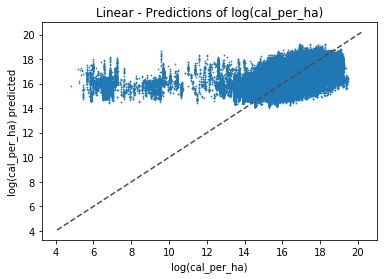

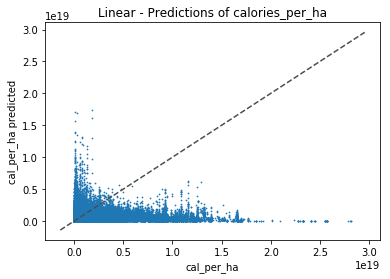

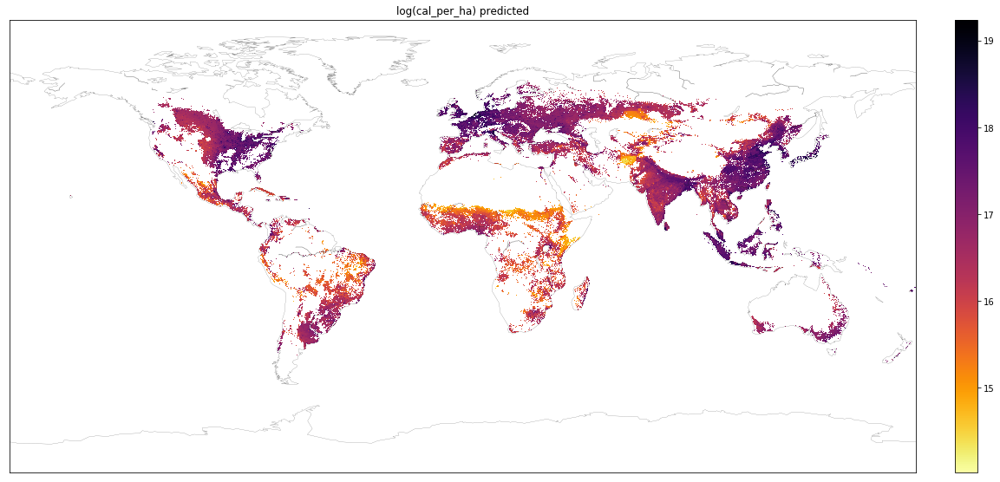

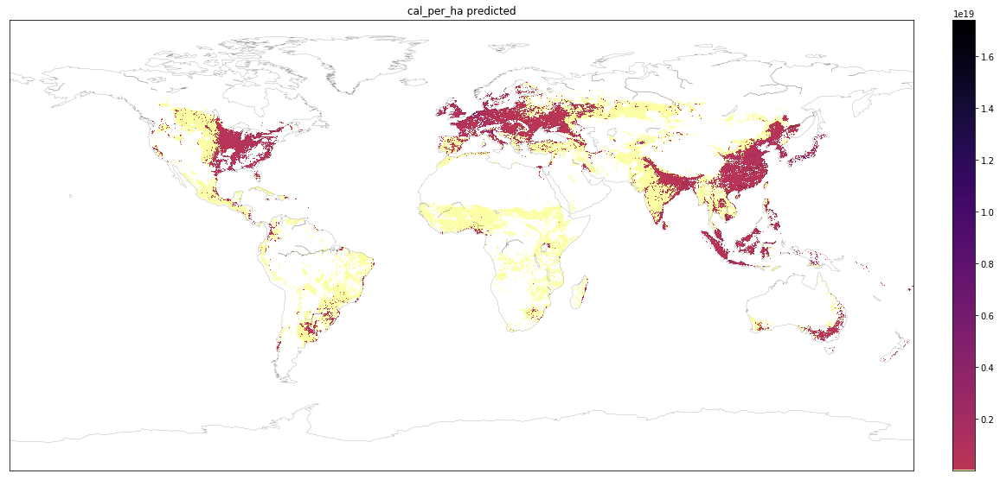

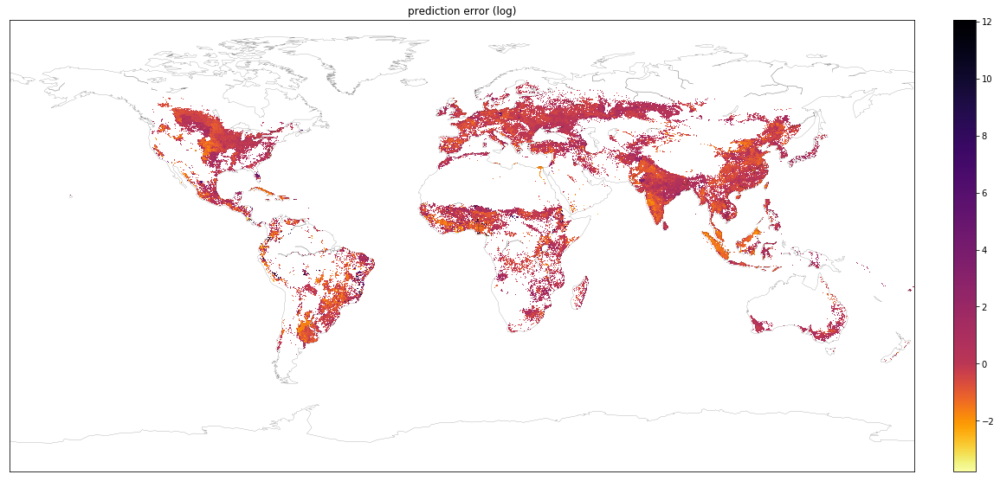

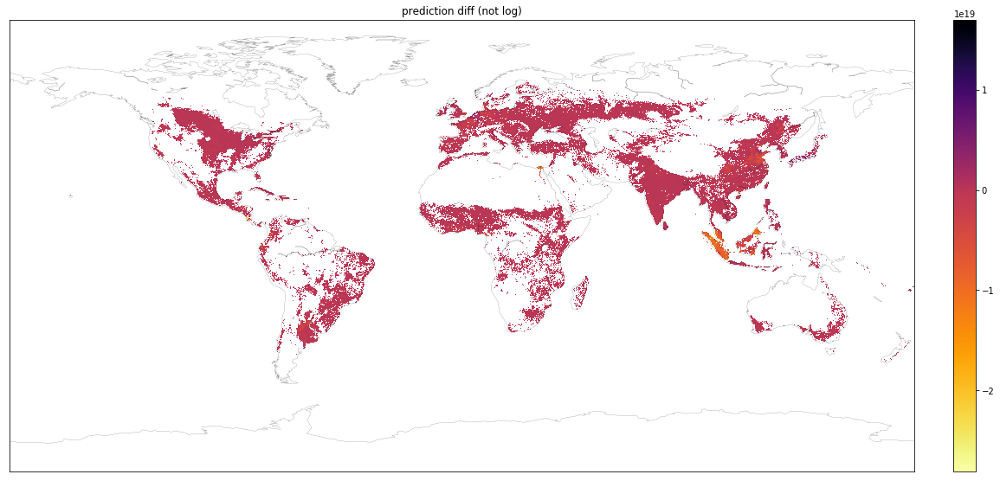

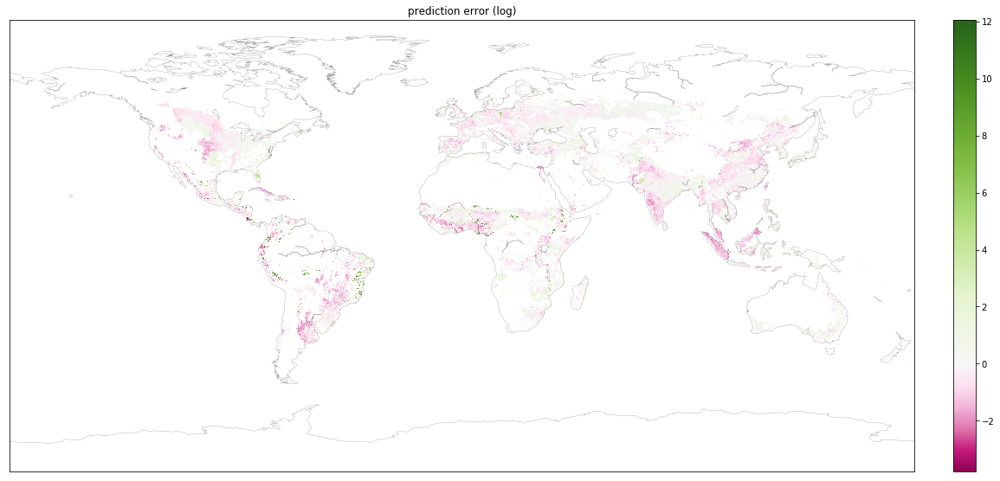

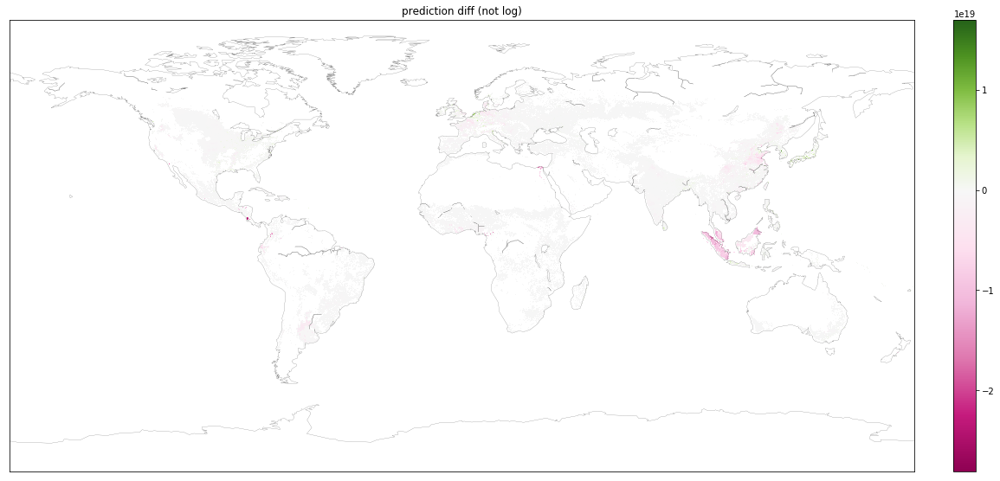

Maps & rasters done

Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


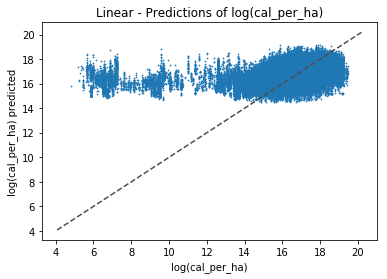

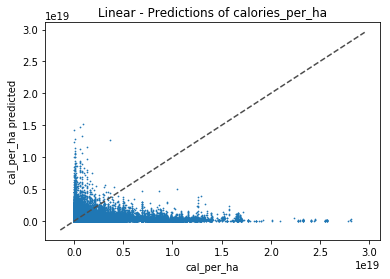

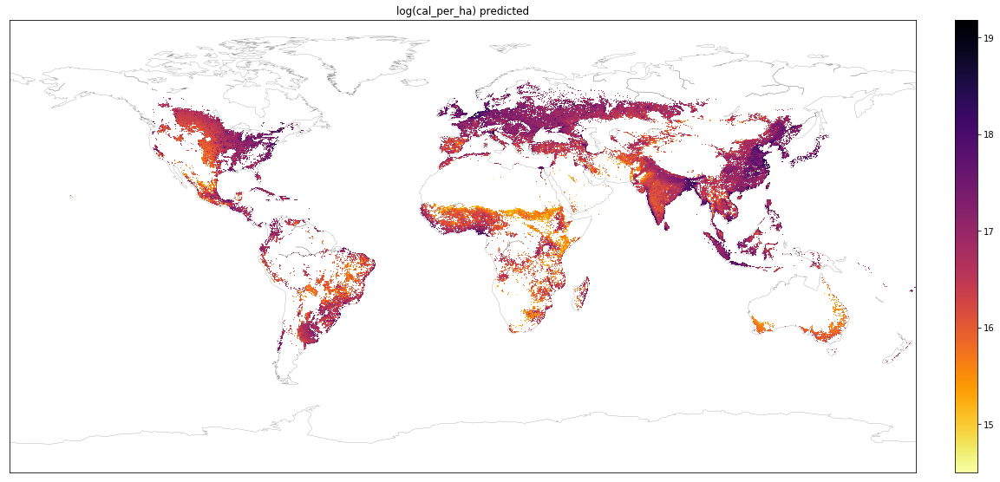

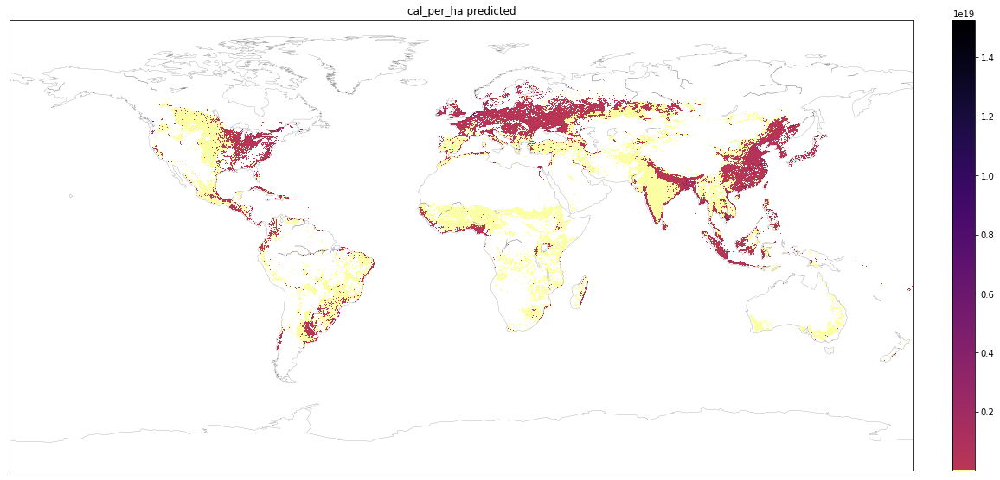

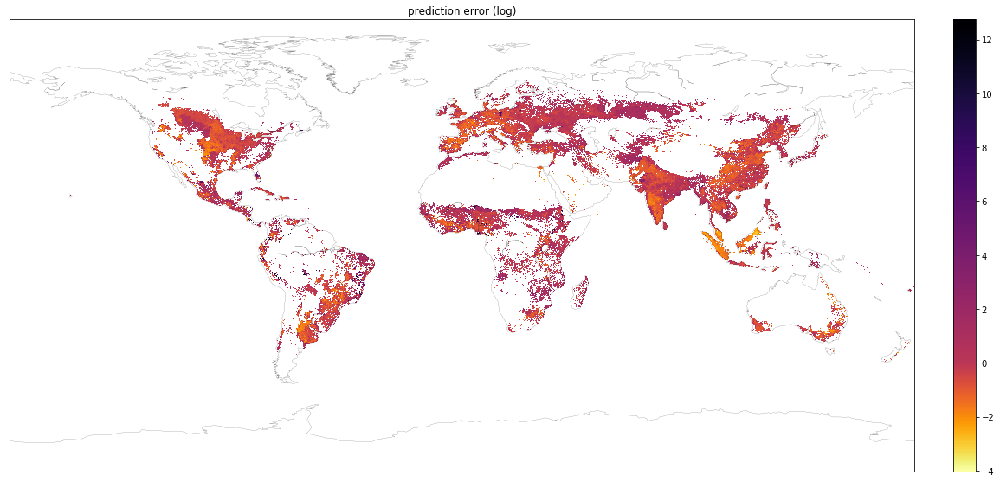

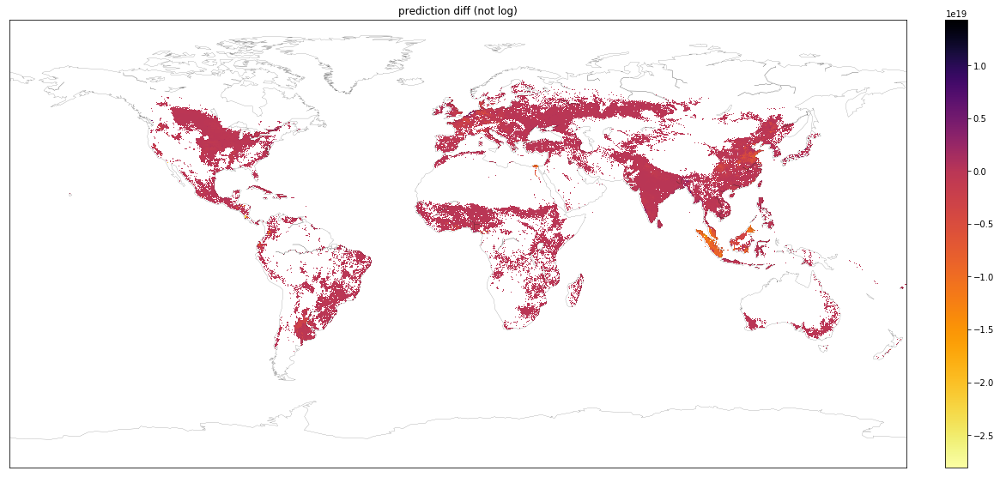

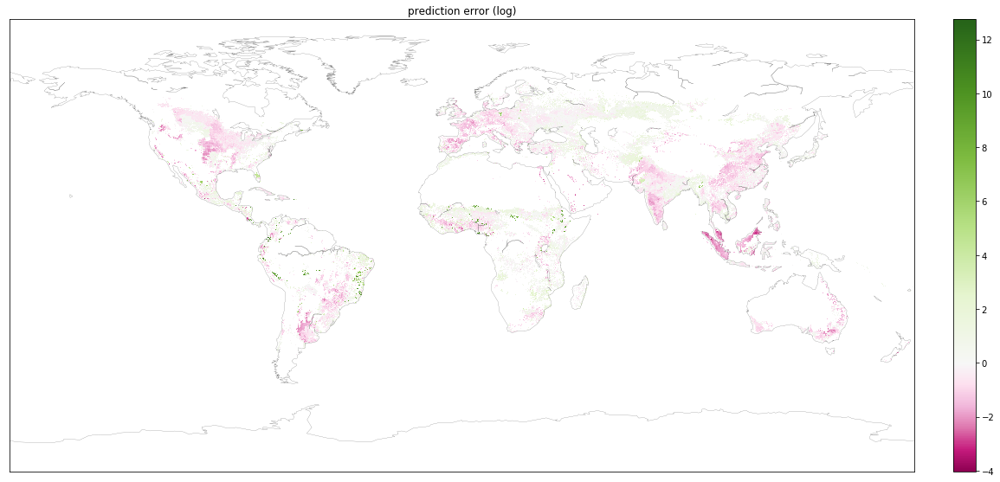

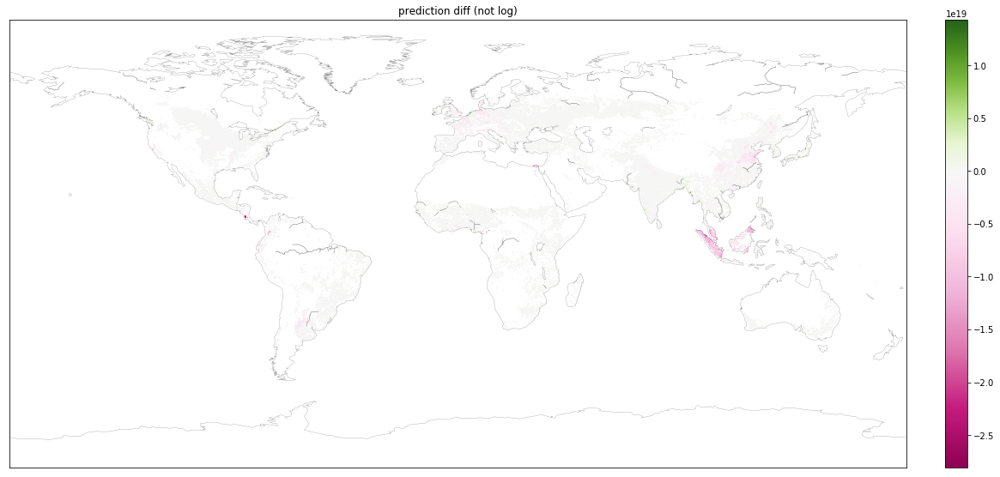

Maps & rasters done

Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


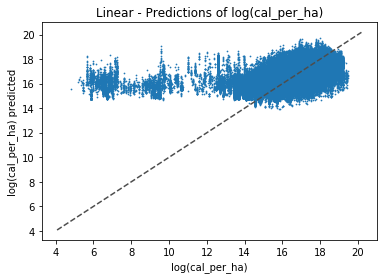

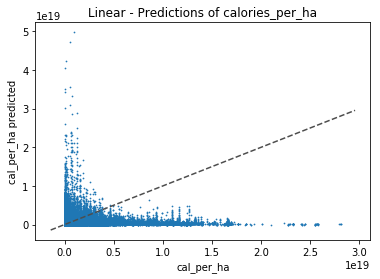

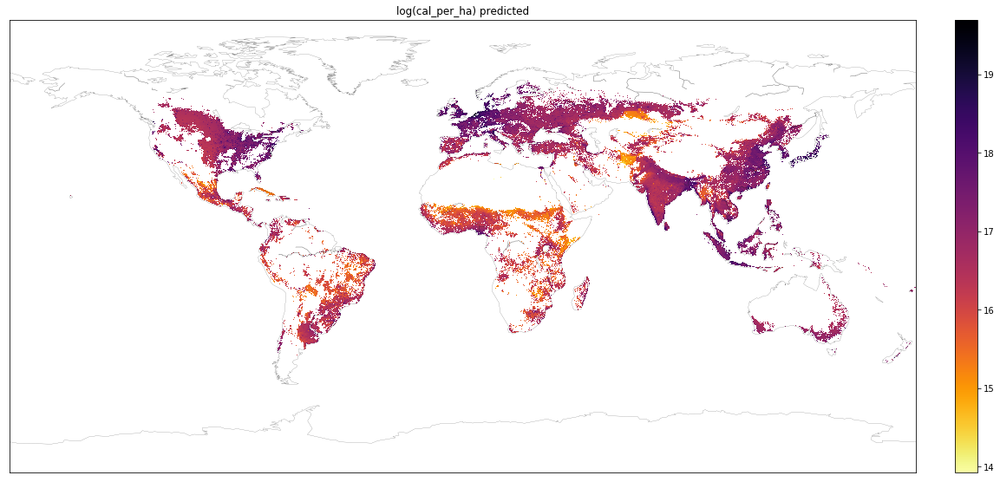

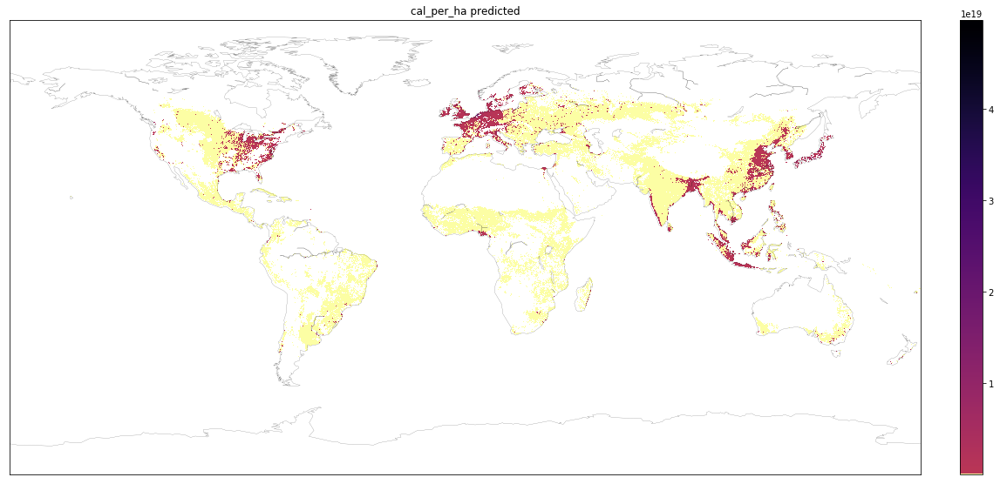

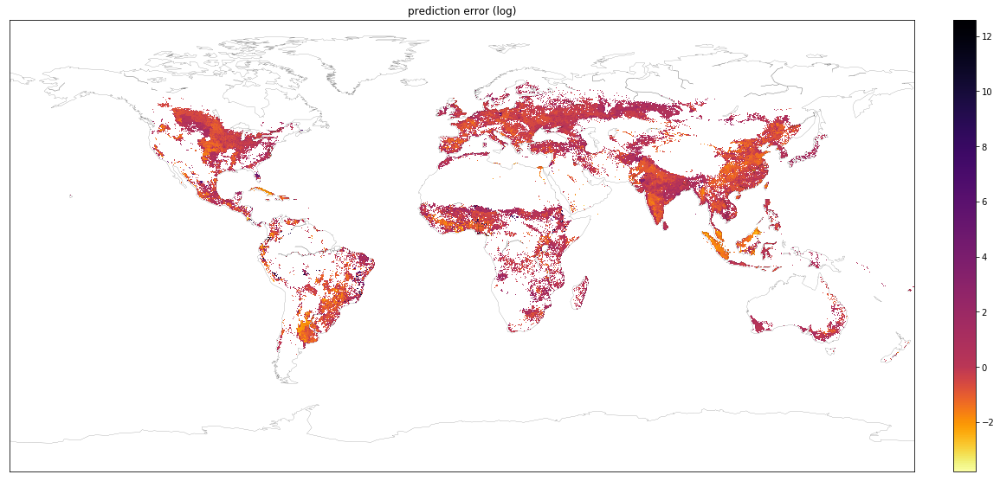

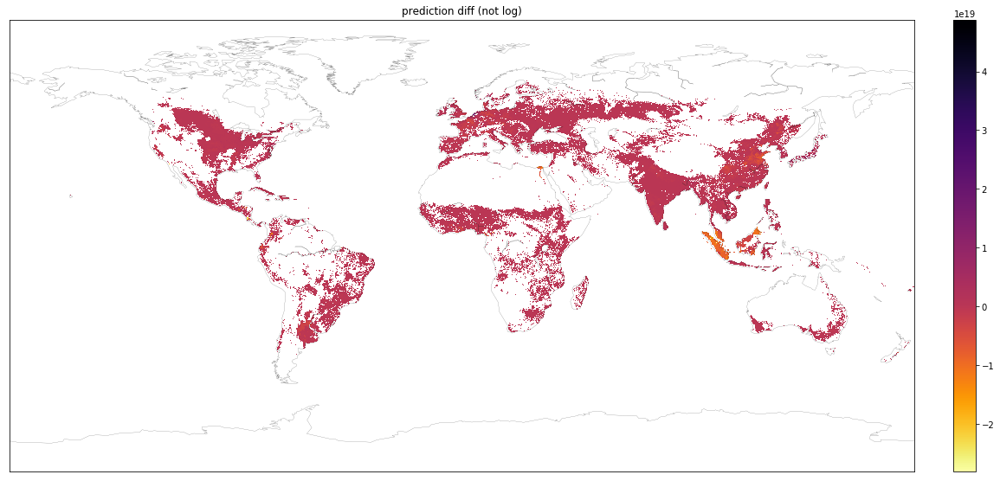

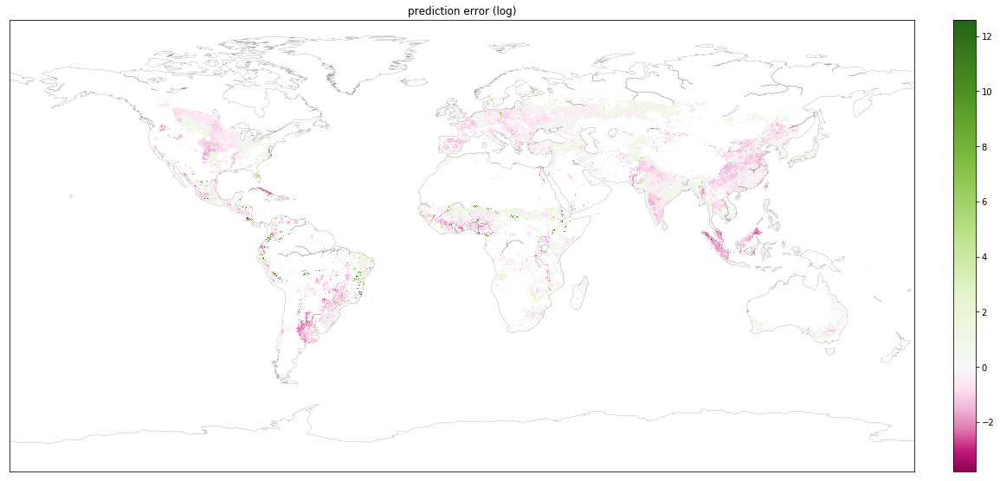

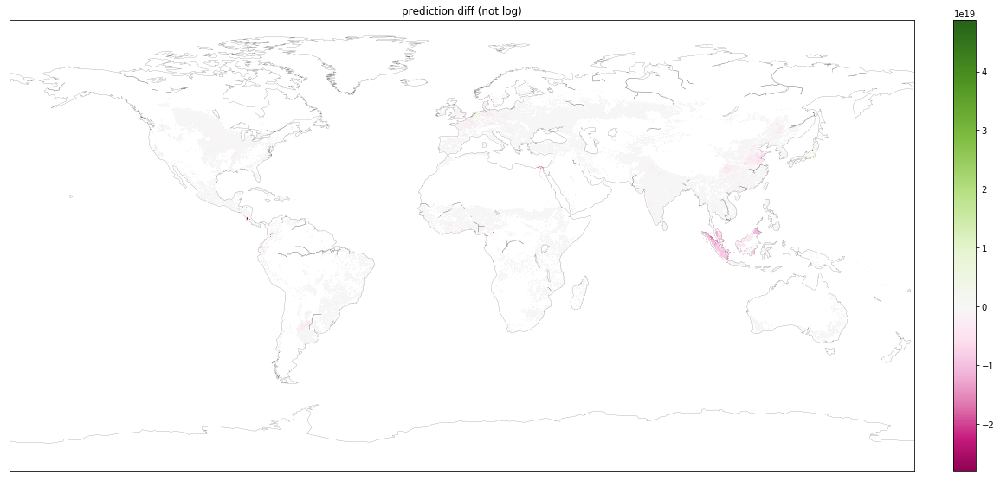

Maps & rasters done

Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


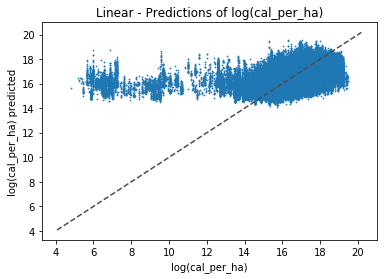

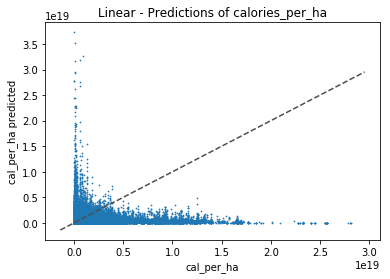

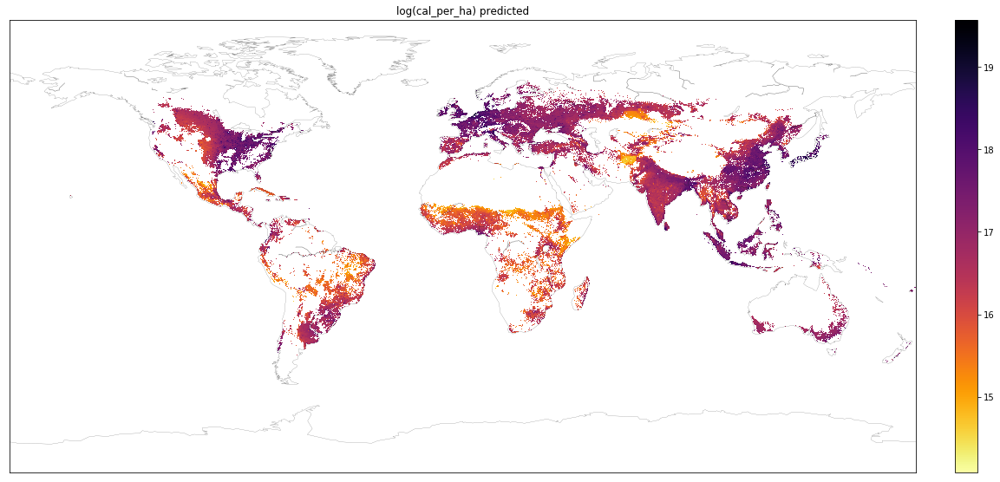

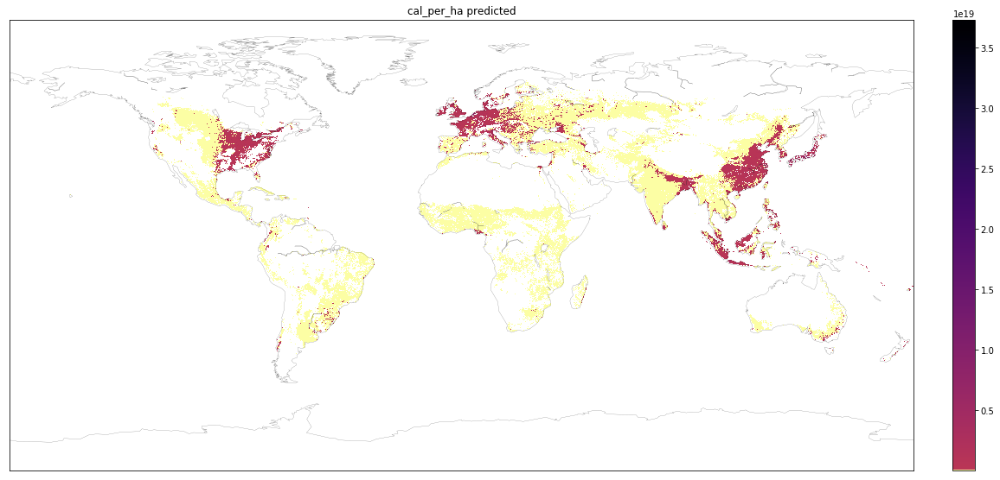

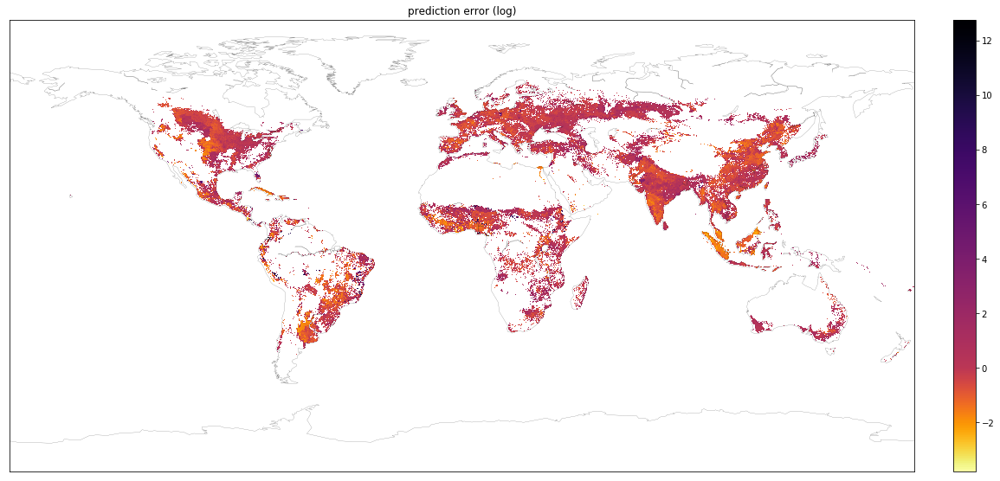

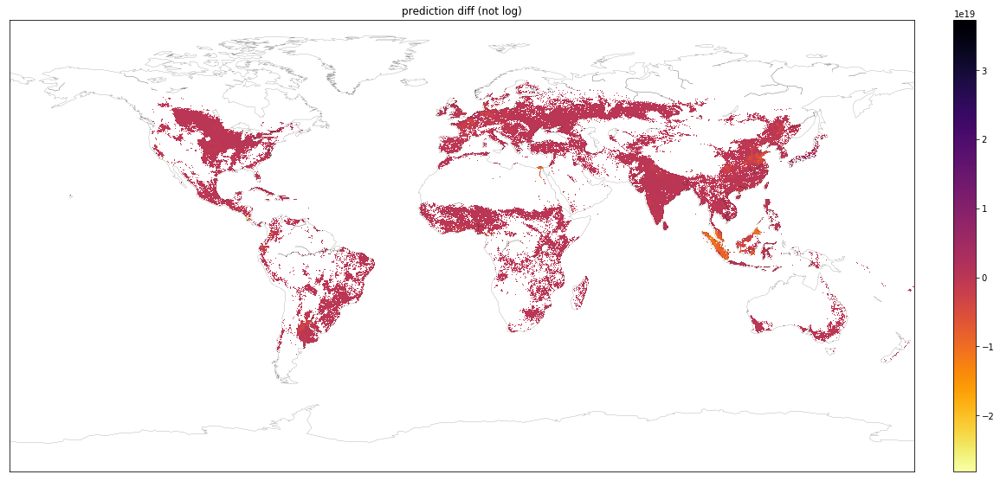

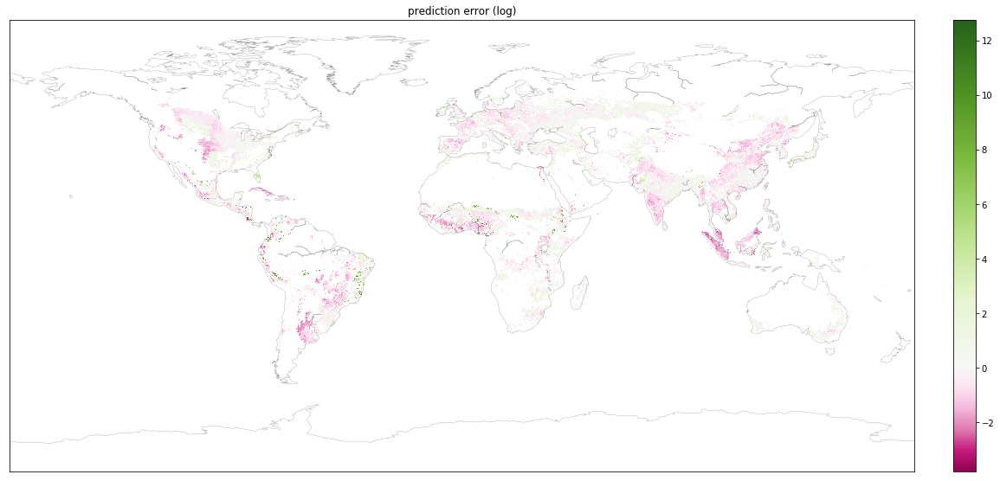

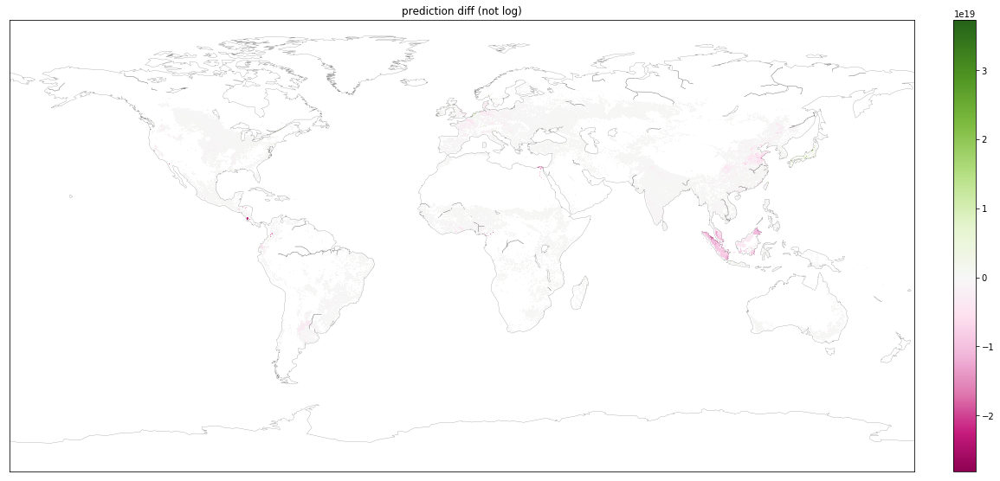

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


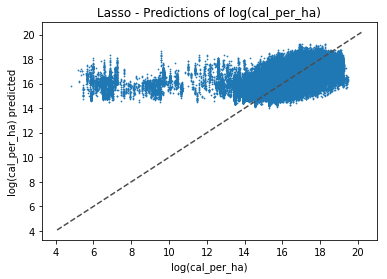

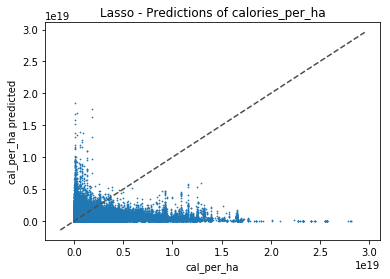

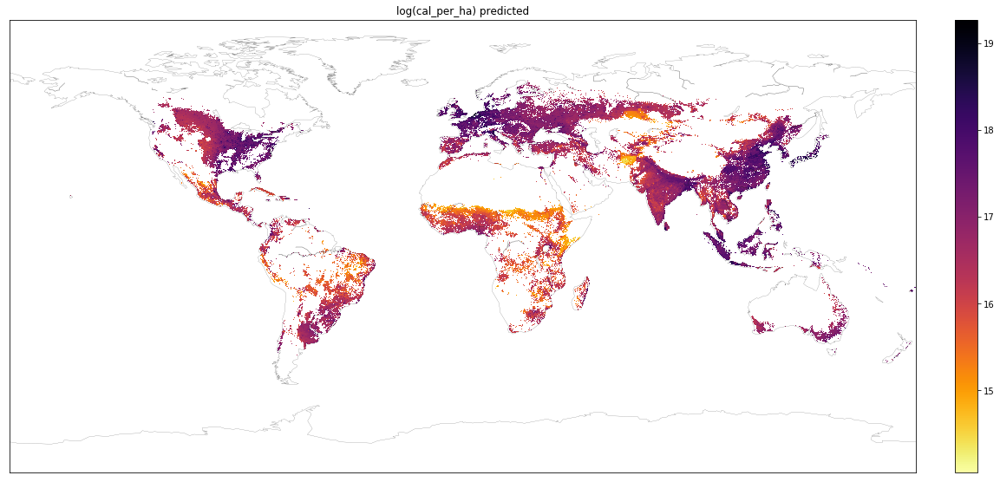

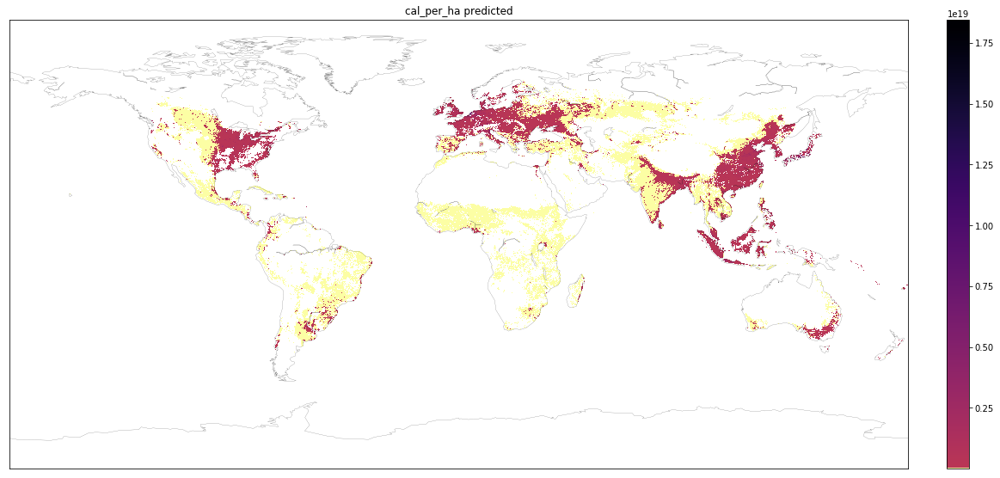

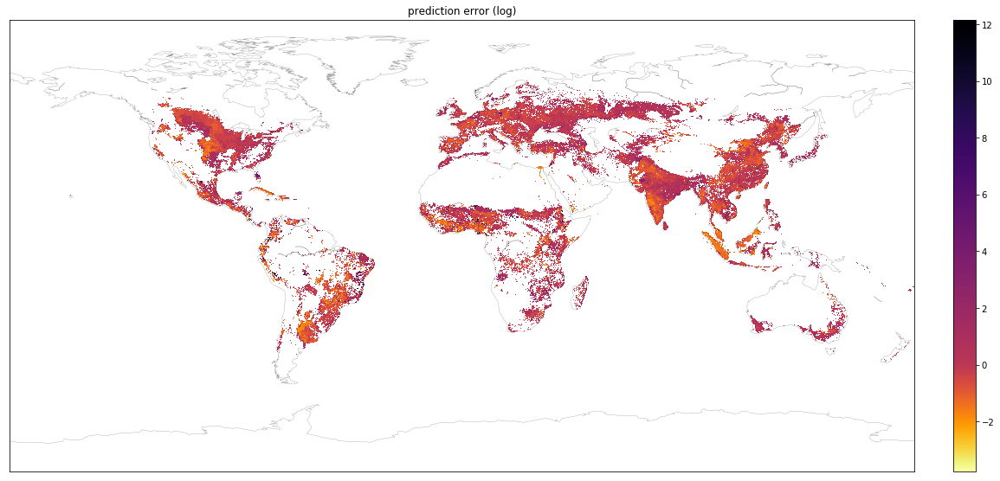

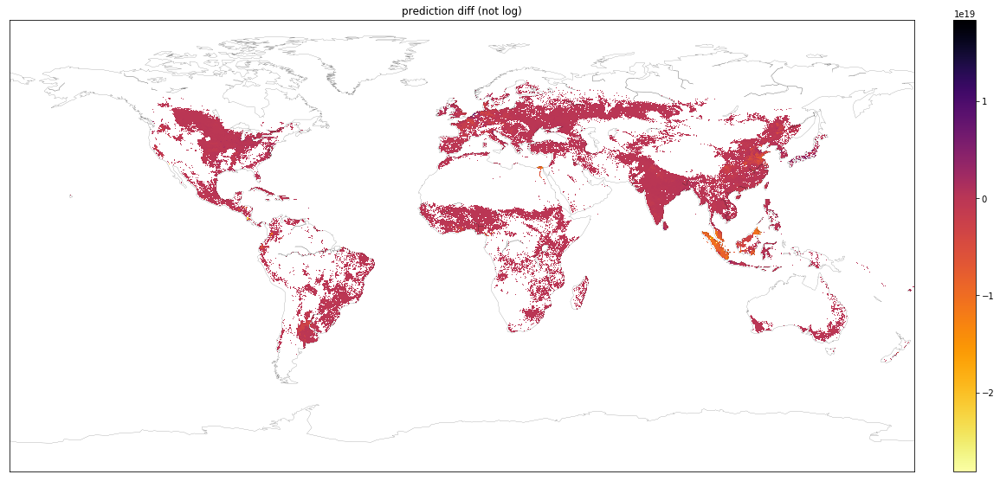

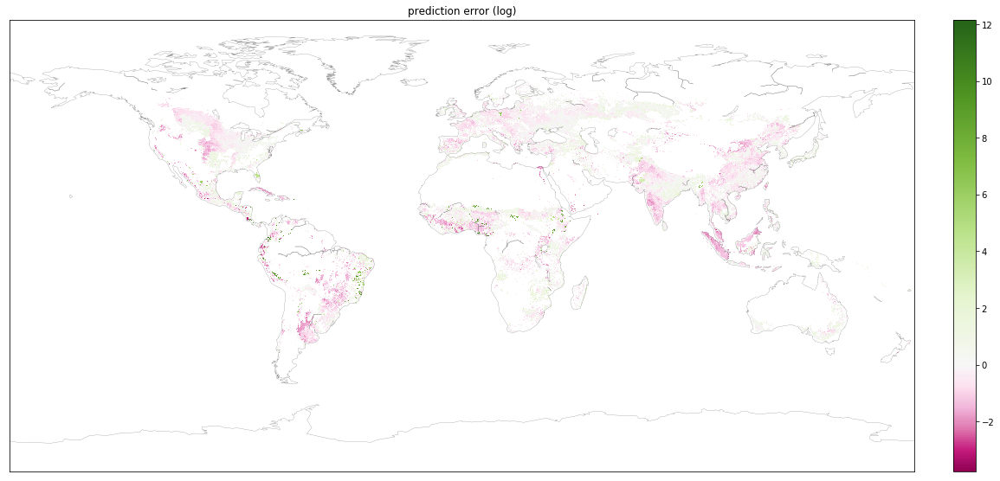

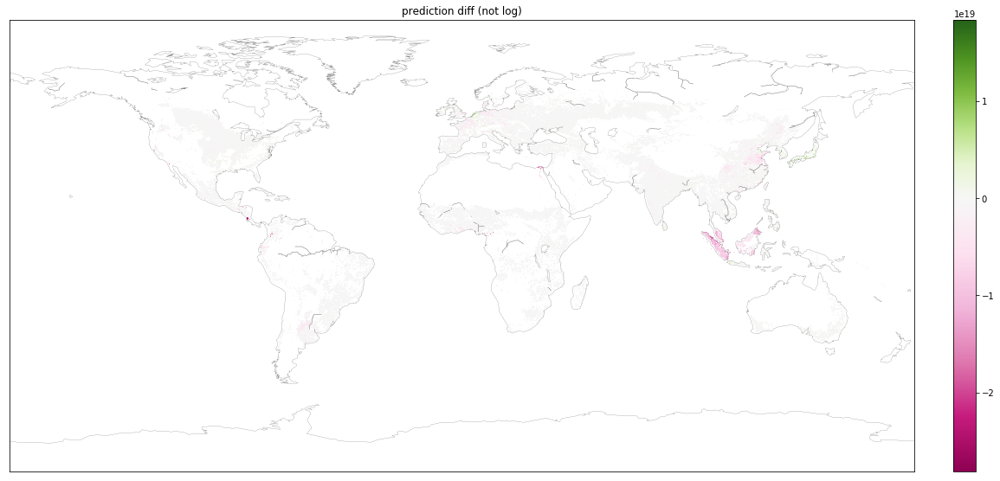

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


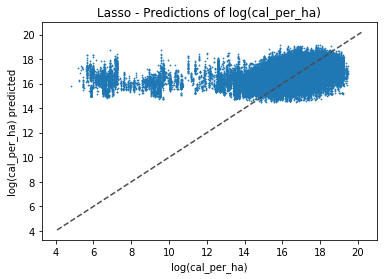

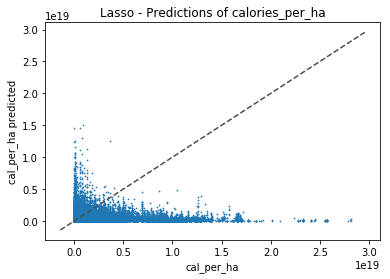

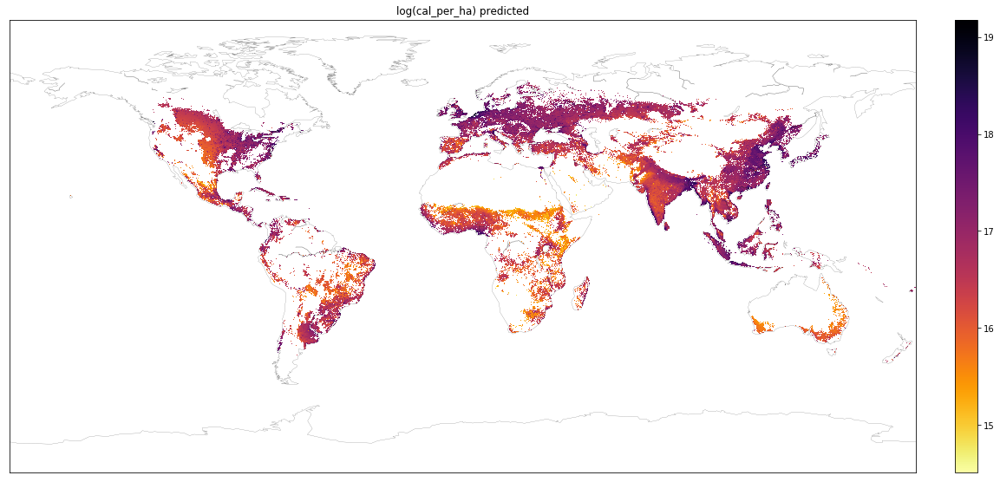

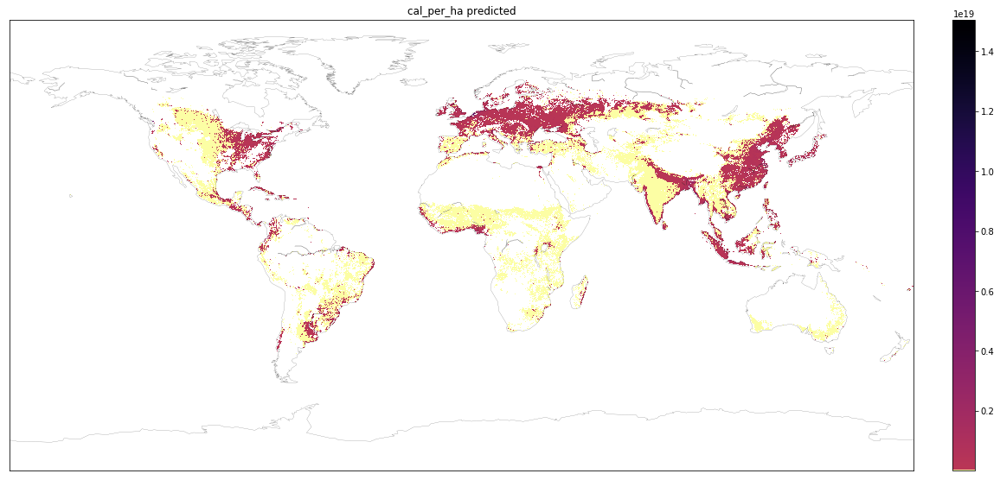

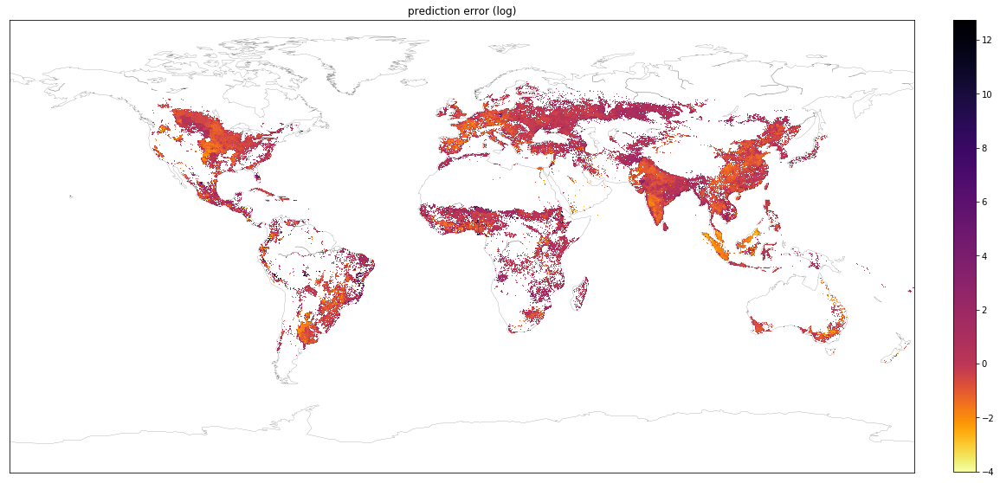

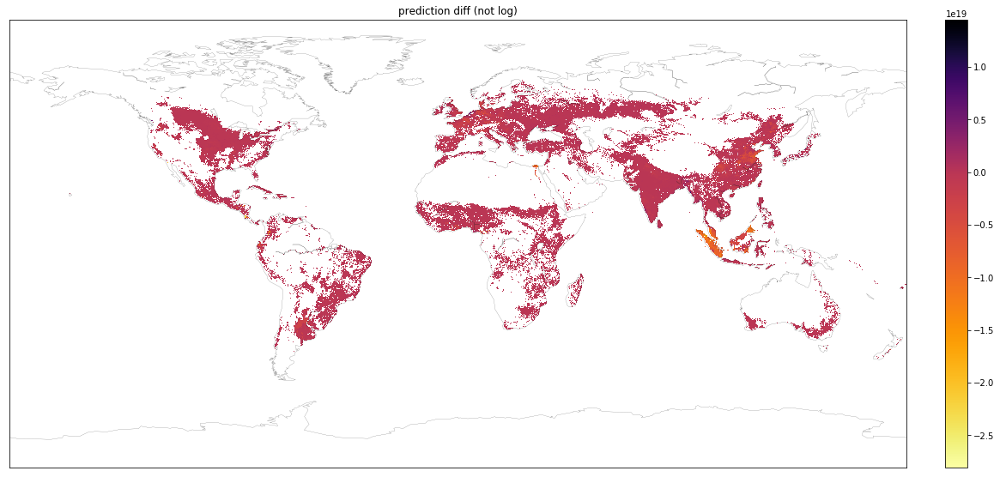

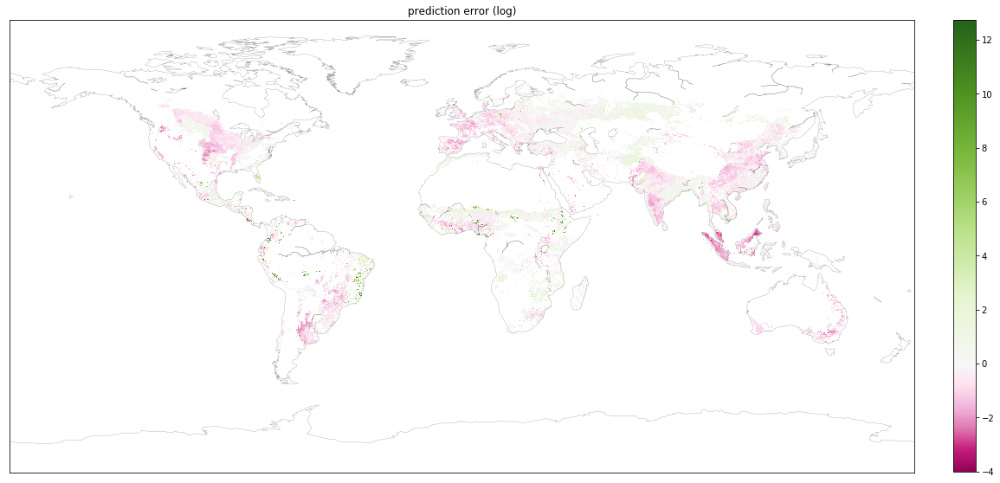

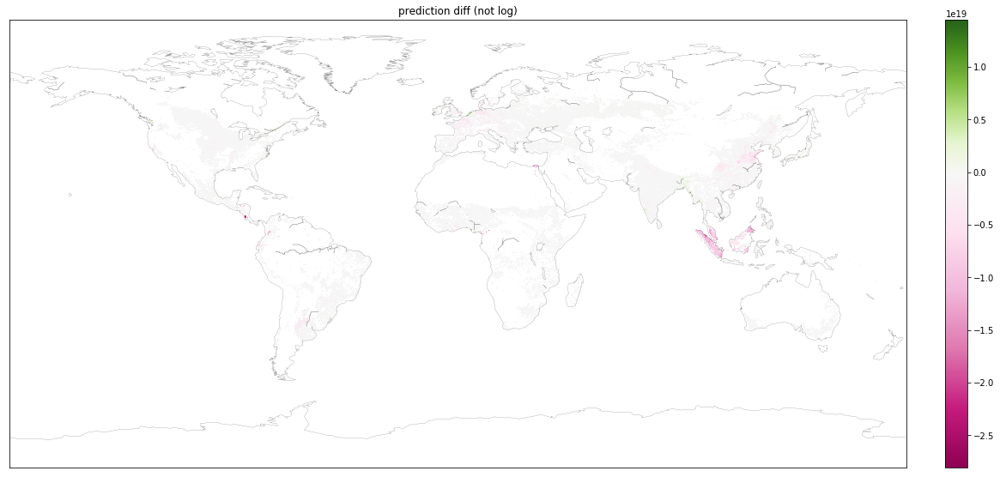

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


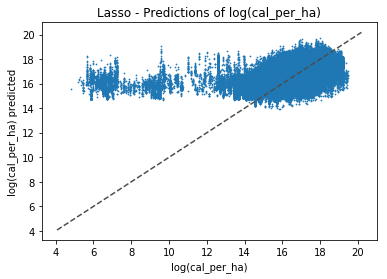

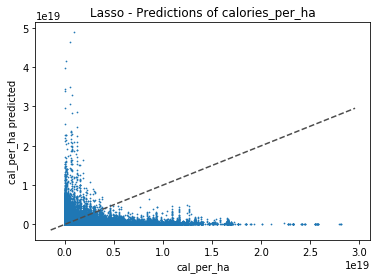

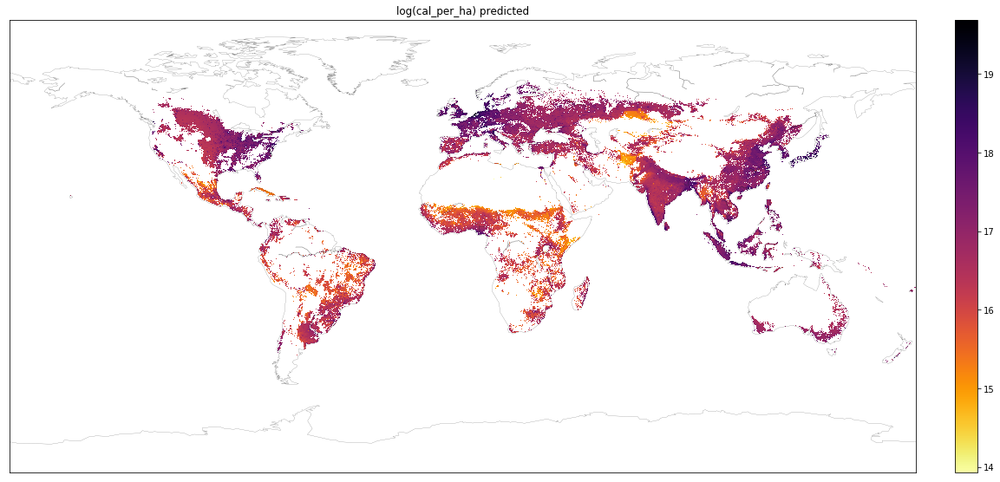

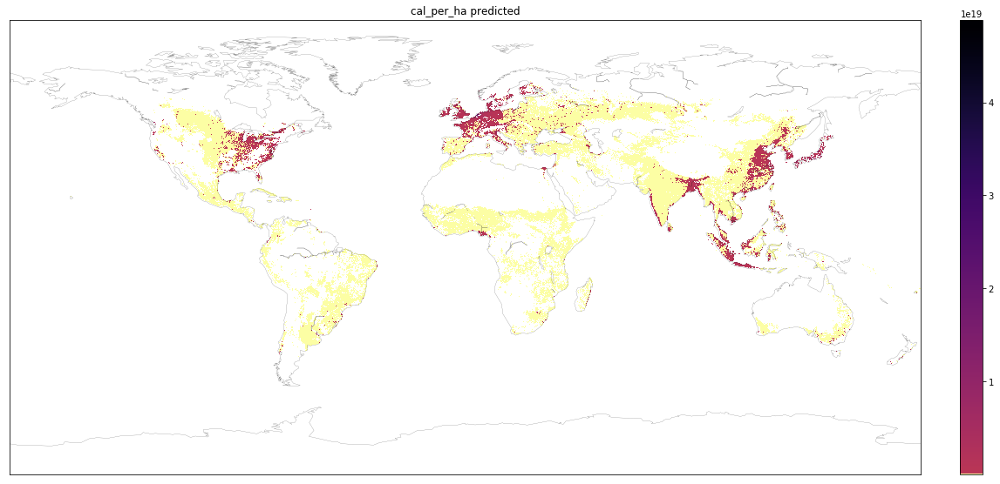

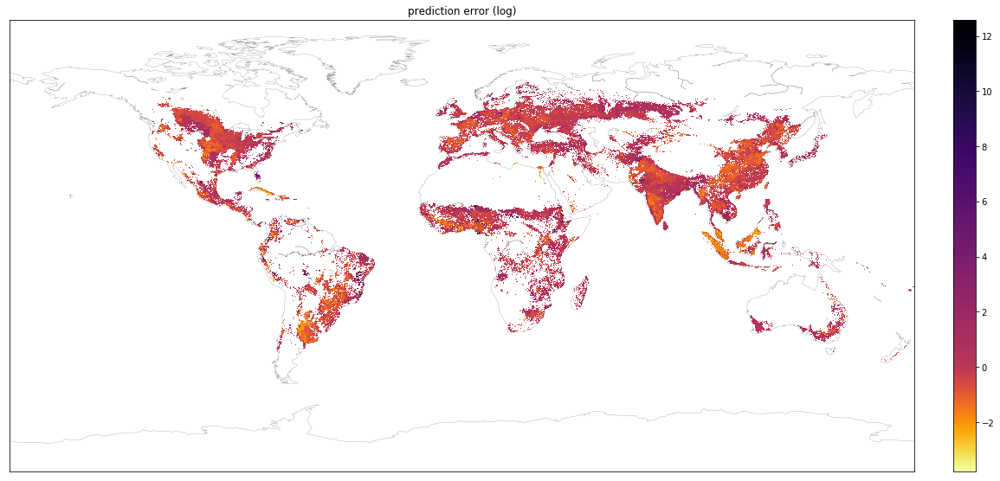

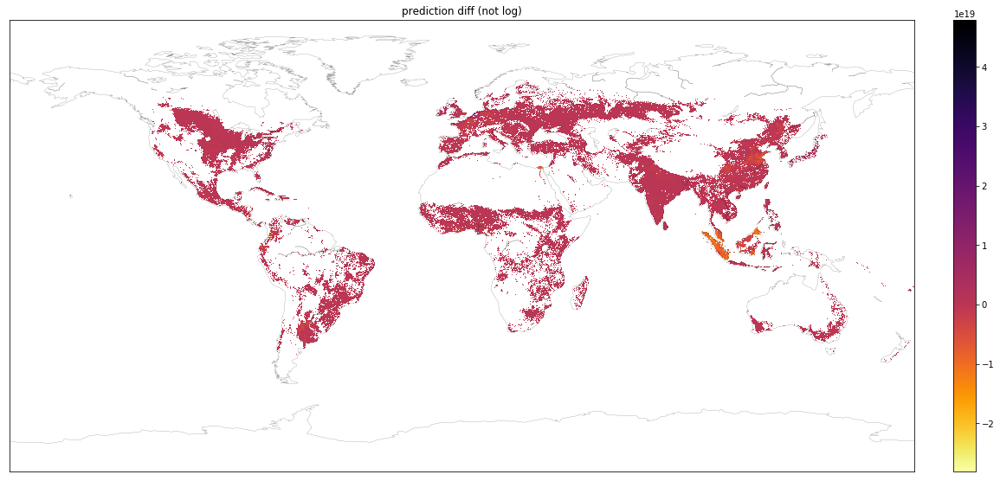

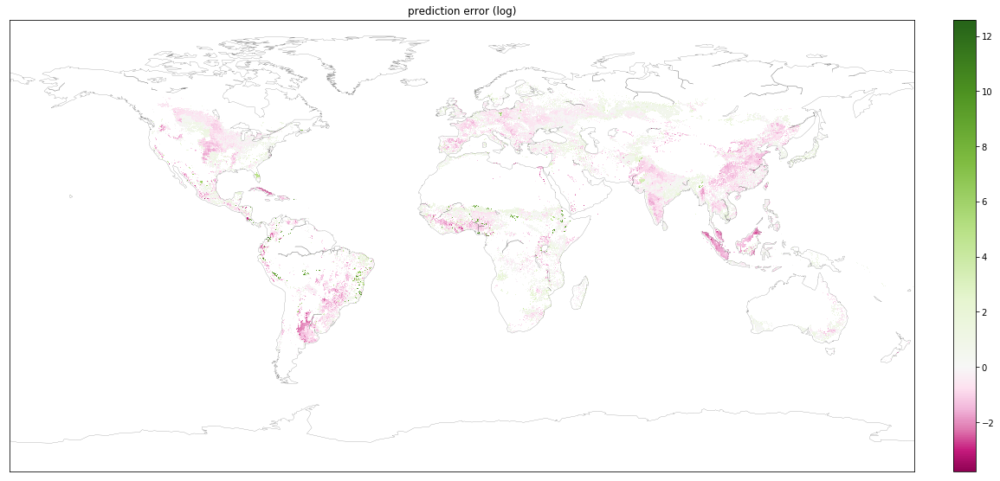

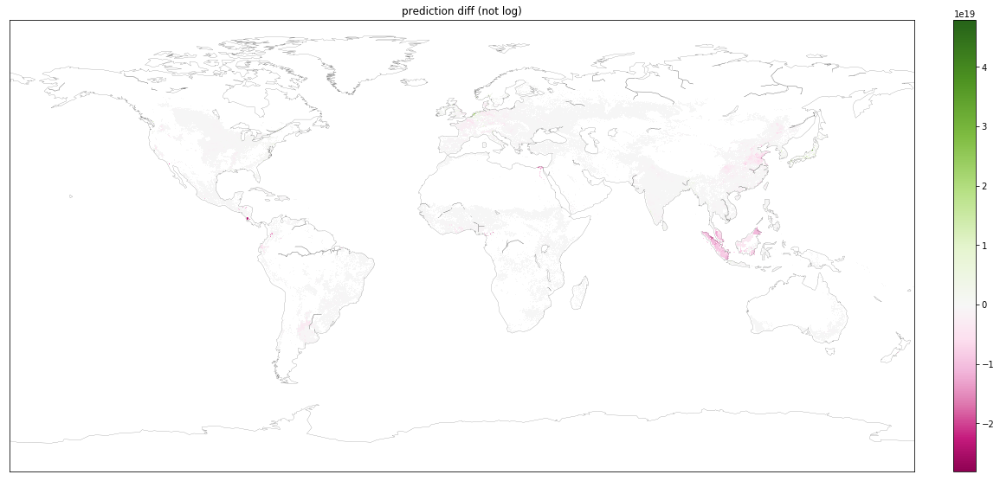

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


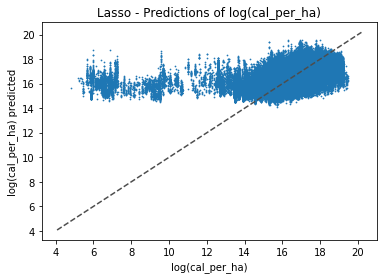

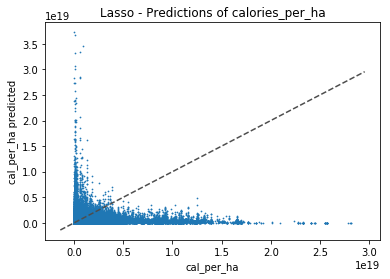

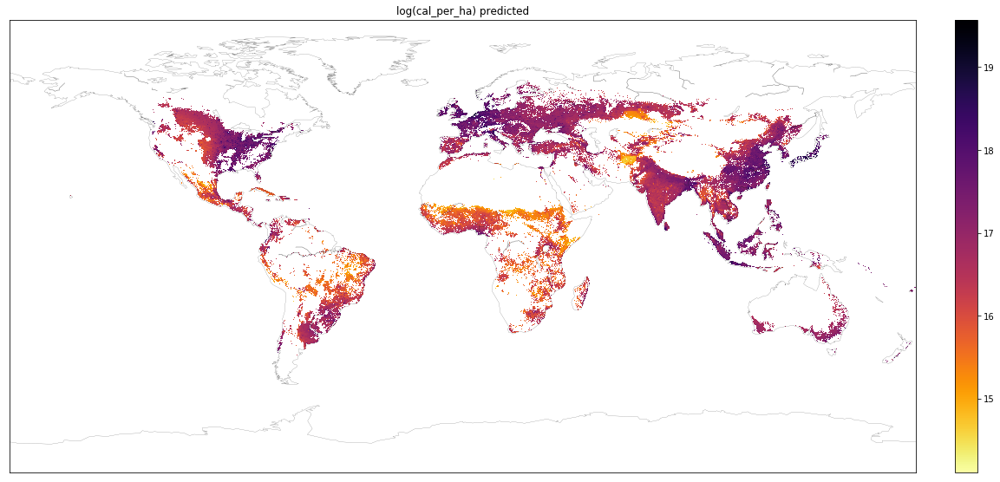

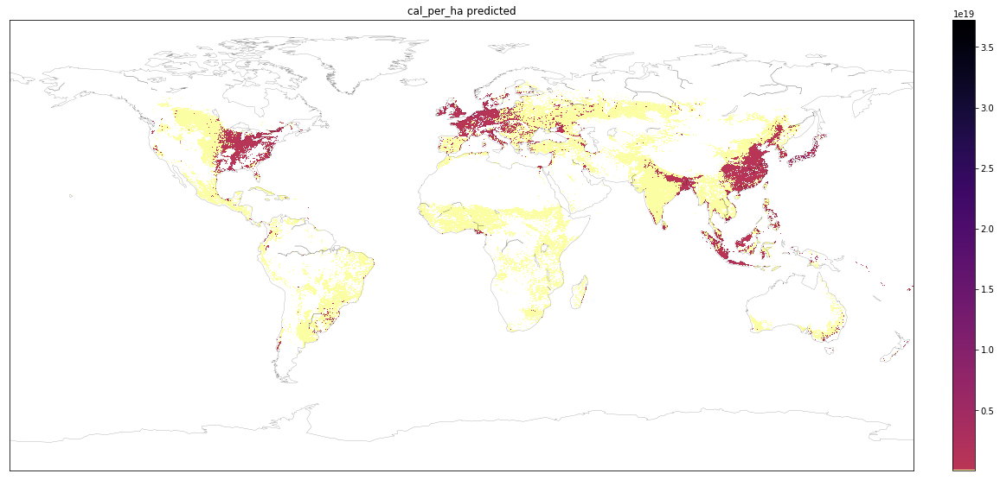

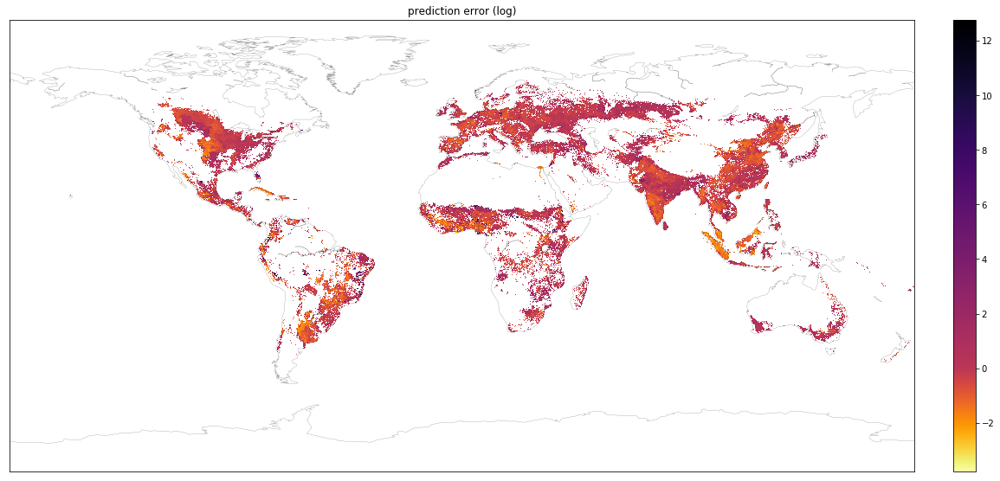

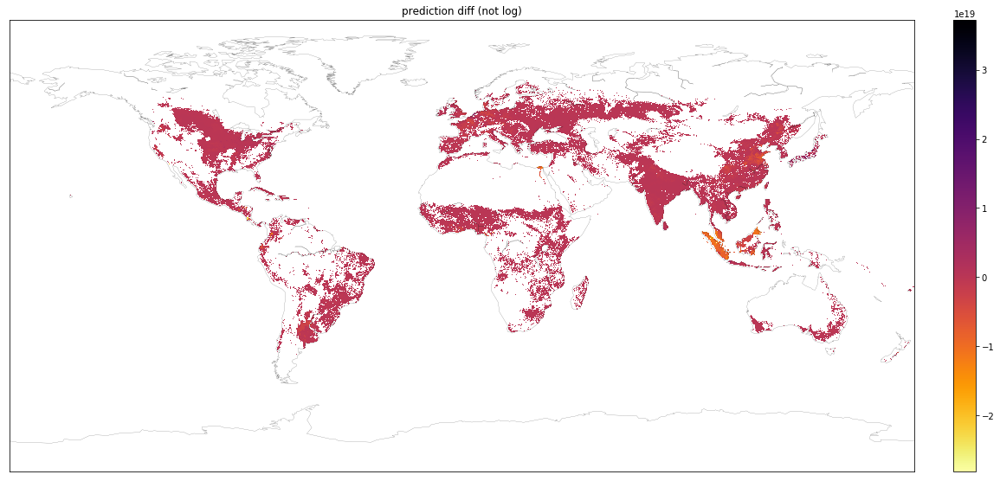

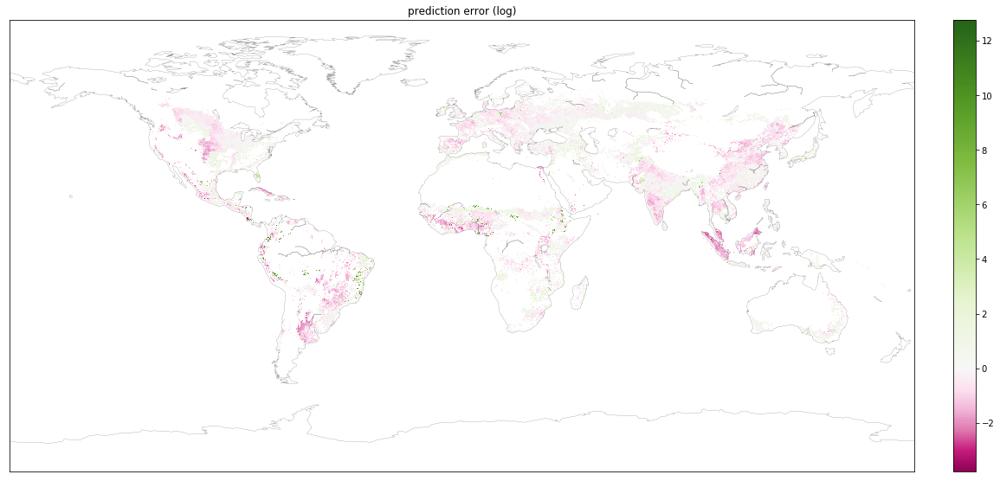

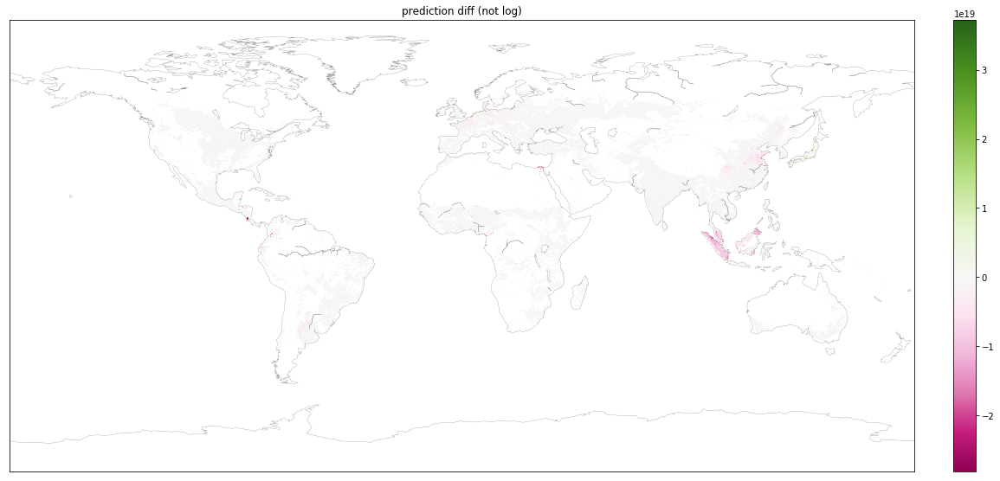

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


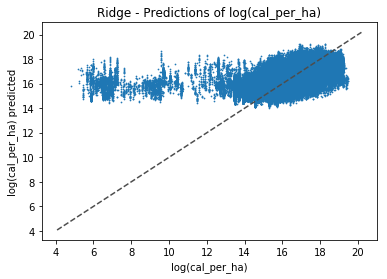

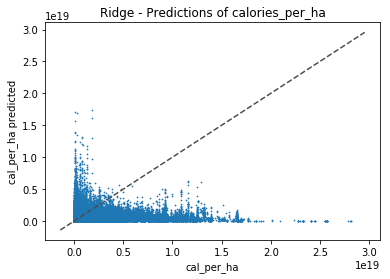

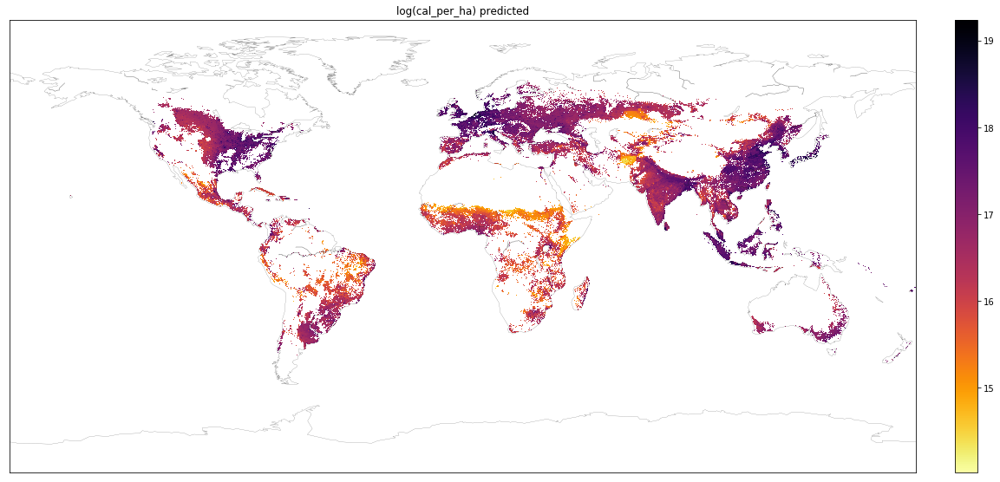

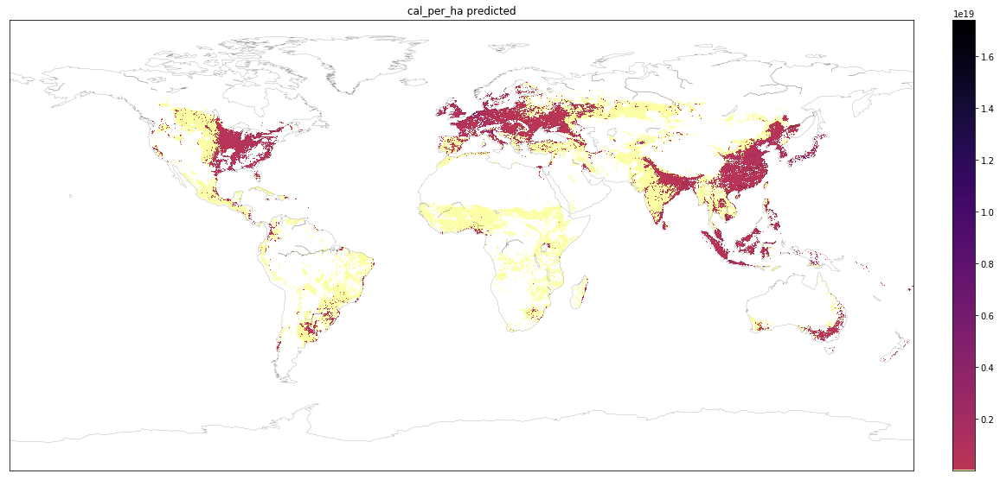

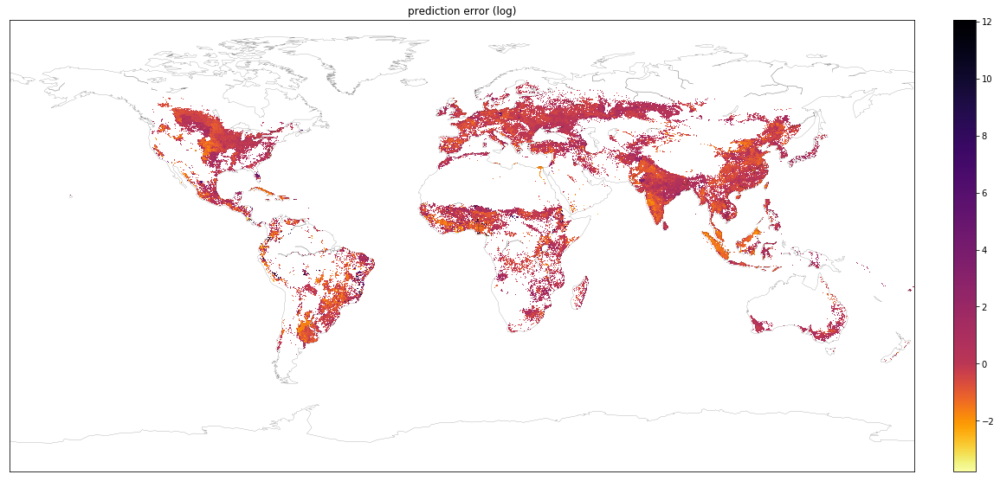

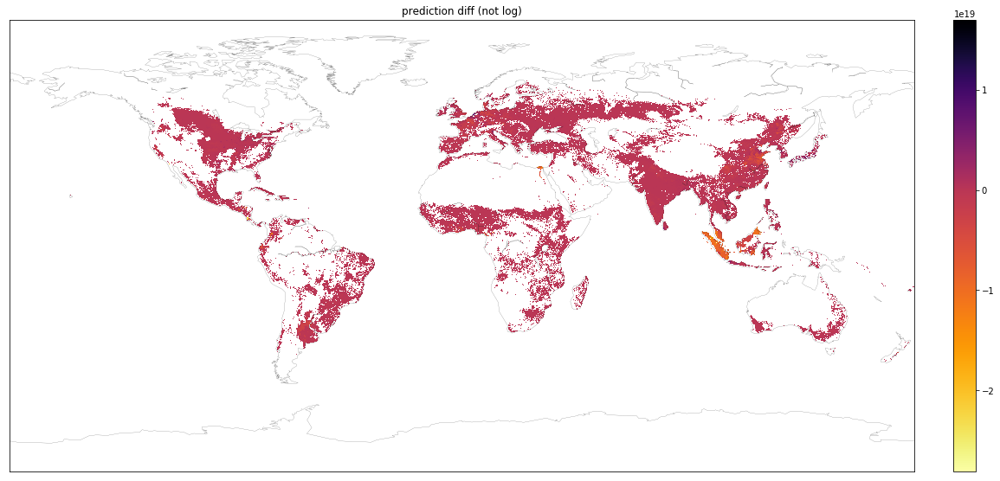

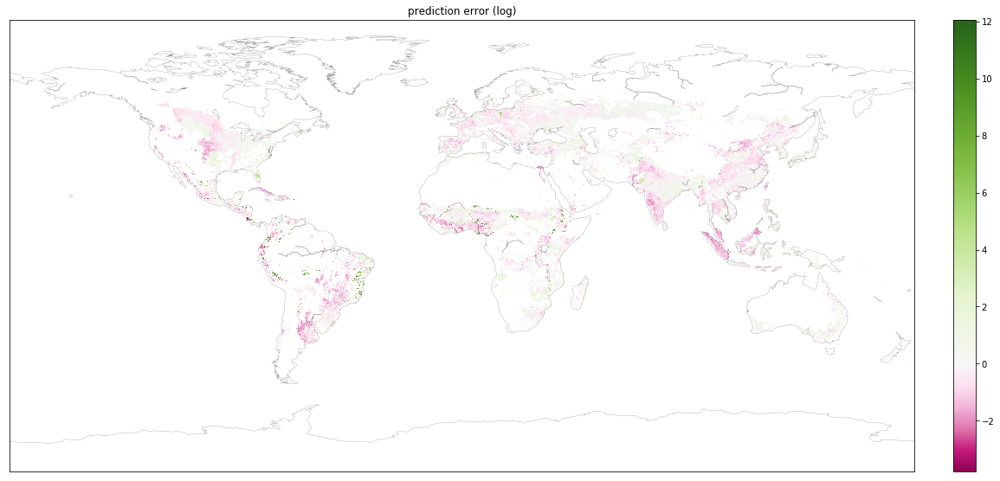

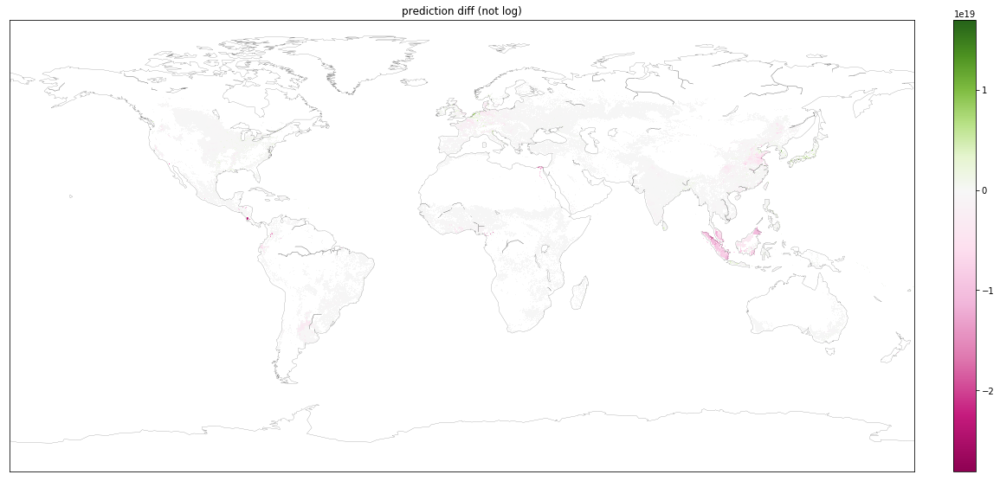

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


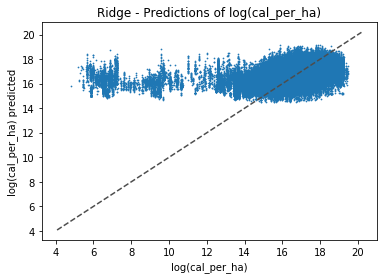

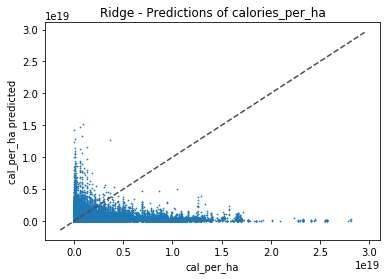

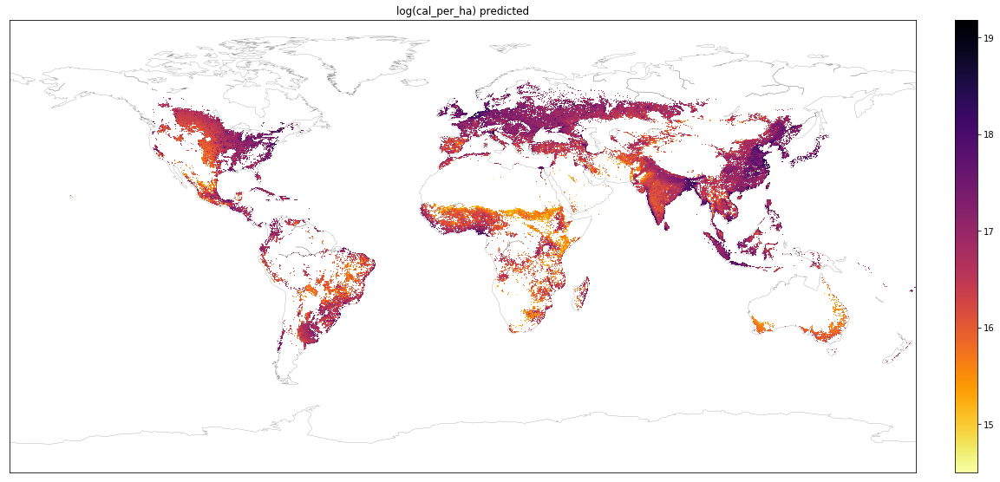

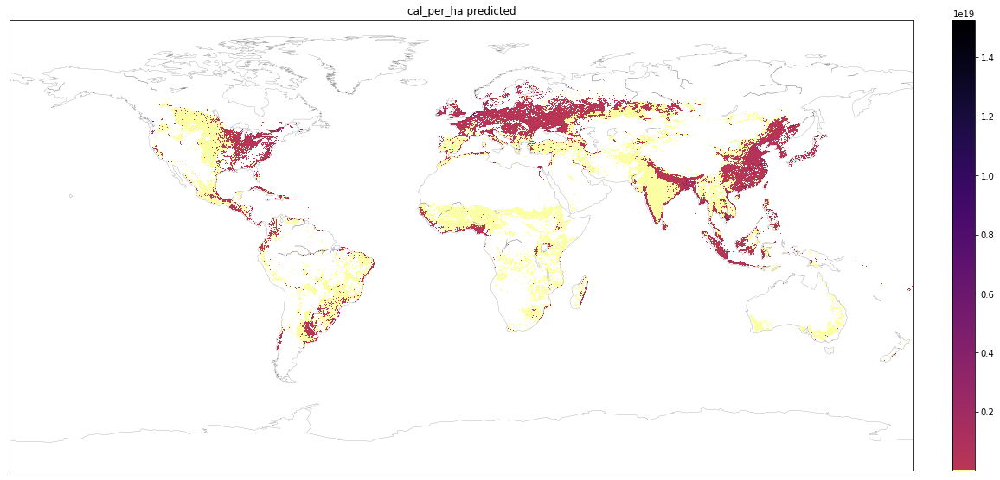

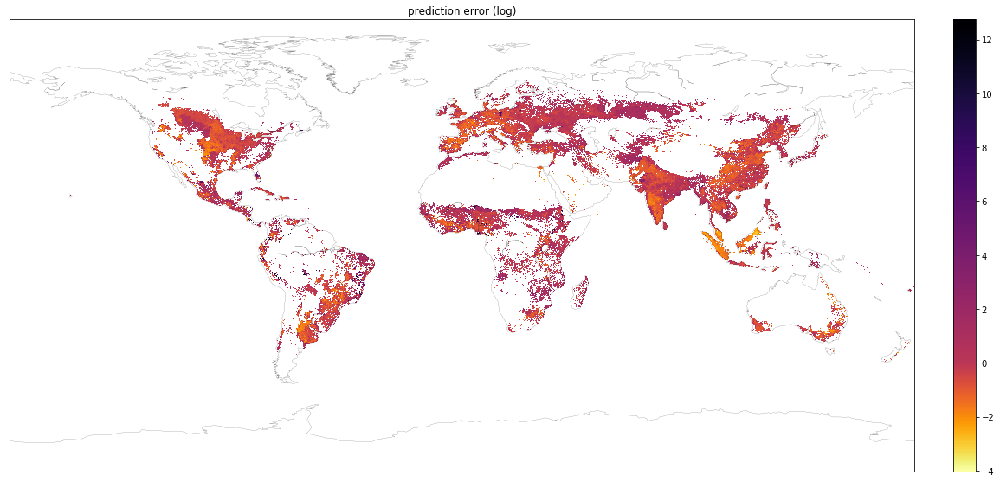

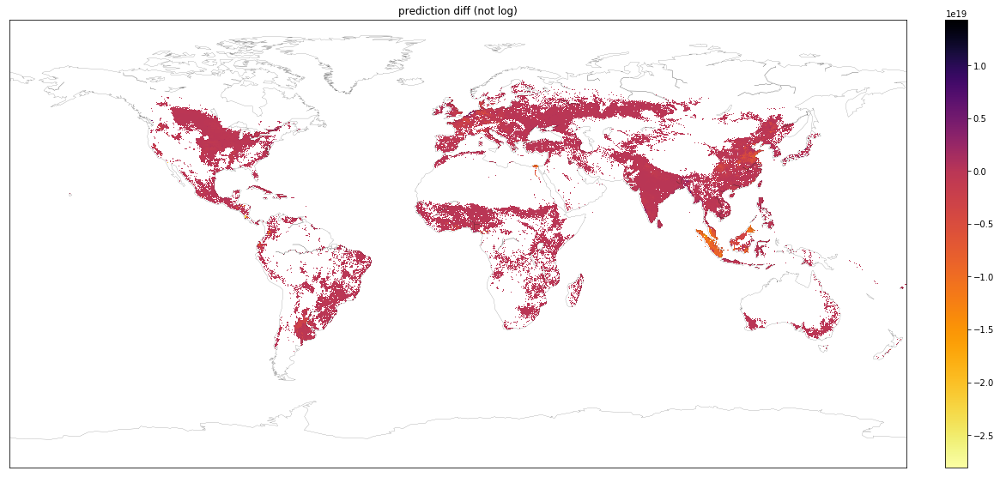

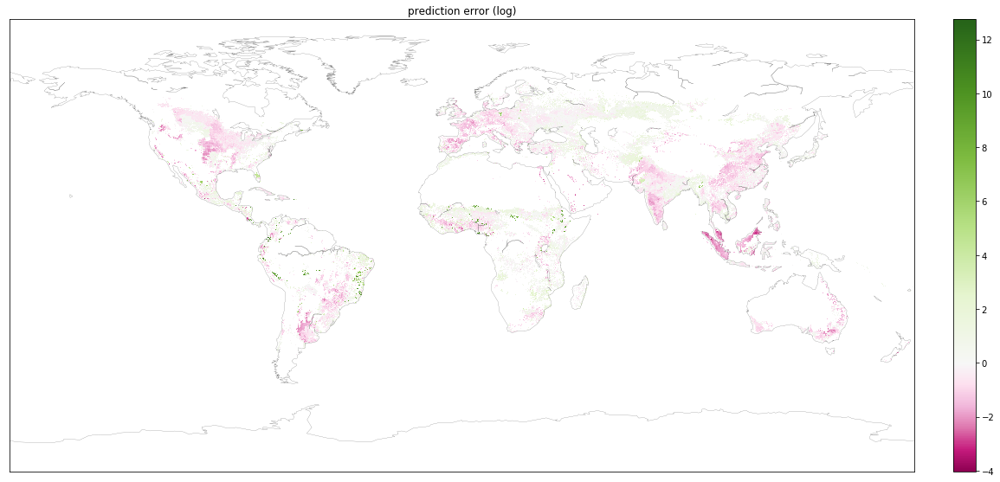

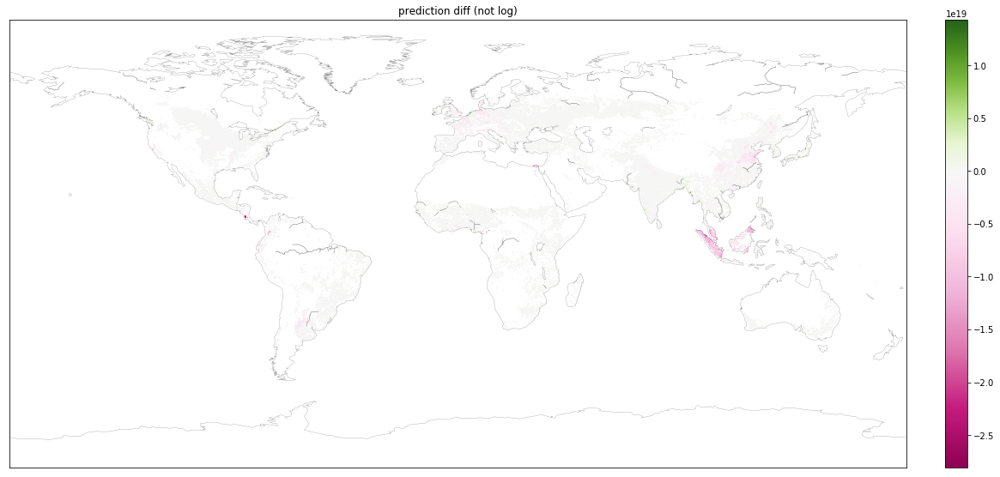

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


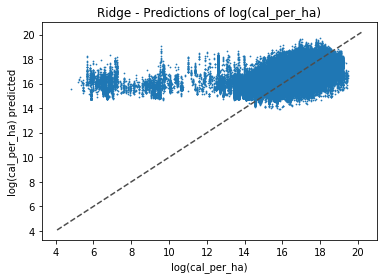

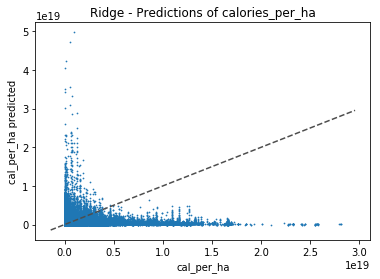

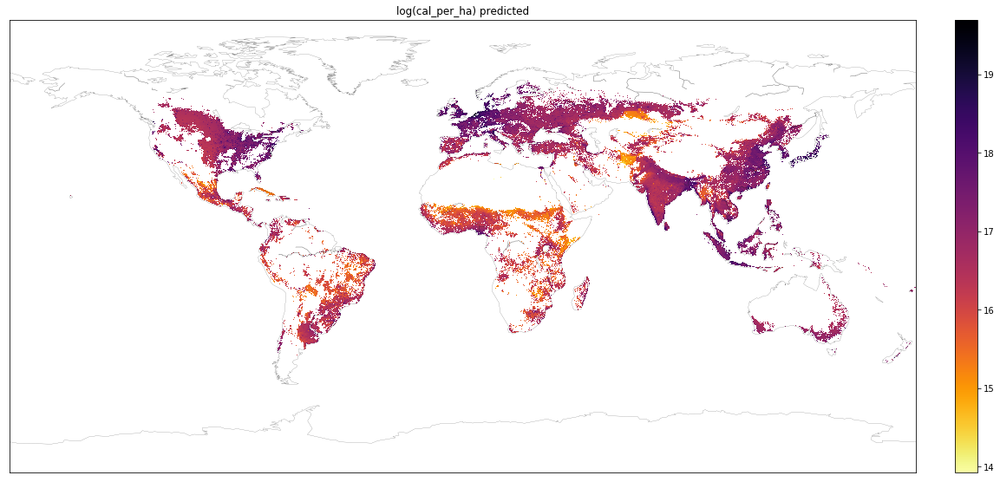

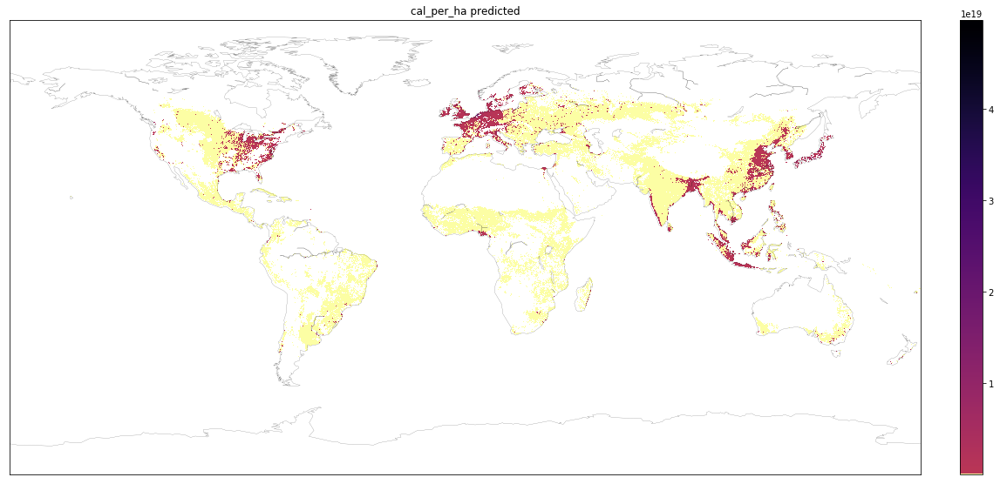

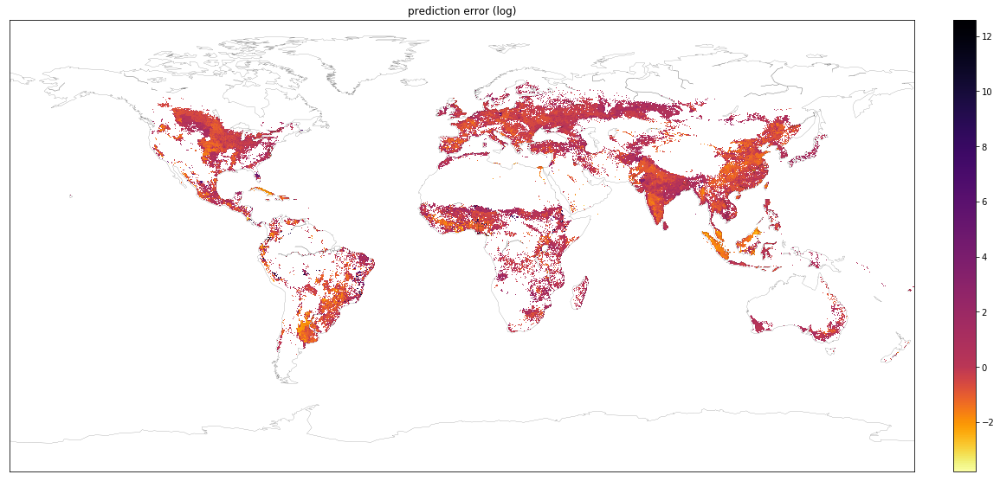

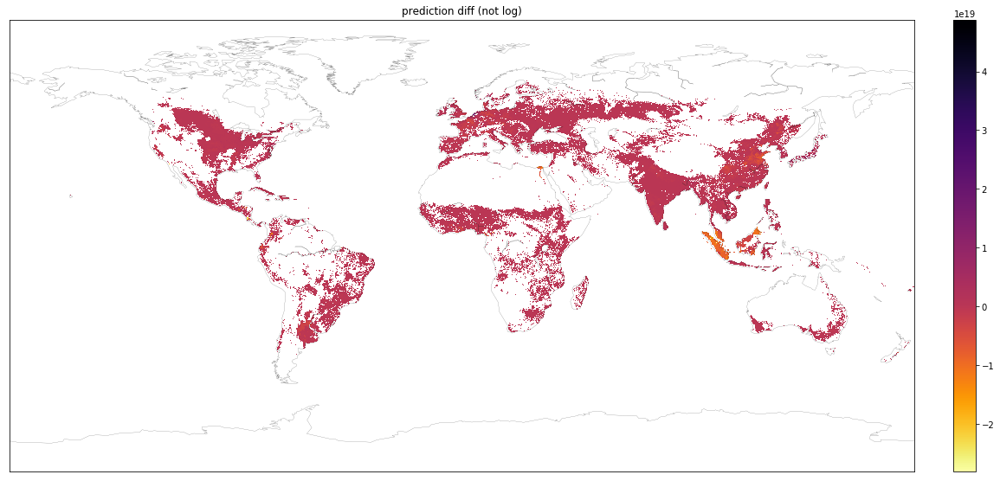

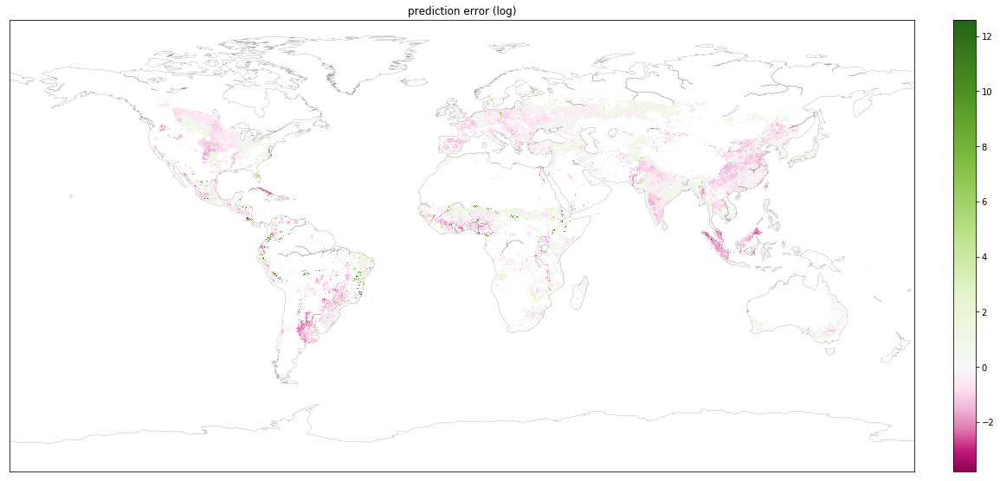

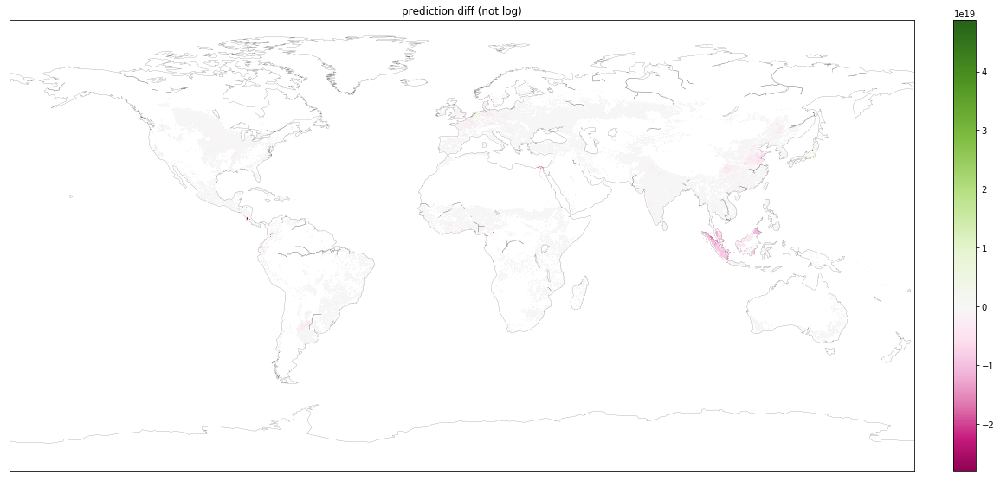

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


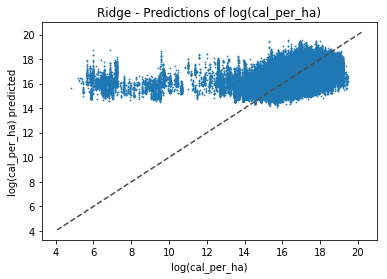

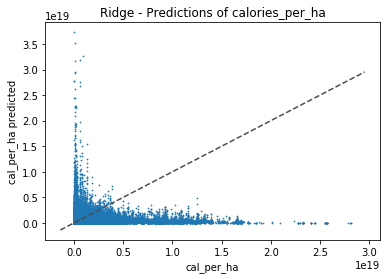

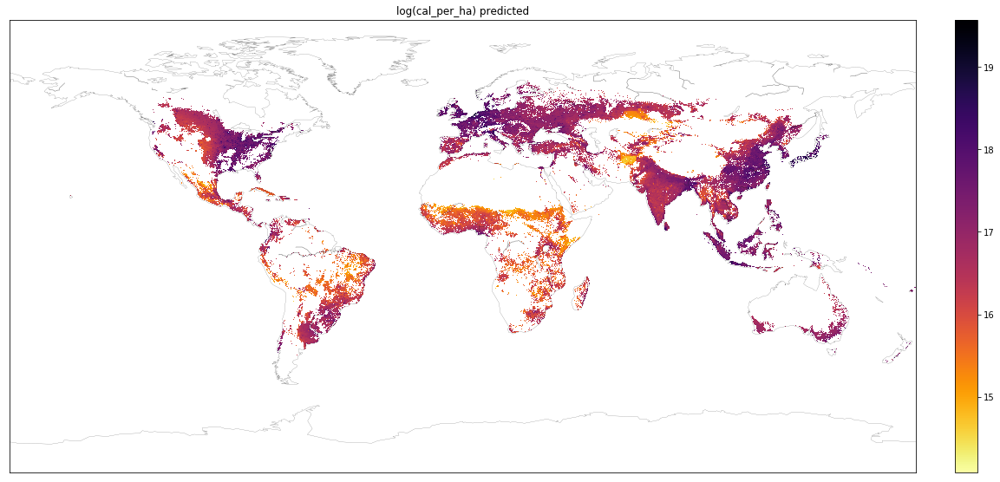

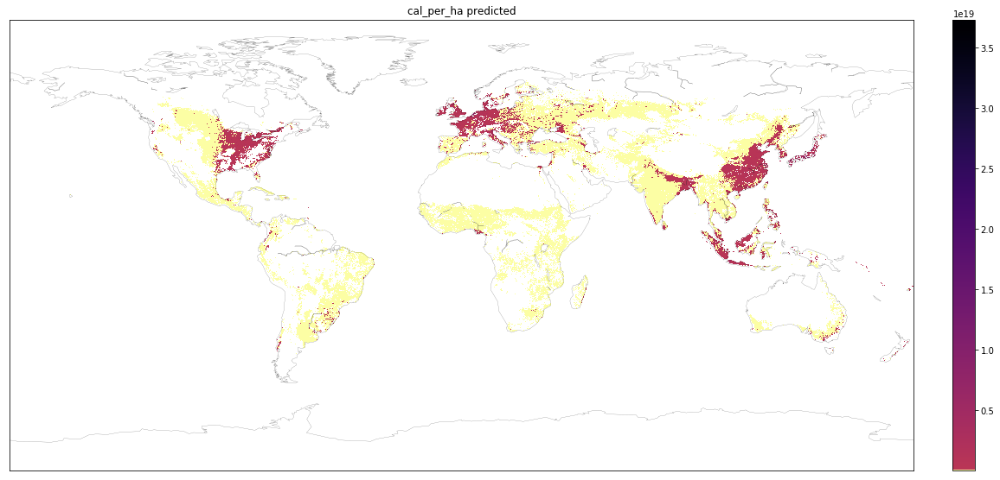

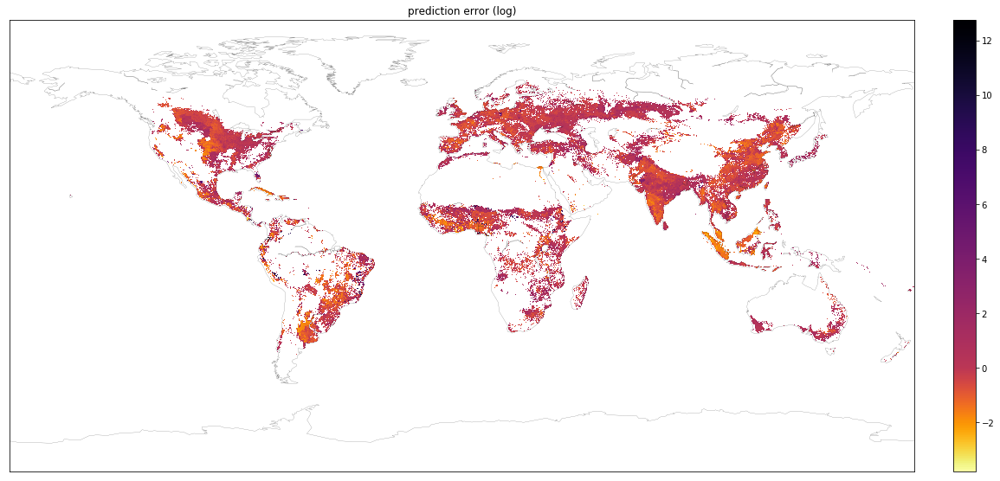

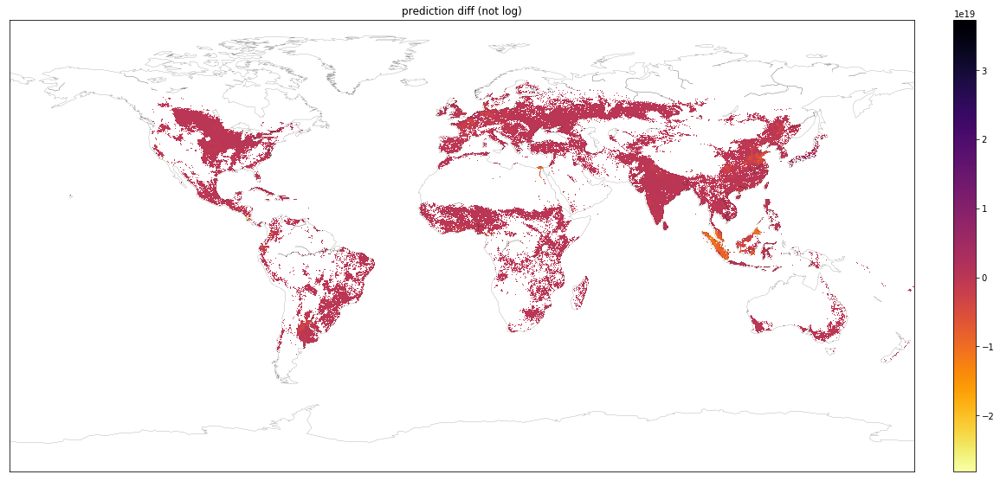

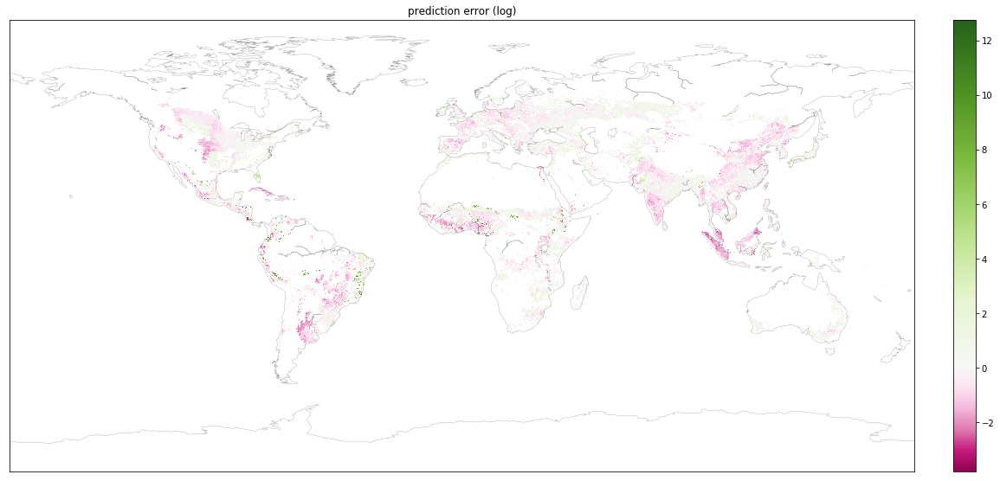

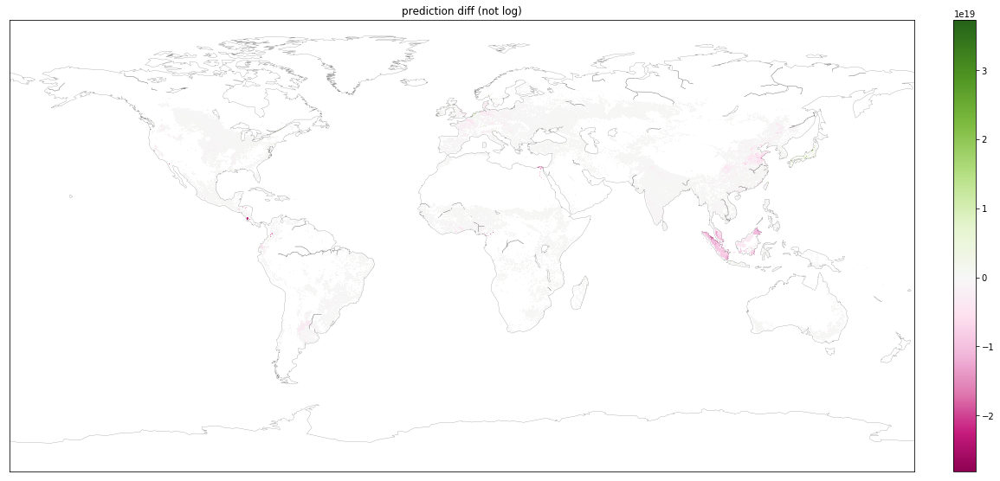

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


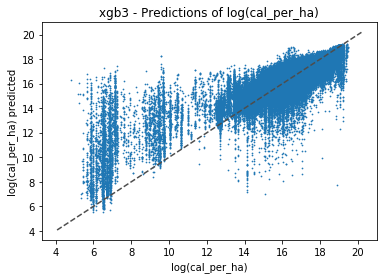

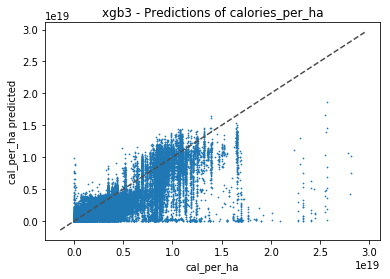

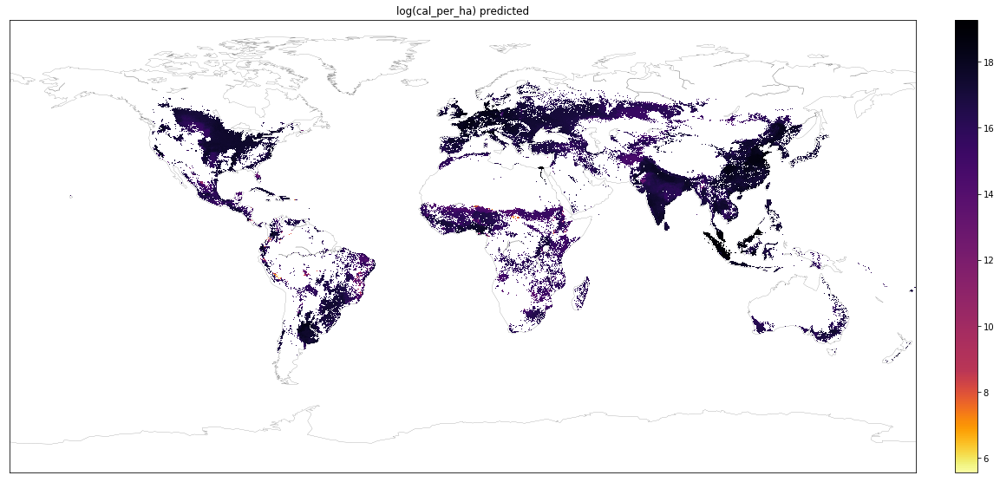

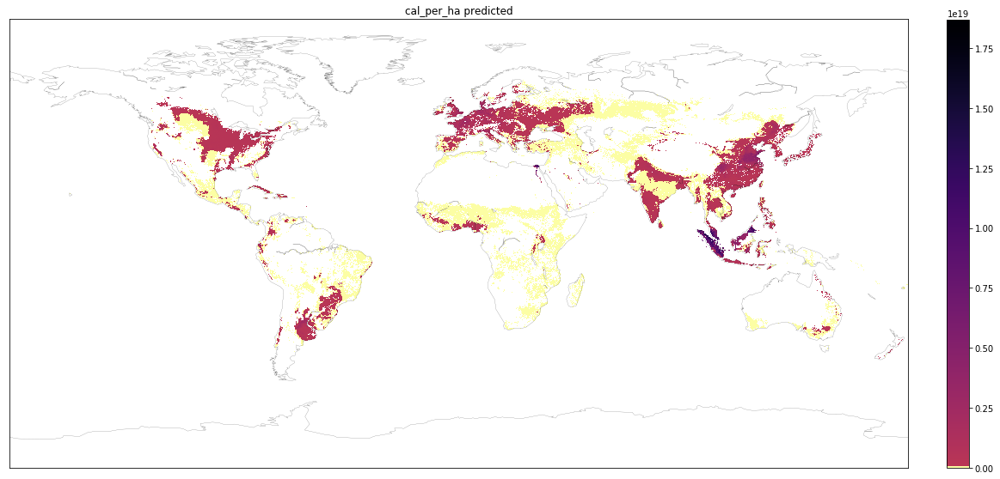

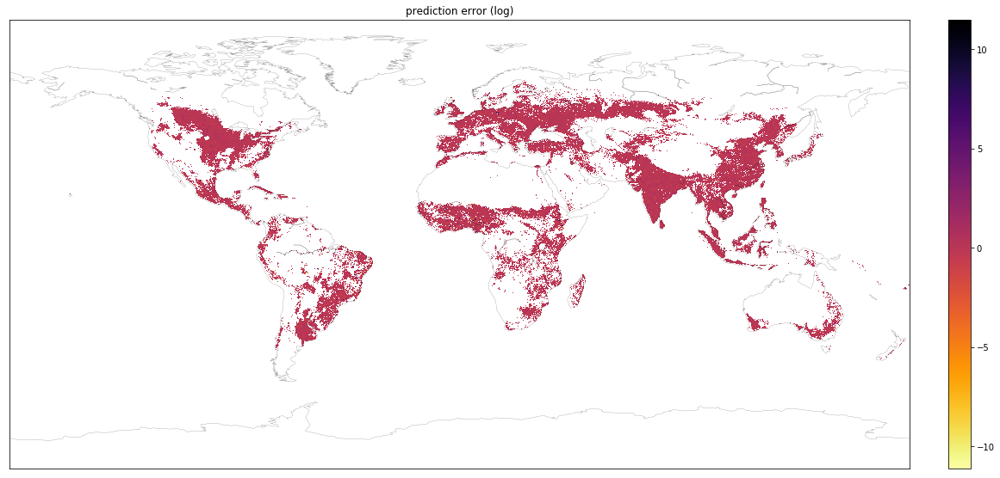

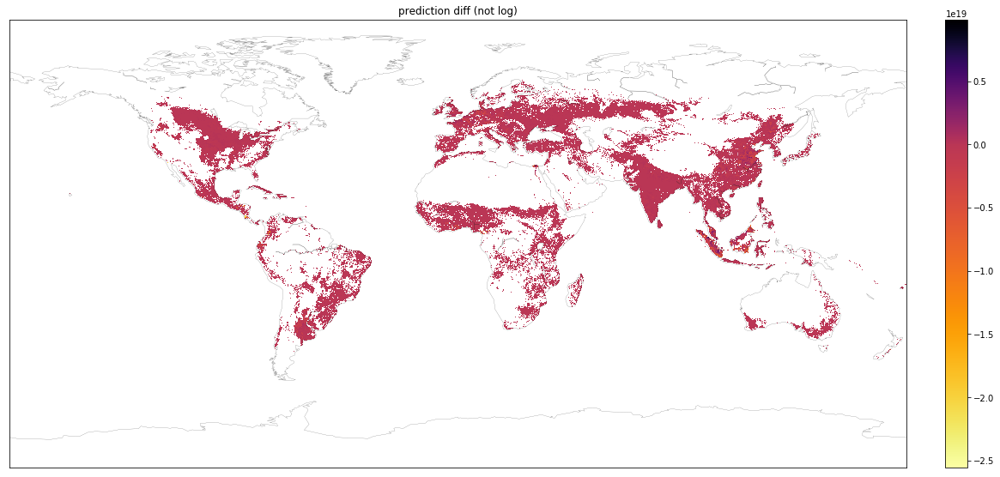

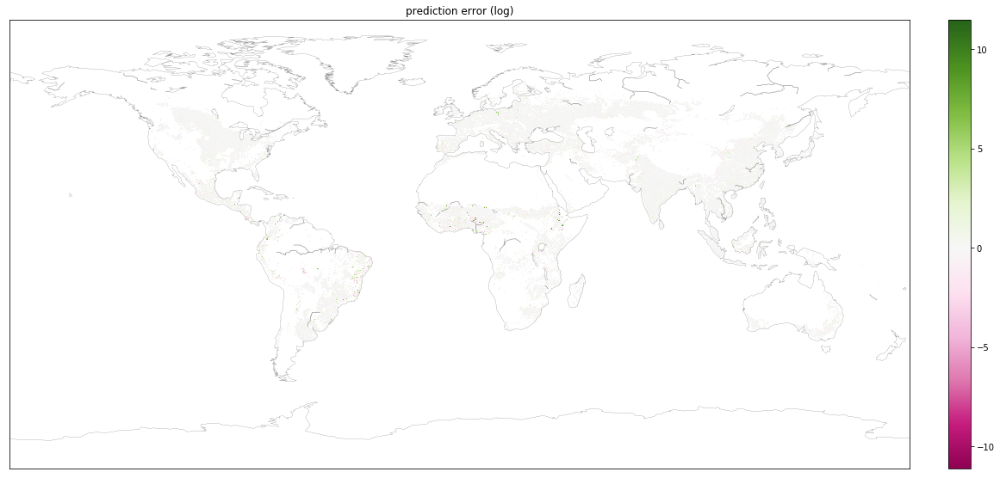

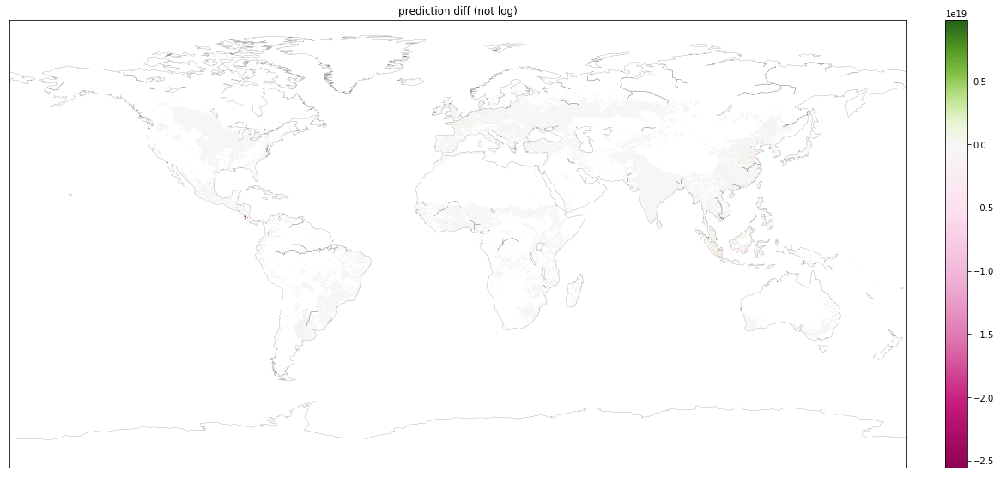

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


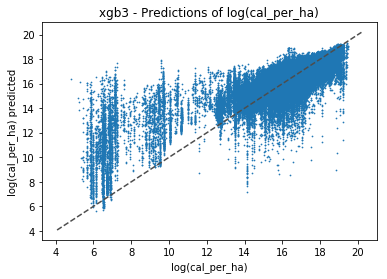

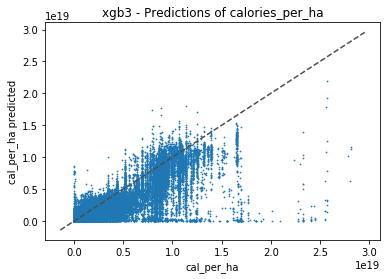

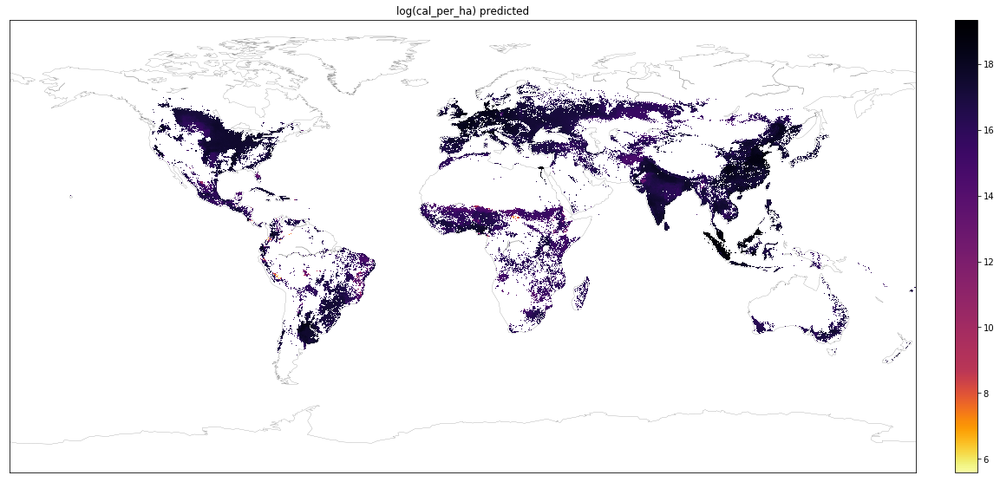

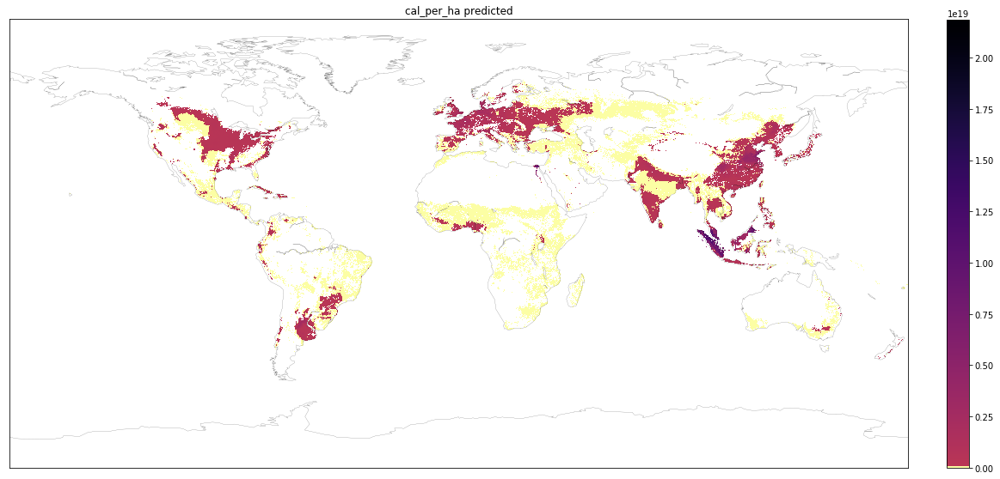

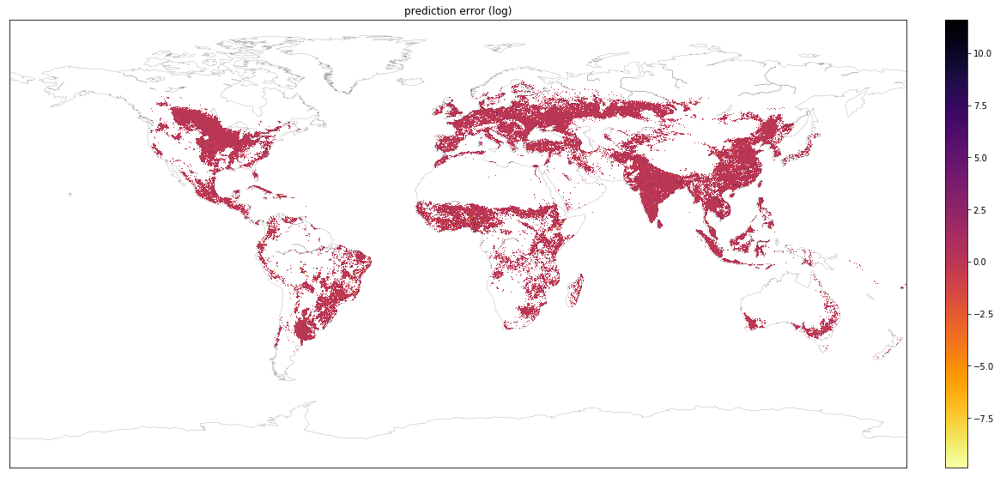

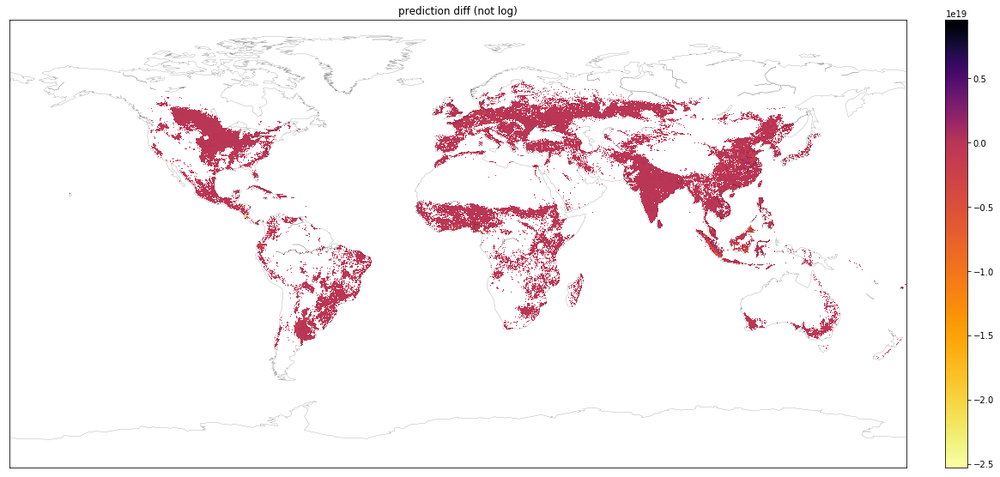

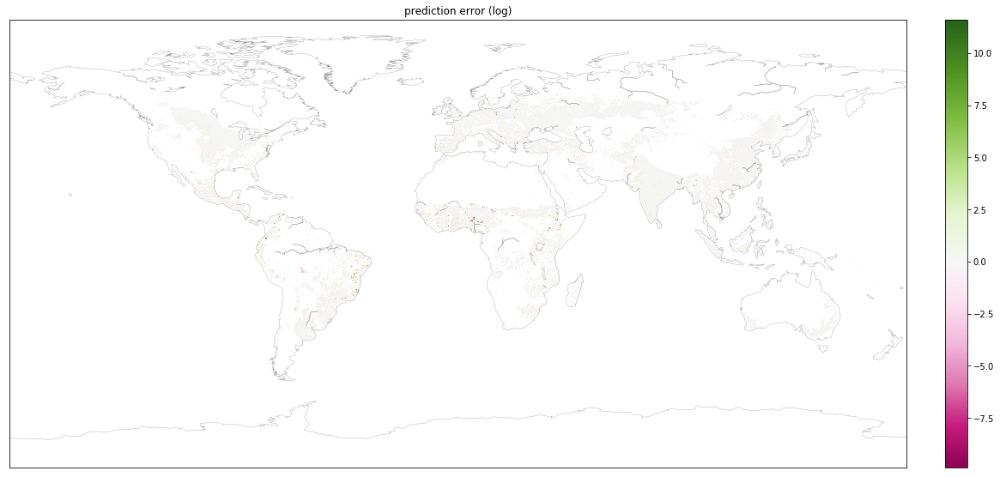

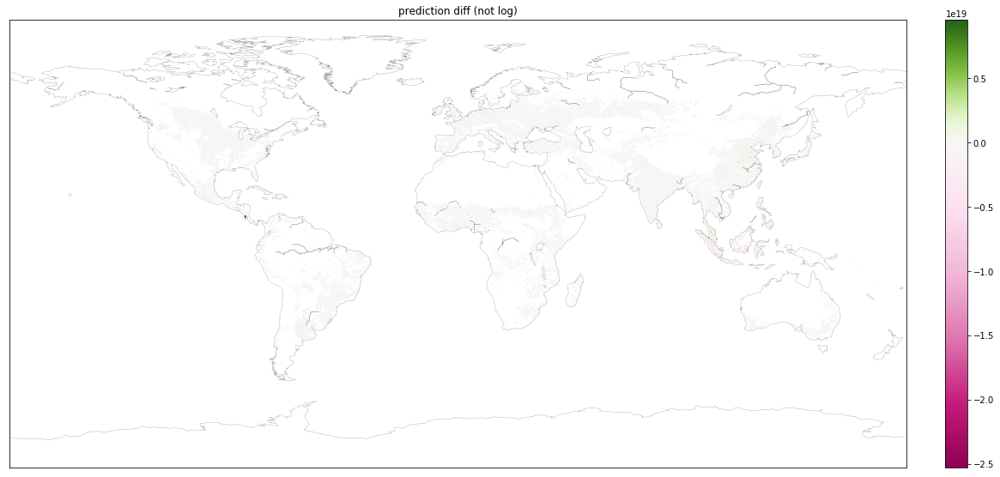

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


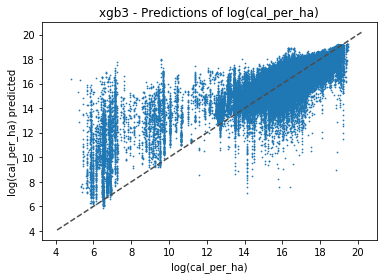

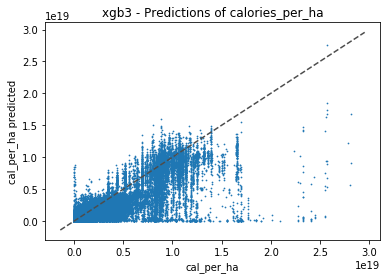

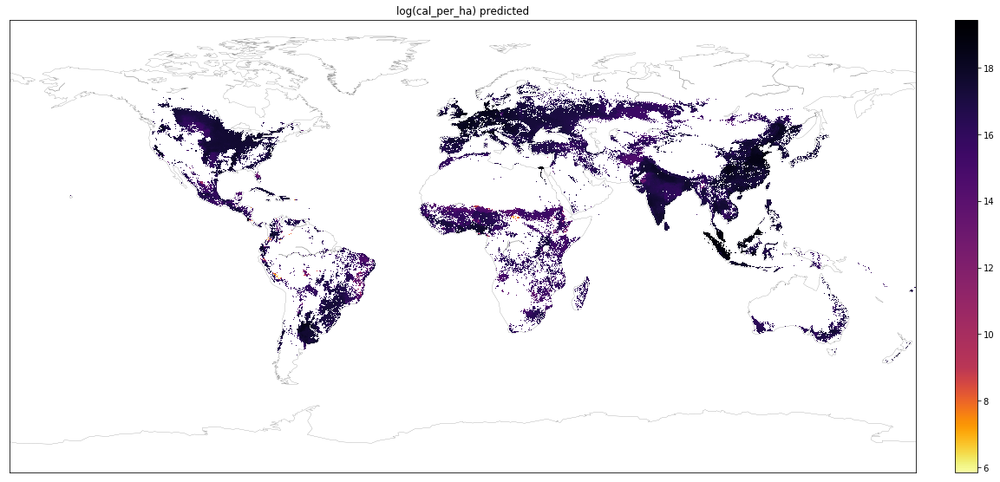

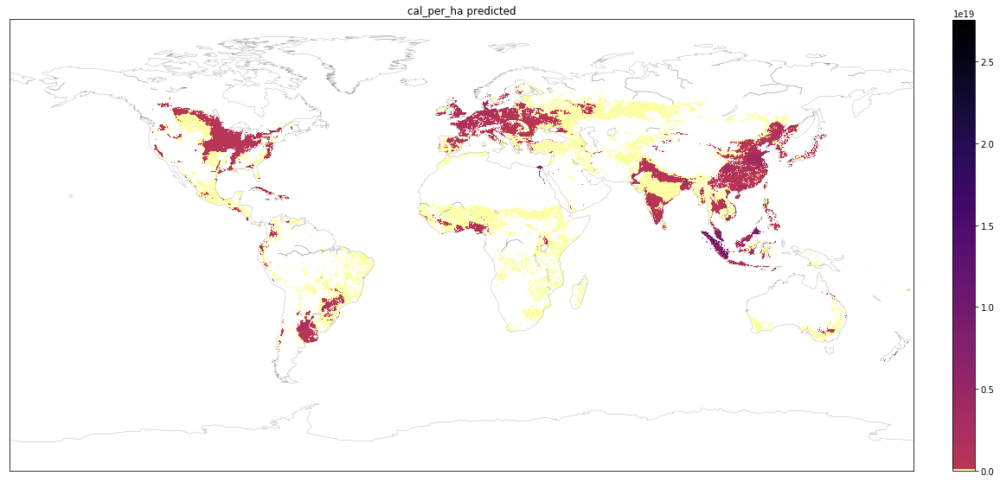

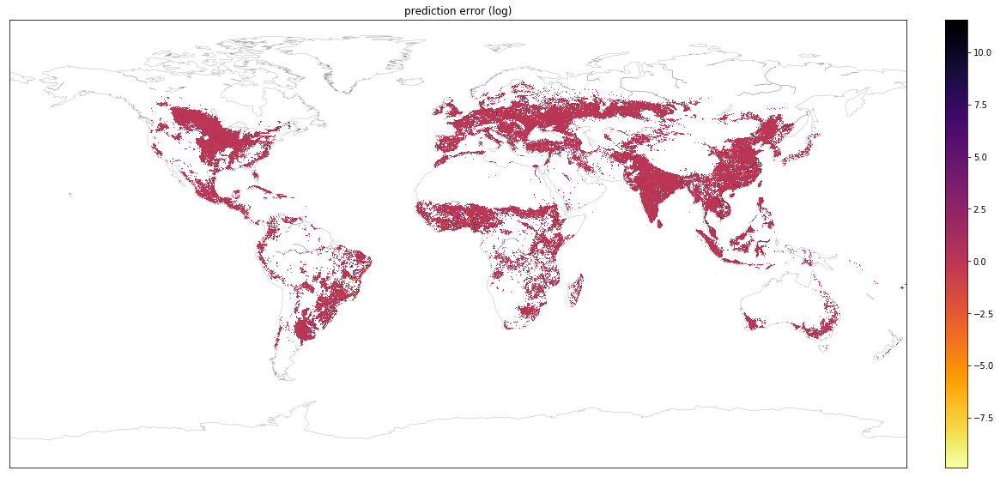

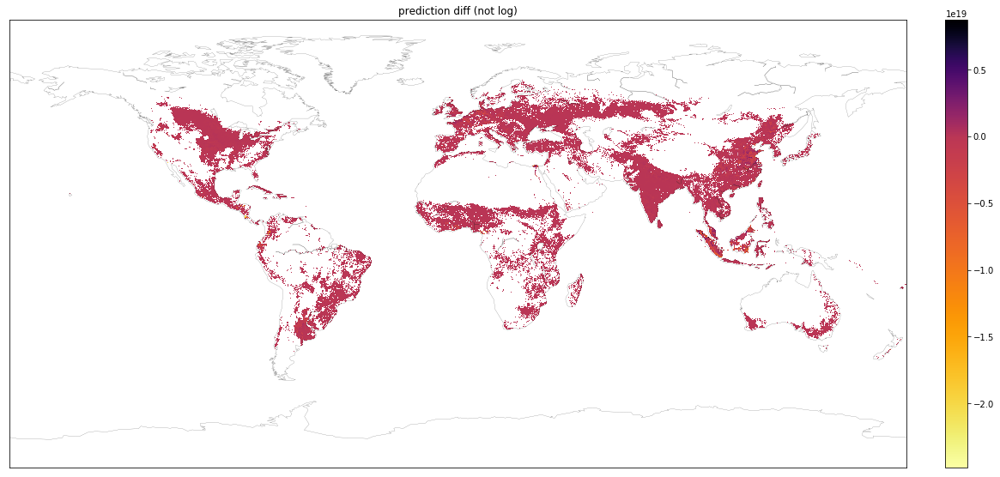

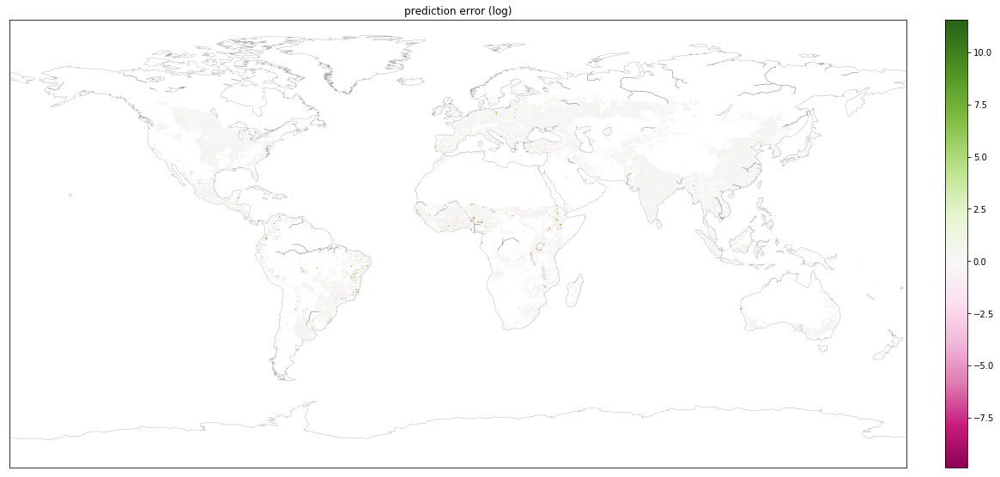

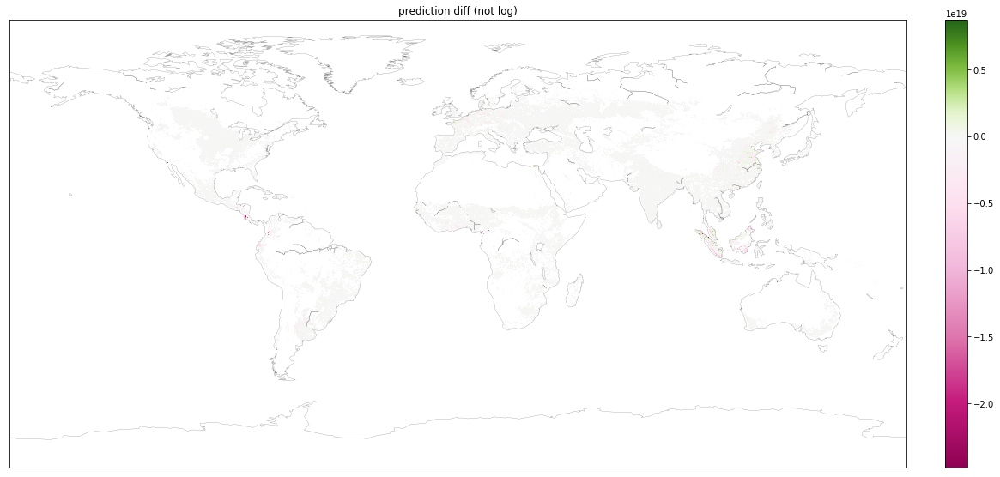

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


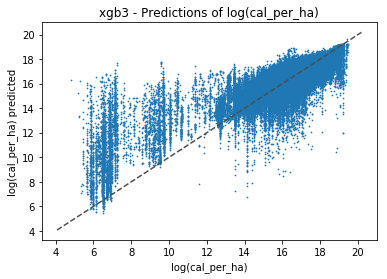

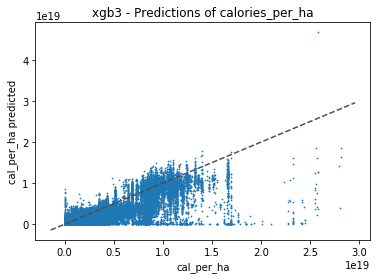

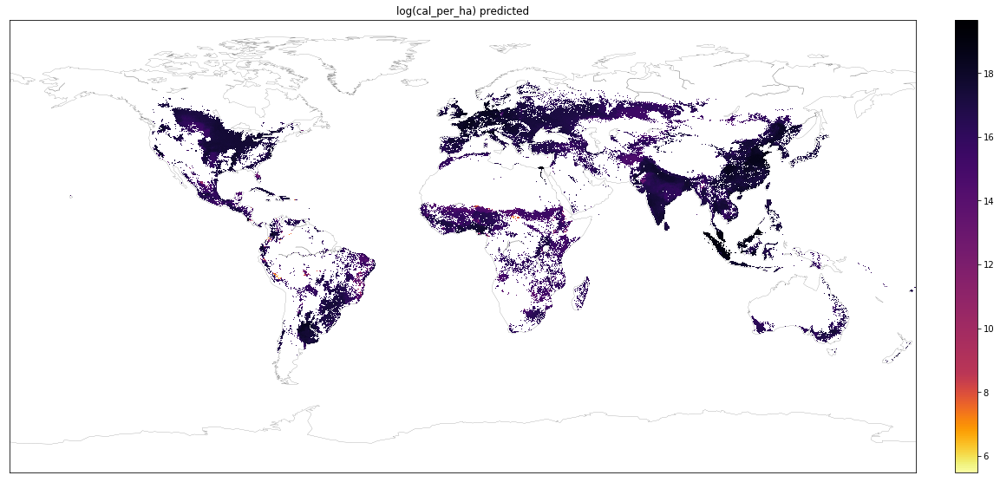

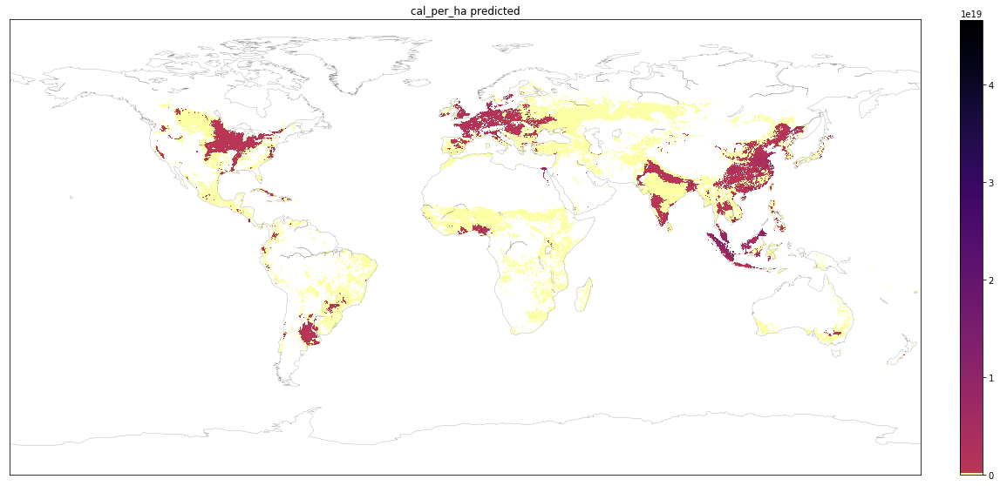

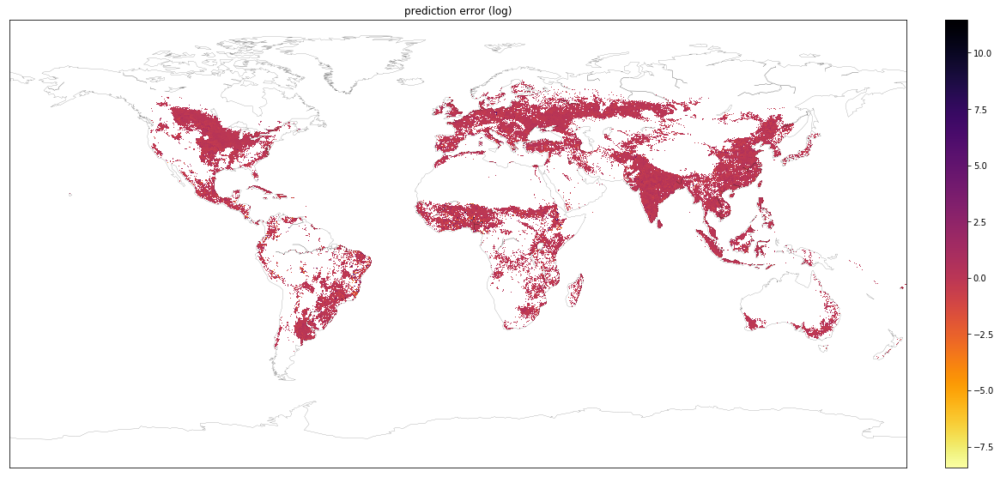

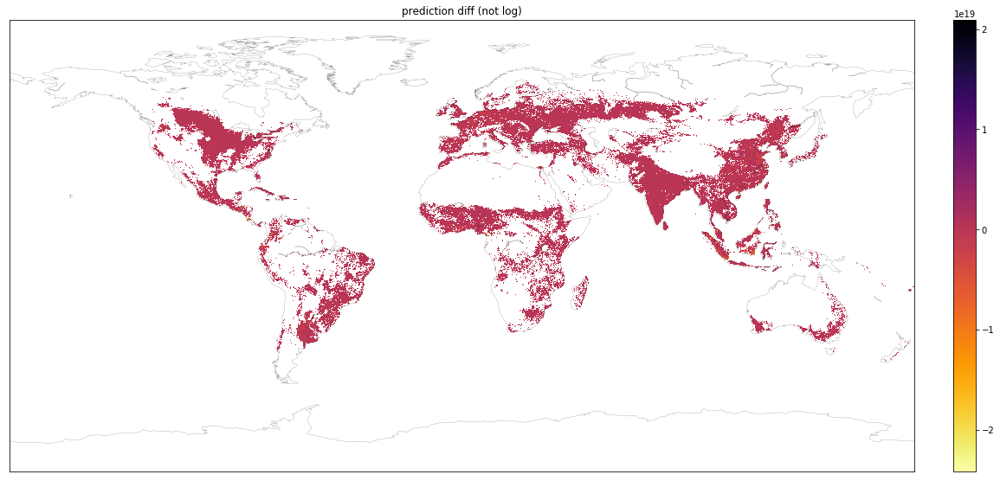

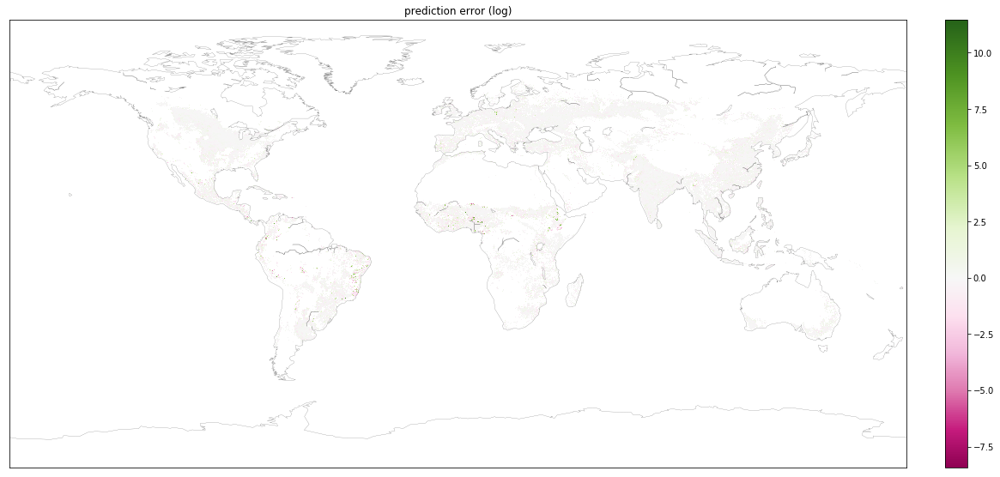

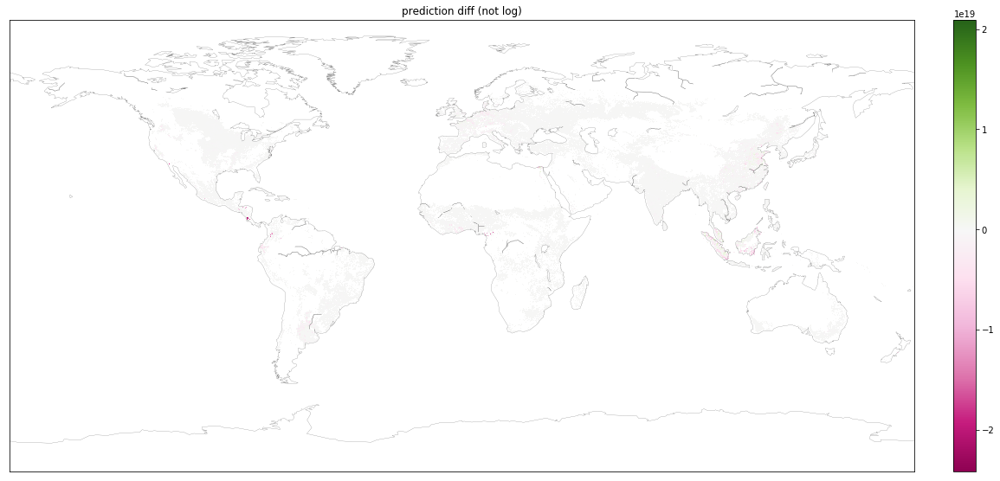

Maps & rasters done


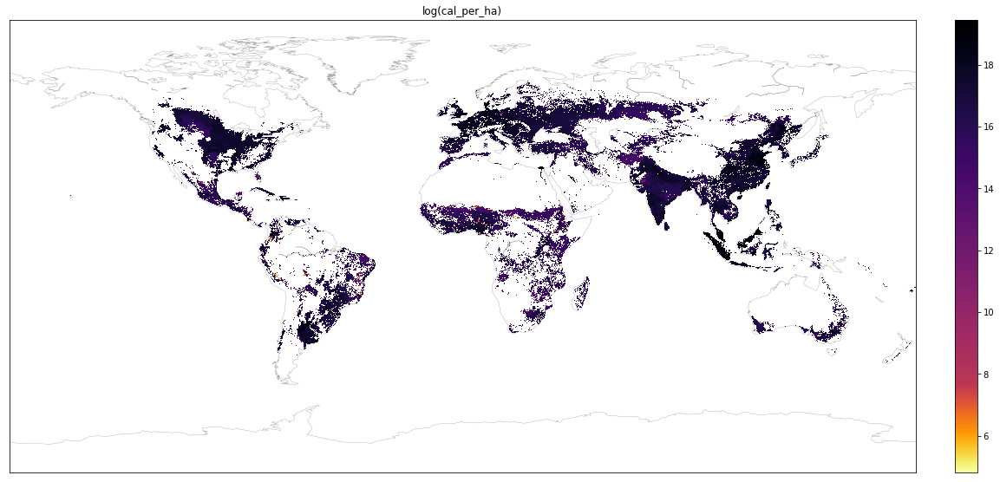

Baseline maps & rasters done


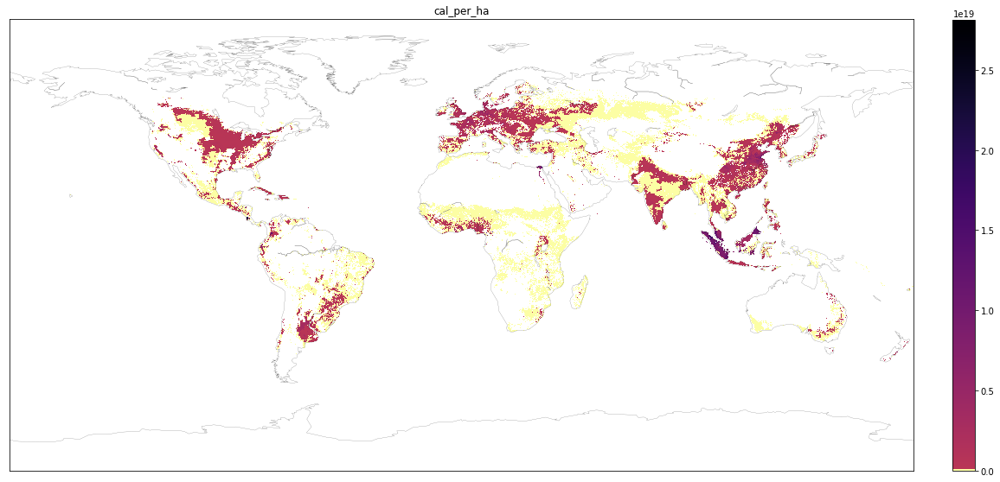

Baseline maps & rasters done


In [104]:
for model in ['Linear','Lasso','Ridge','xgb3']: # TO DO Poly
    for subset in ['','simplesubset','simplesubset_gdp','wo_climzones']:
        
        X = baseline_df.drop(['calories_per_ha'], axis=1)
        y = baseline_df['calories_per_ha']
            
        # Load model
        regression = load_regression(model+subset)
        print('\nRegression:')
        print(regression)

        # Subset 
        if subset == 'simplesubset':
            X_cols = [x for x in simple_subset if x !='calories_per_ha']
            X = X[X_cols]
        elif subset == 'simplesubset_gdp':
            X_cols = [x for x in simple_subset_gdp if x !='calories_per_ha']
            X = X[X_cols]
        elif subset == 'wo_climzones':
            X_cols = [x for x in columns_without_climatezones if x !='calories_per_ha']
            X = X[X_cols]

        # Apply model
        y_predicted = regression.predict(X)
        compare = predictions_df()

        # Save scatterplots
        ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title=(str(model)+' - Predictions of log(cal_per_ha)'));
        ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
        plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log---'+str(model)+'.png')


        ax = compare.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title=(str(model)+' - Predictions of calories_per_ha'));
        ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
        plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted---'+str(model)+'.png')
        print('Scatterplots done')

        # Save maps + rasters (rasters TO DO fct export_raster)    
        for column in ['log(cal_per_ha) predicted','cal_per_ha predicted',
                      'prediction error (log)','prediction diff (not log)']:
            visualize_data(compare,column,colorscheme='sequential',
                       savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'--'+model+'.png')


            export_raster(compare,column,
                     savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'--'+model+'.png')
        
        for column in ['prediction error (log)','prediction diff (not log)']:
            visualize_data(compare,column,
                       savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'--'+model+'.png')


            export_raster(compare,column,
                     savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'--'+model+'.png')
        print('Maps & rasters done')
    
for column in ['log(cal_per_ha)','cal_per_ha']:       
    visualize_data(compare,column,colorscheme='sequential',
                   savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'.png')
    
    export_raster(compare,column,
                  savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'.png')
    print('Baseline maps & rasters done')
    

## Full Loop (breaks kernel) - Output scatterplots + maps for baseline & new climate scenarios

In [ ]:
for scenario_df in [baseline_df, rcp45_2050_df, rcp85_2050_df, rcp45_2070_df, rcp85_2070_df]:

    for model in ['Linear','Lasso','Ridge','xgb3','Poly']: 
        for subset in ['all_inputs','simplesubset','simplesubset_gdp','wo_climzones']:

            X = scenario_df.drop(['calories_per_ha'], axis=1)
            y = scenario_df['calories_per_ha']

            # Load model
            if subset == 'all_inputs':
                regression = load_regression(model)
            else:
                regression = load_regression(model+subset)
            print('\nRegression:')
            print(regression)

            # Subset 
            if subset == 'simplesubset':
                X_cols = [x for x in simple_subset if x !='calories_per_ha']
                X = X[X_cols]
            elif subset == 'simplesubset_gdp':
                X_cols = [x for x in simple_subset_gdp if x !='calories_per_ha']
                X = X[X_cols]
            elif subset == 'wo_climzones':
                X_cols = [x for x in columns_without_climatezones if x !='calories_per_ha']
                X = X[X_cols]

            # Apply model
            if model == 'Poly':
                df_to_make_poly = X.merge(pd.DataFrame(y),right_index=True,left_index=True)
                df_poly = make_polynomial(df_to_make_poly)
                X = df_poly.drop(['calories_per_ha'], axis=1)
                
            y_predicted = regression.predict(X)
            compare = predictions_df(y_predicted)

            # Save scatterplots
            ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title=(str(model)+' - Predictions of log(cal_per_ha)'));
            ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
            plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/y_predicted_log---'+scenario_df.name+'.png')


            ax = compare.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title=(str(model)+' - Predictions of calories_per_ha'));
            ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
            plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/y_predicted---'+scenario_df.name+'.png')
            print('Scatterplots done')

            # Save maps + rasters (rasters TO DO fct export_raster)    
            for column in ['log(cal_per_ha) predicted','cal_per_ha predicted']:
                visualize_data(compare,column,colorscheme='sequential',
                           savefig = '../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/Map'+column+'---'+scenario_df.name+'.png')


                export_raster(compare,column,
                         savefig = '../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/Raster'+column+'---'+scenario_df.name+'.png')

            ####TODO CA N'A PAS DE SENS DE FAIRE PREDICTION ERROR FOR NEW CLIMATE DATA BC LE Y EST LE BASELINE Y!!!
            #### EN FAIT IL FAUT FAIRE CHANGE IN LOG_CAL_PER_HA = (MODELED NEW CLIMATE) - (MODELED 2015) 
            for column in ['prediction error (log)','prediction diff (not log)']:
                visualize_data(compare,column,
                           savefig = '../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/Map'+column+'---'+scenario_df.name+'.png')


                export_raster(compare,column,
                         savefig = '../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/Raster'+column+'---'+scenario_df.name+'.png')
            print('Maps & rasters done')

for column in ['log(cal_per_ha)','cal_per_ha']:       
    visualize_data(compare,column,colorscheme='sequential',
                   savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'.png')
    
    export_raster(compare,column,
                  savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'.png')
    print('Baseline maps & rasters done')
    

# Load model & apply model

In [17]:
def load_regression(model):
    model_filename = '../ipbes_invest_crop_yield_project/output/Models/'+model+'.sav'
    regression = pickle.load(open(model_filename, 'rb'))
    return regression

In [15]:
y_predicted = regression.predict(X)

# Store results in a df

## Baseline data

In [ ]:
## Just pull up results from (long to run) code below:

compare_lr = pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_lr.csv')
compare_lasso = pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_lasso.csv')
compare_ridge = pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_ridge.csv')
compare_poly = pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_poly.csv')
compare_xgb = pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb.csv')

# Wrong one stored ! compare_xgb_simplesubset = pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_simplesubset.csv')

If the one you want is not already there as csv, must do below:

In [48]:
def make_results_df(model,subset=False):
    
    if subset == False:
        regression = load_regression(model)
        y_predicted = regression.predict(X)
        compare = predictions_df(y_predicted)      
    
    elif subset == 'simplesubset':
        s = [x for x in simple_subset if x !='calories_per_ha']
        regression = load_regression(model+'_simplesubset')
        y_predicted = regression.predict(X[s])
        compare = predictions_df(y_predicted)
        
    elif subset == 'wo_latlon':
        s1 = [x for x in X.columns if (x !='lat')]
        s2 = [x for x in s1 if (x !='sin_lon')]
        regression = load_regression(model+'wo_latlon')
        y_predicted = regression.predict(X[s2])
        compare = predictions_df(y_predicted)
    
    return compare

In [49]:
compare_lr = make_results_df('Linear')
compare_lasso = make_results_df('Lasso')
compare_ridge = make_results_df('Ridge')
compare_xgb =  make_results_df('xgb3')

In [52]:
model= 'Poly'
if model == 'Poly':
    df_to_make_poly = X.merge(pd.DataFrame(y),right_index=True,left_index=True)
    df_poly = make_polynomial(df_to_make_poly)
    X_poly = df_poly.drop(['calories_per_ha'], axis=1)
else:
    X = baseline_df.drop(['calories_per_ha'], axis=1)
             
regression = load_regression(model)
y_predicted = regression.predict(X_poly)
compare_poly = predictions_df(y_predicted)

In [53]:
compare_lr.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_lr.csv')
compare_lasso.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_lasso.csv')
compare_ridge.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_ridge.csv')
compare_poly.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_poly.csv')
compare_xgb.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb.csv')

Subset

In [234]:
compare_xgb_wo_latlon  = make_results_df('xgb3',subset='wo_latlon')

In [235]:
compare_xgb_wo_latlon.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_wo_latlon.csv')

In [236]:
simple_subset = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'log_gpw_population',
                  'temp_avg','precip',
                  'calories_per_ha']

In [237]:
compare_xgb_simplesubset = make_results_df('xgb3',subset='simplesubset')

In [238]:
compare_xgb_simplesubset.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_simplesubset.csv')

Make the compare df

In [47]:
def predictions_df(y_predicted):
    compare = pd.DataFrame()

    compare['log(cal_per_ha)'] = y
    compare['log(cal_per_ha) predicted'] = y_predicted

    compare['cal_per_ha'] = compare['log(cal_per_ha)'].apply(lambda x: np.exp(x))
    compare['cal_per_ha predicted'] = compare['log(cal_per_ha) predicted'].apply(lambda x: np.exp(x))

    compare['prediction error (log)'] = compare['log(cal_per_ha) predicted'] - compare['log(cal_per_ha)']
    compare['prediction diff (not log)'] = compare['cal_per_ha predicted'] - compare['cal_per_ha']
    
    return compare

## Climate data

In [77]:
## Can just retrieve csvs!

compare_rcp45_2050 = pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_rcp45_2050.csv')
compare_rcp45_2070= pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_rcp45_2070.csv')
compare_rcp85_2050= pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_rcp85_2050.csv')
compare_rcp85_2070= pd.read_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_rcp85_2070.csv')

compare_rcp45_2050['Δlog(cal_per_ha)'].name = 'Log change in caloric yields under RCP4.5 in 2050'
compare_rcp45_2070['Δlog(cal_per_ha)'].name = 'Log change in caloric yields under RCP4.5 in 2070'
compare_rcp85_2050['Δlog(cal_per_ha)'].name = 'Log change in caloric yields under RCP8.5 in 2050'
compare_rcp85_2070['Δlog(cal_per_ha)'].name = 'Log change in caloric yields under RCP8.5 in 2070'

compare_rcp45_2050['Δcal_per_ha'].name = 'Change in caloric yields under RCP4.5 in 2050'
compare_rcp45_2070['Δcal_per_ha'].name = 'Change in caloric yields under RCP4.5 in 2070'
compare_rcp85_2050['Δcal_per_ha'].name = 'Change in caloric yields under RCP8.5 in 2050'
compare_rcp85_2070['Δcal_per_ha'].name = 'Change in caloric yields under RCP8.5 in 2070'

compare_rcp45_2050 = compare_rcp45_2050.set_index('pixel_id')
compare_rcp45_2070 = compare_rcp45_2070.set_index('pixel_id')
compare_rcp85_2050 = compare_rcp85_2050.set_index('pixel_id')
compare_rcp85_2070 = compare_rcp85_2070.set_index('pixel_id')

--

In [82]:
def future_predictions_df(y_predicted):
    compare = pd.DataFrame()

    # 2000 measured
    compare['log(cal_per_ha) 2000 measured'] = y
    compare['cal_per_ha 2000 measured'] = y.apply(lambda x: np.exp(x))
    
    # Future climate predicted
    compare['log(cal_per_ha) future predicted'] = y_predicted
    compare['cal_per_ha future predicted'] = compare['log(cal_per_ha) future predicted'].apply(lambda x: np.exp(x))
    
    compare['Δlog(cal_per_ha)'] = compare['log(cal_per_ha) future predicted'] - compare['log(cal_per_ha) 2000 measured']
    compare['Δcal_per_ha'] = compare['cal_per_ha future predicted'] - compare['cal_per_ha 2000 measured']

    # 2000 predicted
    compare = compare.merge(compare_xgb[['log(cal_per_ha) predicted','cal_per_ha predicted']].head(),
                  how='outer',right_index=True, left_index=True, suffixes=['','2000 predicted'])
    compare = compare.rename({'log(cal_per_ha) predicted':'log(cal_per_ha) 2000 predicted',
             'cal_per_ha predicted':'cal_per_ha 2000 predicted'},axis=1)

    
    return compare

In [69]:
def make_results_future_df(model,future_df,
                           subset=False):
    
    if subset == False:
        regression = load_regression(model)
        y_predicted = regression.predict(future_df)
        compare = future_predictions_df(y_predicted)      

    return compare

In [74]:
compare_rcp45_2050 = make_results_future_df('xgb3',rcp45_2050_df)

In [75]:
compare_rcp45_2070 = make_results_future_df('xgb3',rcp45_2070_df)
compare_rcp85_2050 = make_results_future_df('xgb3',rcp85_2050_df)
compare_rcp85_2070 = make_results_future_df('xgb3',rcp85_2070_df)

In [76]:
compare_rcp45_2050.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_rcp45_2050.csv')
compare_rcp45_2070.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_rcp45_2070.csv')
compare_rcp85_2050.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_rcp85_2050.csv')
compare_rcp85_2070.to_csv('../ipbes_invest_crop_yield_project/output/compare_dfs/compare_xgb_rcp85_2070.csv')

# Fig 1 - R2 comparison

# Fig 3 - Projected future climates

In [81]:
compare_rcp45_2050.head()

,pixel_id,log(cal_per_ha) 2000 measured,cal_per_ha 2000 measured,log(cal_per_ha) future predicted,cal_per_ha future predicted,Δlog(cal_per_ha),Δcal_per_ha,log(cal_per_ha) predicted,cal_per_ha predicted
0,1090988,17.116737,2.714591e+07,17.195600,2.937341e+07,0.078864,2.227507e+06,17.190098,2.921222e+07
1,1112598,17.461977,3.833896e+07,17.237076,3.061730e+07,-0.224901,-7.721662e+06,17.339325,3.391354e+07
2,1121218,17.461977,3.833896e+07,17.176134,2.880715e+07,-0.285843,-9.531815e+06,17.262684,3.141148e+07
3,1121236,17.461977,3.833896e+07,17.179646,2.890848e+07,-0.282332,-9.430483e+06,17.260822,3.135306e+07
4,1181705,17.461977,3.833896e+07,17.098074,2.664398e+07,-0.363903,-1.169498e+07,17.207455,2.972368e+07


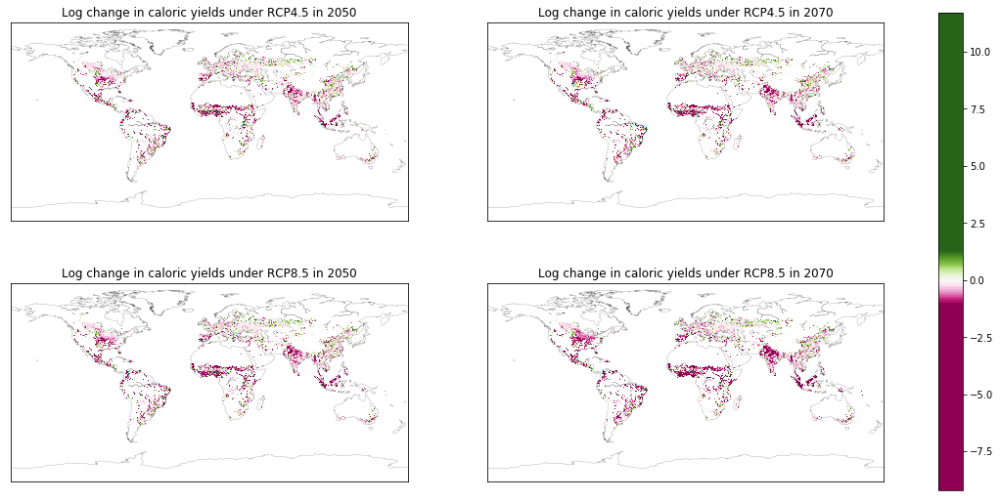

In [128]:
visualize_4_maps(compare_rcp45_2050['Δlog(cal_per_ha)'],
                 compare_rcp45_2070['Δlog(cal_per_ha)'],
                 compare_rcp85_2050['Δlog(cal_per_ha)'],
                 compare_rcp85_2070['Δlog(cal_per_ha)'],
                 #savefig='../ipbes_invest_crop_yield_project/output/Figures/XGB_Maps_Future_Climates.png',
                 colorscheme='diverging',resize=(-4.0,5.0),shape=(2160,4320))

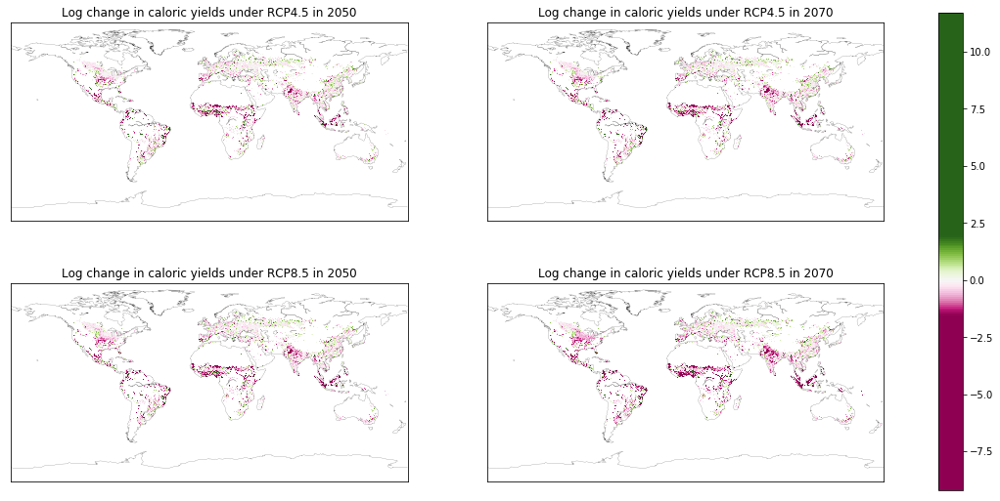

In [129]:
visualize_4_maps(compare_rcp45_2050['Δlog(cal_per_ha)'],
                 compare_rcp45_2070['Δlog(cal_per_ha)'],
                 compare_rcp85_2050['Δlog(cal_per_ha)'],
                 compare_rcp85_2070['Δlog(cal_per_ha)'],
                 savefig='../ipbes_invest_crop_yield_project/output/Figures/XGB_Maps_Future_Climates.png',
                 colorscheme='diverging',resize=(-2.5,3.5),shape=(2160,4320))

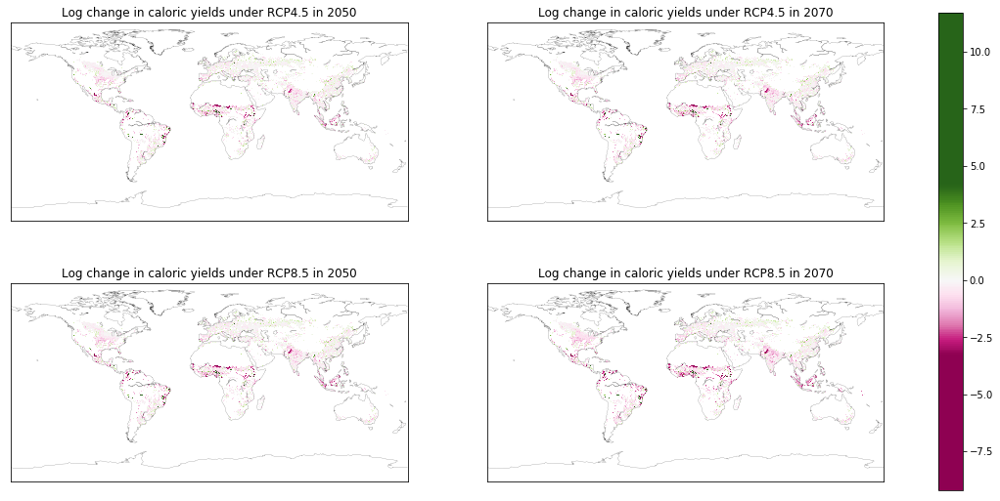

In [127]:
visualize_4_maps(compare_rcp45_2050['Δlog(cal_per_ha)'],
                 compare_rcp45_2070['Δlog(cal_per_ha)'],
                 compare_rcp85_2050['Δlog(cal_per_ha)'],
                 compare_rcp85_2070['Δlog(cal_per_ha)'],
                 #savefig='../ipbes_invest_crop_yield_project/output/Figures/XGB_Maps_Future_Climates.png',
                 colorscheme='diverging',resize=(-0.9,1.9),shape=(2160,4320))

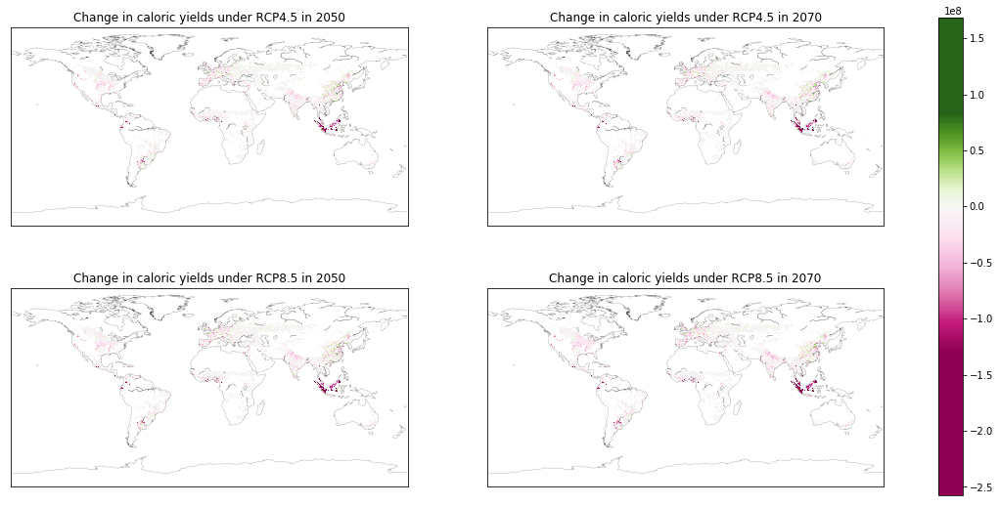

In [95]:
visualize_4_maps(compare_rcp45_2050['Δcal_per_ha'],
                 compare_rcp45_2070['Δcal_per_ha'],
                 compare_rcp85_2050['Δcal_per_ha'],
                 compare_rcp85_2070['Δcal_per_ha'],
                 #savefig='../ipbes_invest_crop_yield_project/output/Figures/XGB_Maps_Future_Climates.png',
                 colorscheme='diverging',resize=(-0.5,1.5),shape=(2160,4320))

In [83]:
# Total caloric yield changes (billion caloric per hectares) (I don't think this metric makes sense, summing yields...)
print(compare_rcp45_2050['Δcal_per_ha'].sum()/1e9)
print(compare_rcp45_2070['Δcal_per_ha'].sum()/1e9)
print(compare_rcp85_2050['Δcal_per_ha'].sum()/1e9)
print(compare_rcp85_2070['Δcal_per_ha'].sum()/1e9)
print('')

# Average local caloric yield changes 
print(compare_rcp45_2050['Δcal_per_ha'].mean())
print(compare_rcp45_2070['Δcal_per_ha'].mean())
print(compare_rcp85_2050['Δcal_per_ha'].mean())
print(compare_rcp85_2070['Δcal_per_ha'].mean())

print(compare_rcp45_2050['cal_per_ha 2000 measured'].mean())
print(compare_rcp45_2050['cal_per_ha 2000 predicted'].mean())

-4050.2642465691583
-4508.023744773996
-4485.1268967216265
-5456.269157366803

-6988962.037001393
-7778852.1676861765
-7739342.350038958
-9415103.727318507
28928528.398686193
31122796.067249082


# Fig 2 - XGB/Poly model performances

## Heatmaps

In [162]:
def make_heatmap(compare, kind='hex',savefig=False):
    ''' savefig = model_name 
        kind = hex, kde, ...
    '''
    if kind == 'hex':
        heatmap = sns.jointplot(x=compare['log(cal_per_ha)'],
                  y=compare['log(cal_per_ha) predicted'],
                  kind=kind, marginal_kws=dict(bins=30, rug=True));
    elif kind == 'kde':
        heatmap = sns.jointplot(x=compare['log(cal_per_ha)'],
                  y=compare['log(cal_per_ha) predicted'],
                  kind=kind, color="grey", space=0);

    heatmap.ax_joint.set_xlim((12,20));
    heatmap.ax_joint.set_ylim((12,20));

    x0, x1 = heatmap.ax_joint.get_xlim()
    y0, y1 = heatmap.ax_joint.get_ylim()

    lims = [max(x0, y0), min(x1, y1)]
    heatmap.ax_joint.plot(lims, lims, ':k');
    
    if savefig != False:
        heatmap.savefig('../ipbes_invest_crop_yield_project/output/Figures/Heatmap_'+savefig+'_'+kind+'.png')


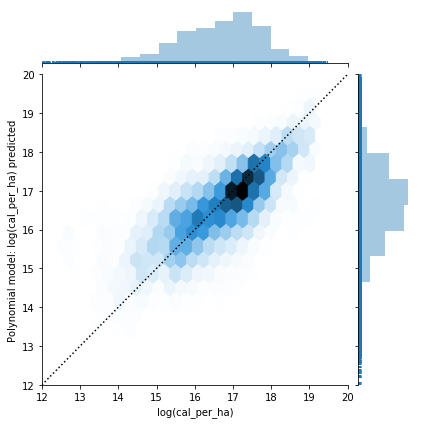

In [160]:
make_heatmap(compare_poly, kind='hex',savefig='Poly')

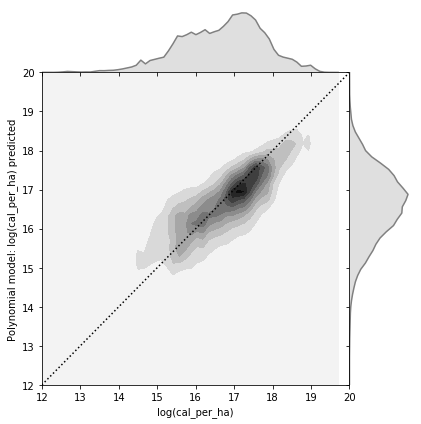

In [163]:
## /!\ 'kde' is looooong
make_heatmap(compare_poly, kind='kde',savefig='Poly')

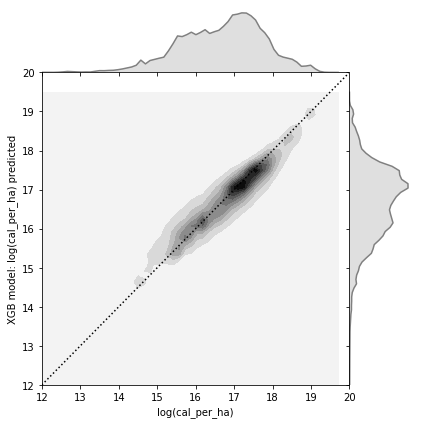

In [164]:
make_heatmap(compare_xgb, kind='kde',savefig='XGB')

## Scatterplots (old)

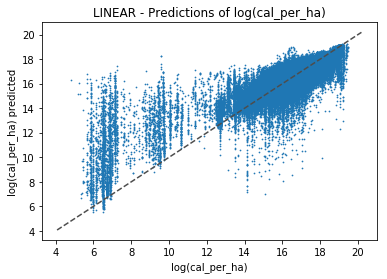

In [283]:
#Predictions of log(calories_per_ha)
ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='XGB - Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

#plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log--Linear_simplesubset.png')

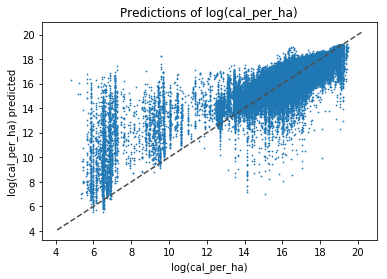

In [282]:
#Predictions of log(calories_per_ha)
ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");


#plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log--Linear_simplesubset.png')

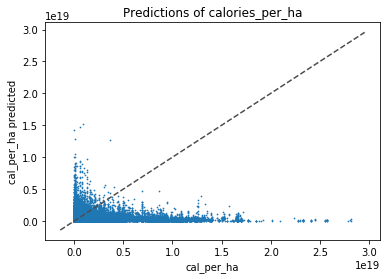

In [273]:
#Predictions of calories_per_ha
ax = compare.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title='Predictions of calories_per_ha');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

#plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted--Linear_simplesubset.png')

## Compare XGB/poly predictions

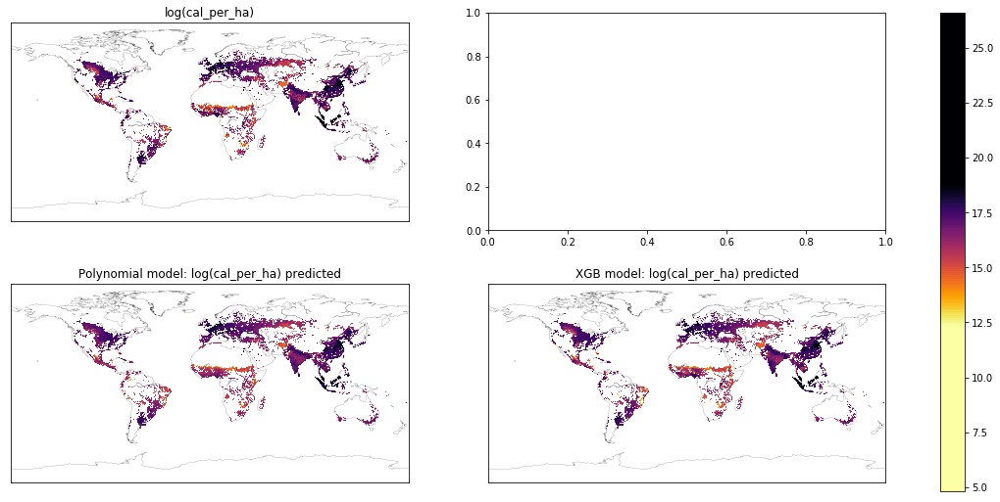

In [131]:
visualize_3_maps(compare_xgb['log(cal_per_ha)'],
                 compare_xgb['log(cal_per_ha) predicted'],
                 compare_poly['log(cal_per_ha) predicted'],
                 savefig='../ipbes_invest_crop_yield_project/output/Figures/Poly_XGB_pred_maps.png',
                 resize=(-3.5,2.2),
                 colorscheme='sequential')

In [118]:
# Colorscale values
np.exp(np.log(32))

32.0

In [114]:
np.log(500000000)

20.030118656386467

In [139]:
compare_poly['prediction error (log)'].name = 'Polynomial model : Prediction error'
compare_xgb['prediction error (log)'].name = 'XGB model : Prediction error'

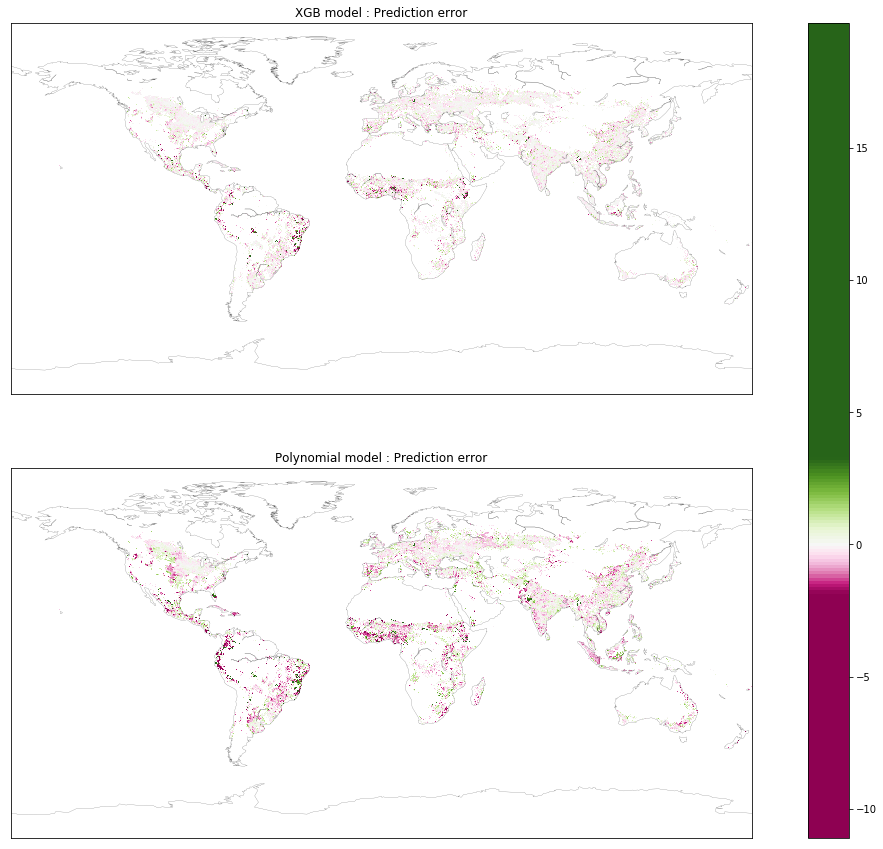

In [152]:
#old
visualize_two_maps(compare_xgb['prediction error (log)'],
                 compare_poly['prediction error (log)'],
                   savefig='../ipbes_invest_crop_yield_project/output/Figures/Poly_XGB_pred_err_maps_+.png',
                resize = (-2.5,3.5))

In [121]:
compare_poly['prediction diff (not log)'].name = 'Polynomial model : Prediction diff'
compare_xgb['prediction diff (not log)'].name = 'XGB model : Prediction diff'

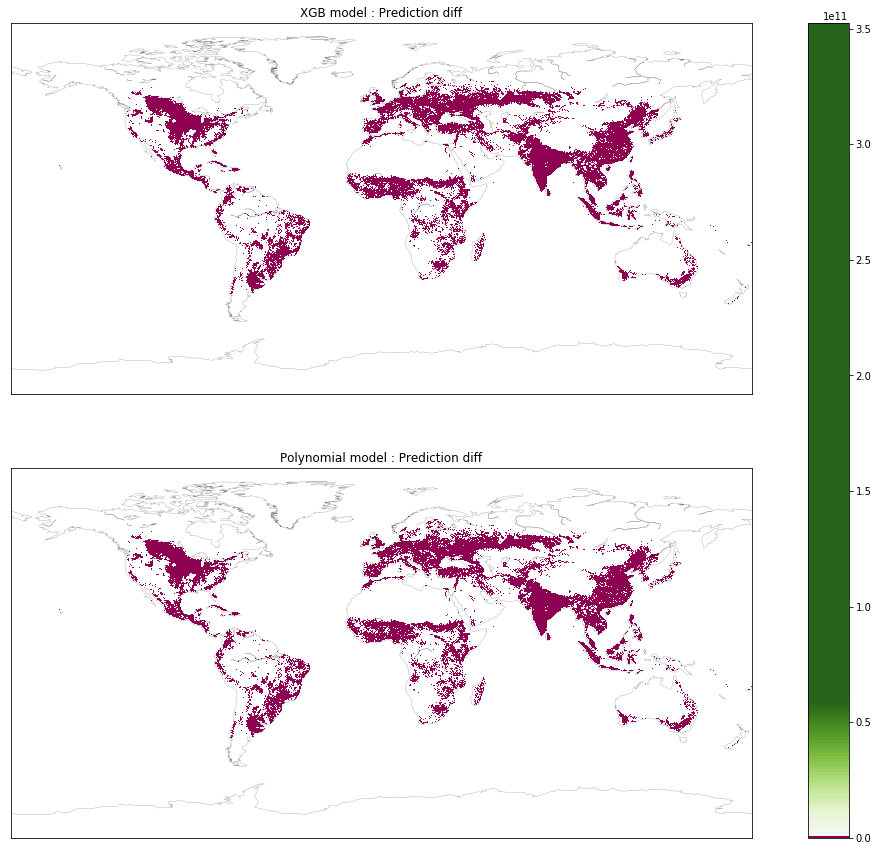

In [122]:
#
visualize_two_maps(compare_xgb['prediction diff (not log)'],
                 compare_poly['prediction diff (not log)'],
                   #savefig='../ipbes_invest_crop_yield_project/output/Figures/Poly_XGB_pred_err_maps_+.png',
                resize = (-2.5,3.5))

# Fig S1 : Compare xgb results for ≠ subsets

In [246]:
compare_xgb_simplesubset['prediction error (log)'].name = 'Subset of inputs - XGB model: Prediction error'

In [247]:
compare_xgb['prediction error (log)'].name = 'All inputs - XGB model: Prediction error'

In [248]:
compare_xgb_wo_latlon['prediction error (log)'].name = 'All inputs except lat/lon - XGB model: Prediction error'

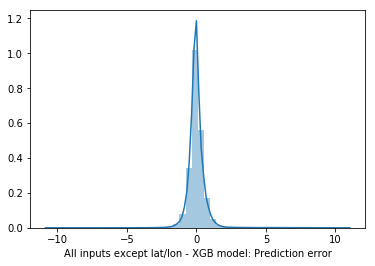

In [249]:
sns.distplot(compare_xgb_wo_latlon['prediction error (log)']);

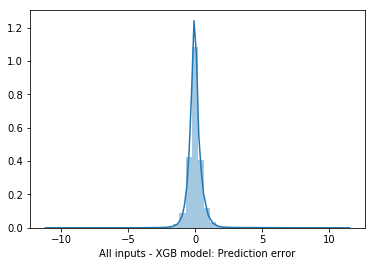

In [250]:
sns.distplot(compare_xgb['prediction error (log)']);

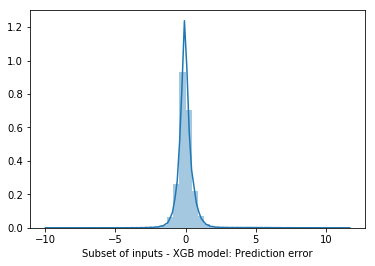

In [251]:
sns.distplot(compare_xgb_simplesubset['prediction error (log)']);

In [239]:
###Check my y values (first should be 17.116737) often -- looks like I change it BUG ! (Where??)
y

pixel_id
1090988    17.116737
1112598    17.461977
1121218    17.461977
1121236    17.461977
1181705    17.461977
1246474    17.392149
1272549    16.312744
1276867    16.889301
1276868    16.312744
1298466    15.518663
1298467    16.312744
1298473    16.495031
1298474    16.495031
1298485    16.495031
1298486    16.495031
1298487    17.337006
1302785    16.889301
1302786    17.714148
1302787    16.889301
1302788    15.518663
1302789    17.262501
1302790    17.262501
1302791    16.312744
1302794    16.495031
1302802    16.495031
1307103    17.262501
1307104    17.714148
1307105    17.714148
1307106    17.714148
1307107    17.714148
1307108    17.714148
1307109    16.889301
1307110    17.593639
1307111    17.714148
1307112    17.714148
1307113    17.337006
1307116    16.495031
1307117    15.884965
1307119    16.495031
1307137    16.495031
1311424    16.312744
1311425    16.312744
1311426    16.889301
1311427    17.262501
1311428    17.262501
1311429    16.312744
1311431    16.312744
1311

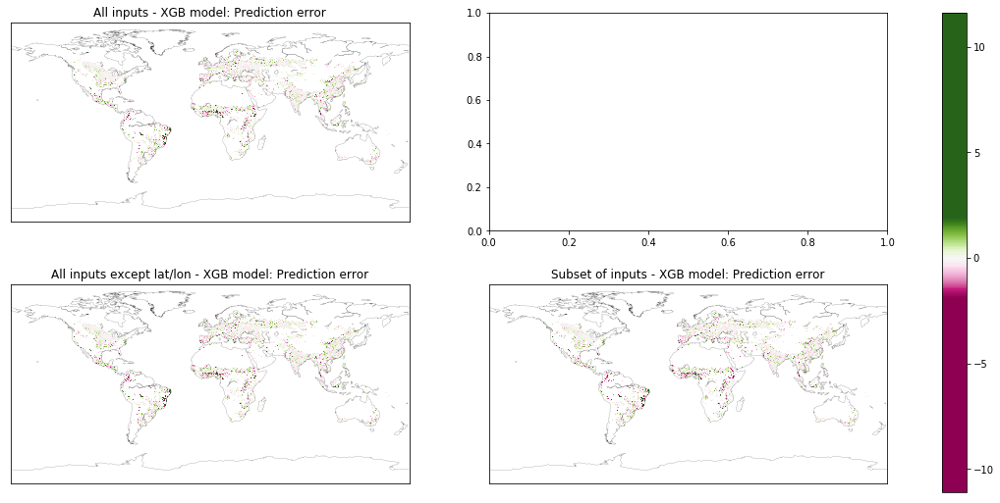

In [253]:
visualize_3_maps(compare_xgb['prediction error (log)'],
                 compare_xgb_simplesubset['prediction error (log)'],
                 compare_xgb_wo_latlon['prediction error (log)'],
                 savefig='../ipbes_invest_crop_yield_project/output/Figures/XGB_inputs_pred_err_maps+.png',
                 colorscheme='diverging',
                 resize=(-2.5,3.5),
                 shape=(2160,4320))


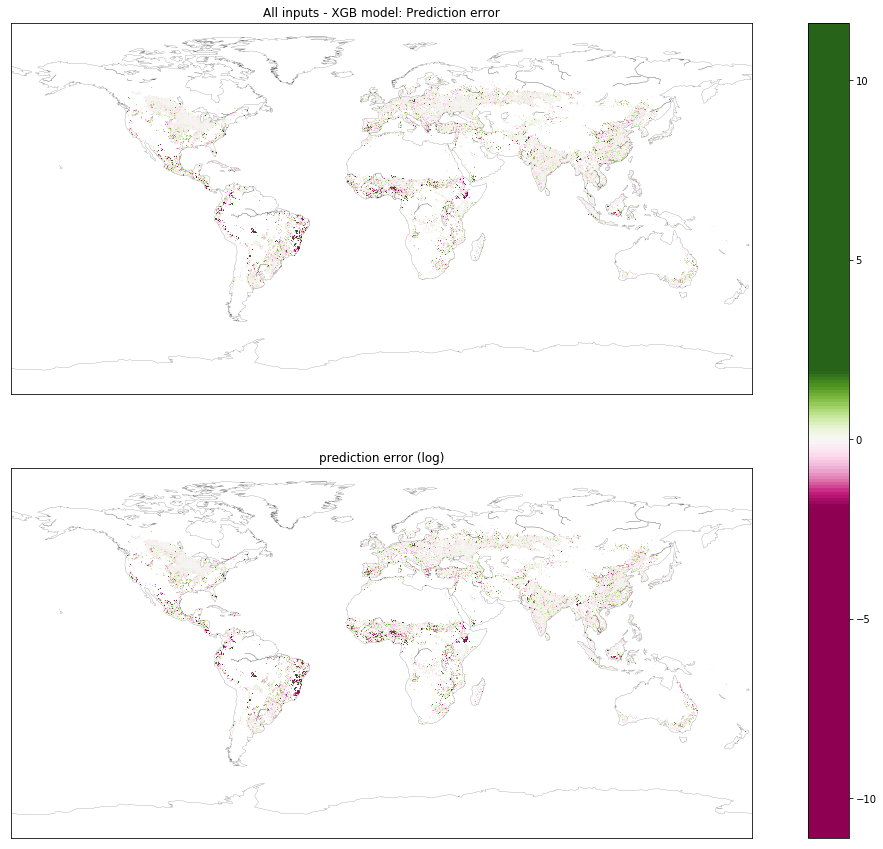

In [240]:
visualize_two_maps(compare_xgb['prediction error (log)'],
                 compare_xgb_simplesubset['prediction error (log)'],
                   #savefig='../ipbes_invest_crop_yield_project/output/Figures/Poly_XGB_pred_err_maps_+.png',
                resize = (-2.5,3.5))

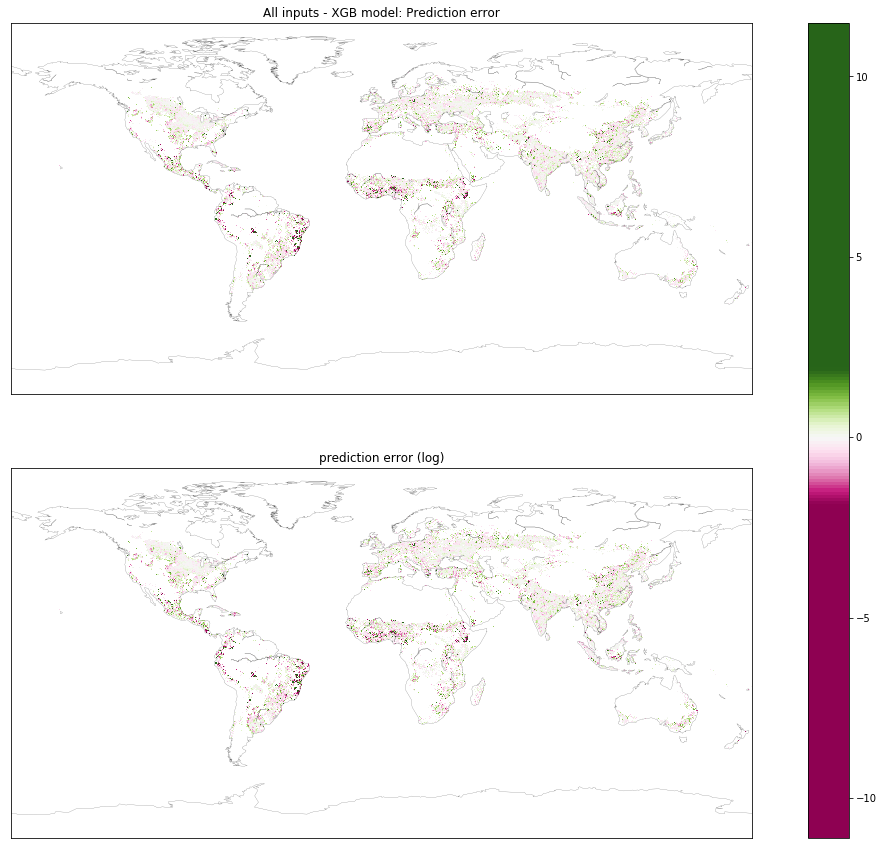

In [241]:
visualize_two_maps(compare_xgb['prediction error (log)'],
                 compare_xgb_wo_latlon['prediction error (log)'],
                   #savefig='../ipbes_invest_crop_yield_project/output/Figures/Poly_XGB_pred_err_maps_+.png',
                resize = (-2.5,3.5))

# Utilities: Visualization functions


## Export raster

In [190]:
def export_raster(df,col_name,savefig=False):
    
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    DF = df[col_name].reset_index()
    ### Merge with zeros_df to include non-ag pixels
    full_df = pd.merge(zeros_df, DF, left_index=True, right_on='pixel_id', how='outer')
    
    
    ### to do transform df to array to raster
    
    
    if savefig != False:
        print('d')#save raster at savefig location
    else:
        pass
    
    return full_df
    

In [278]:
match_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
match = gdal.Open(match_path)
gt =match.GetGeoTransform()
gt[1]
#ixelSizeY =-gt[5]
match.RasterYSize
match.RasterXSize

4320

In [191]:
full_df = export_raster(compare_poly,'log(cal_per_ha)')

In [198]:
values = full_df['log(cal_per_ha)'].as_matrix().reshape((2160, 4320)).astype(np.float32)

target_path = '../ipbes_invest_crop_yield_project/output/Figures/____Model_results/raster/test.tif'
x_pixels = 4320  # = match.RasterXSize
y_pixels = 2160  # = match.RasterYSize
driver = gdal.GetDriverByName('GTiff')
output = driver.Create(target_path,x_pixels, y_pixels, 1 ,gdal.GDT_Float32)
output.GetRasterBand(1).WriteArray(values)

match_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
match = gdal.Open(match_path)
proj = match.GetProjection()
geotrans = match.GetGeoTransform()
output.SetGeoTransform(geotrans)
output.SetProjection(proj)
output.FlushCache()
#output.GetRasterBand(1).SetNoDataValue(np.nan)
output=None

In [264]:
m = np.array([[1,2],[3,3],[99,99]])
m.shape

(3, 2)

In [244]:
#full_df = export_raster(compare,'log(cal_per_ha)')

values = full_df['log(cal_per_ha)'].as_matrix().reshape((2160, 4320)).astype(np.float32)
#values = full_df['log(cal_per_ha)'].as_matrix().astype(np.float32)

o= hb.new_raster_from_base(base_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif',
                        target_path = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/raster/test.tif',
                        datatype = gdal.GDT_Float32,
                        band_nodata_list=[None],
                        fill_value_list= values,
                        n_rows=None,
                        n_cols=None,
                        gtiff_creation_options=hb.DEFAULT_GTIFF_CREATION_OPTIONS)
#(2160, 4320)
#(9331200,)

TypeError: in method 'Band_Fill', argument 2 of type 'double'

In [227]:
from osgeo import gdal
gtif = gdal.Open( '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif')
print(gtif.GetMetadata)

<bound method MajorObject.GetMetadata of <osgeo.gdal.Dataset; proxy of <Swig Object of type 'GDALDatasetShadow *' at 0x1c260137b0> >>


In [228]:
fp = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
import rasterio
raster = rasterio.open(fp)
raster.meta

{'driver': 'GTiff',
 'dtype': 'float64',
 'nodata': -9999.0,
 'width': 4320,
 'height': 2160,
 'count': 1,
 'crs': CRS({'init': 'epsg:4326'}),
 'transform': (-179.99999491609228,
  0.08333333804392655,
  0.0,
  90.00000254430942,
  0.0,
  -0.0833333356891754),
 'affine': Affine(0.08333333804392655, 0.0, -179.99999491609228,
        0.0, -0.0833333356891754, 90.00000254430942)}

## Mapping functions

#### 3 and 4 maps

In [28]:
## Geographical visualization function
def visualize_two_maps(serie1, serie2,
                     savefig=False,colorscheme='diverging',
                     resize=False,
                     shape=(2160,4320)):

    fig, axes = plt.subplots(2, 1, figsize=(20,15))
    
    # Define global vmin and vmax
    vmax = max(serie1.max(),serie2.max())
    vmin = min(serie1.min(),serie2.min())
    
    # -- Prepare data --
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    
    ### Merge with zeros_df to include non-ag pixels
    full_df1 = pd.merge(zeros_df, serie1.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    full_df2 = pd.merge(zeros_df, serie2.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    
    ## -- Plot columns --
    
    #Colorscale
    if colorscheme == 'diverging':
        raw_cmap =  plt.get_cmap('PiYG')
        cmap = customColorMap_v(raw_cmap, vmin, vmax,#serie1, serie2, serie3, ### Cleaner option: woudl take vmin, vmax as args instead of series
                                    resize=resize)
    elif colorscheme == 'sequential':
        raw_cmap = plt.get_cmap('inferno_r') #alternatively 'magma'
        cmap = customColorMap_v(raw_cmap, vmin, vmax,#serie1, serie2, serie3,
                                    resize=resize)
    else:
        print('Wrong colorscheme')
    
    
    #Plot data
    data = np.array(full_df1[full_df1.columns[-1]])
    bm = Basemap(ax=axes[0])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[0].set_title(serie1.name)

    data = np.array(full_df2[full_df2.columns[-1]])
    bm = Basemap(ax=axes[1])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[1].set_title(serie2.name)
    
    #cbar = plt.colorbar(im, orientation='vertical',fraction=0.0234, pad=0.04)
    
    fig.colorbar(im, ax=axes.ravel().tolist())
    #Or:
    #cax,kw = mpl.colorbar.make_axes([ax for ax in axes.flat])
    #plt.colorbar(im, cax=cax, **kw)
  
    if savefig != False:
        fig.savefig(savefig,dpi=300)
        
   #if colorscheme != cmap:    
   #     return cmap


In [29]:
## Geographical visualization function
def visualize_3_maps(serie1, serie2, serie3,
                     savefig=False,colorscheme='diverging',
                     resize=False,
                     shape=(2160,4320)):

    fig, axes = plt.subplots(2, 2, figsize=(20,9))
    
    # Define global vmin and vmax
    vmax = max(serie1.max(),serie2.max(),serie3.max())
    vmin = min(serie1.min(),serie2.min(),serie3.min())

    # -- Prepare data --
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    
    ### Merge with zeros_df to include non-ag pixels
    full_df1 = pd.merge(zeros_df, serie1.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    full_df2 = pd.merge(zeros_df, serie2.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    full_df3 = pd.merge(zeros_df, serie3.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    
    ## -- Plot columns --
    
    #Colorscale
    if colorscheme == 'diverging':
        raw_cmap =  plt.get_cmap('PiYG')
        cmap = customColorMap_v(raw_cmap, vmin, vmax,#serie1, serie2, serie3, ### Cleaner option: woudl take vmin, vmax as args instead of series
                                    resize=resize)
    elif colorscheme == 'sequential':
        raw_cmap = plt.get_cmap('inferno_r') #alternatively 'magma'
        cmap = customColorMap_v(raw_cmap, vmin, vmax,#serie1, serie2, serie3,
                                    resize=resize)
    else:
        print('Wrong colorscheme')
    
    
    #Plot data
    data = np.array(full_df1[full_df1.columns[-1]])
    bm = Basemap(ax=axes[0,0])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[0,0].set_title(serie1.name)

    data = np.array(full_df2[full_df2.columns[-1]])
    bm = Basemap(ax=axes[1,1])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[1,1].set_title(serie2.name)

    data = np.array(full_df3[full_df3.columns[-1]])
    bm = Basemap(ax=axes[1,0])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[1,0].set_title(serie3.name)
    
    #cbar = plt.colorbar(im, orientation='vertical',fraction=0.0234, pad=0.04)
    
    fig.colorbar(im, ax=axes.ravel().tolist())
    #Or:
    #cax,kw = mpl.colorbar.make_axes([ax for ax in axes.flat])
    #plt.colorbar(im, cax=cax, **kw)
  
    if savefig != False:
        fig.savefig(savefig,dpi=300)
        
   #if colorscheme != cmap:    
   #     return cmap


In [30]:
## Geographical visualization function
def visualize_4_maps(serie1, serie2, serie3,serie4,
                     savefig=False,colorscheme='diverging',
                     resize=False,
                     shape=(2160,4320)):

    fig, axes = plt.subplots(2, 2, figsize=(20,9))
    
    # Define global vmin and vmax
    vmax = max(serie1.max(),serie2.max(),serie3.max(),serie4.max())
    vmin = min(serie1.min(),serie2.min(),serie3.min(),serie4.min())

    # -- Prepare data --
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    
    ### Merge with zeros_df to include non-ag pixels
    full_df1 = pd.merge(zeros_df, serie1.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    full_df2 = pd.merge(zeros_df, serie2.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    full_df3 = pd.merge(zeros_df, serie3.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    full_df4 = pd.merge(zeros_df, serie4.reset_index(), left_index=True, right_on='pixel_id', how='outer')
    
    ## -- Plot columns --
    
    #Colorscale
    if colorscheme == 'diverging':
        raw_cmap =  plt.get_cmap('PiYG')
        cmap = customColorMap_v(raw_cmap, vmin, vmax,#serie1, serie2, serie3, ### Cleaner option: woudl take vmin, vmax as args instead of series
                                    resize=resize)
    elif colorscheme == 'sequential':
        raw_cmap = plt.get_cmap('inferno_r') #alternatively 'magma'
        cmap = customColorMap_v(raw_cmap, vmin, vmax,#serie1, serie2, serie3,
                                    resize=resize)
    else:
        print('Wrong colorscheme')
    
    
    #Plot data
    data = np.array(full_df1[full_df1.columns[-1]])
    bm = Basemap(ax=axes[0,0])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[0,0].set_title(serie1.name)

    data = np.array(full_df2[full_df2.columns[-1]])
    bm = Basemap(ax=axes[0,1])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[0,1].set_title(serie2.name)

    data = np.array(full_df3[full_df3.columns[-1]])
    bm = Basemap(ax=axes[1,0])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[1,0].set_title(serie3.name)
    
    data = np.array(full_df4[full_df4.columns[-1]])
    bm = Basemap(ax=axes[1,1])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[1,1].set_title(serie4.name)
    
    #cbar = plt.colorbar(im, orientation='vertical',fraction=0.0234, pad=0.04)
    
    fig.colorbar(im, ax=axes.ravel().tolist())
    #Or:
    #cax,kw = mpl.colorbar.make_axes([ax for ax in axes.flat])
    #plt.colorbar(im, cax=cax, **kw)
  
    if savefig != False:
        fig.savefig(savefig,dpi=300)
        
   #if colorscheme != cmap:    
   #     return cmap


In [31]:
def customColorMap_v(cmap, vmin, vmax, resize=False, name='blabla'):
    '''Charlie's function to re-center and re-size colormap'''

    midpoint= 1 - vmax / (vmax + abs(vmin))
    
    if resize!=False: 
        start=resize[0]
        stop =resize[1]
        ### Could do directly with quantiles e.g  start = 1 / (serie.quantile(0.1) / serie.min() )
        ### And stop =  1 / (serie.quantile(0.9) / serie.max() )
    else:
        start = 0
        stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

#### 2 maps

In [32]:
## Geographical visualization function
def visualize_2_maps(df,col_name1,col_name2,
                     savefig=False,colorscheme='diverging',
                     resize=False,
                     shape=(2160,4320)):

    fig, axes = plt.subplots(2, 1, figsize=(20,15))

    # -- Prepare data --
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    
    DF1 = df[col_name1].reset_index()
    DF2 = df[col_name2].reset_index()
    ### Merge with zeros_df to include non-ag pixels
    full_df1 = pd.merge(zeros_df, DF1, left_index=True, right_on='pixel_id', how='outer')
    full_df2 = pd.merge(zeros_df, DF2, left_index=True, right_on='pixel_id', how='outer')
    
    ## -- Plot column --
    
    #Colorscale
    if colorscheme == 'diverging':
        raw_cmap =  plt.get_cmap('PiYG')
        cmap = customColorMap_2maps(raw_cmap, full_df1[col_name1],full_df2[col_name2],resize=resize)
    elif colorscheme == 'sequential':
        raw_cmap = plt.get_cmap('inferno_r') #alternatively 'magma'
        cmap = customColorMap_2maps(raw_cmap, full_df1[col_name1],full_df2[col_name2],resize=resize)
    #else:
        #cmap = replicateColorMap(colorscheme,vmin=14.022869333967861,vmax=19.24083736317894)
        
    
    #let's see
    serie1 = full_df1[col_name1]
    serie2 = full_df2[col_name2]
    vmax1 = serie1.max()
    vmin1 = serie1.min()
    vmax2 = serie2.max()
    vmin2 = serie2.min()
    vmax = max(vmax1,vmax2)
    vmin = min(vmin1,vmin2)
    
    
    #Plot data
    data = np.array(full_df1[col_name1])
    bm = Basemap(ax=axes[0])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[0].set_title(col_name1)

    
    data = np.array(full_df2[col_name2])
    bm = Basemap(ax=axes[1])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[1].set_title(col_name2)

    
    #cbar = plt.colorbar(im, orientation='vertical',fraction=0.0234, pad=0.04)
    
    fig.colorbar(im, ax=axes.ravel().tolist())
    #Or:
    #cax,kw = mpl.colorbar.make_axes([ax for ax in axes.flat])
    #plt.colorbar(im, cax=cax, **kw)
  
    if savefig != False:
        fig.savefig(savefig)
        
   #if colorscheme != cmap:    
   #     return cmap


In [33]:
def customColorMap_2maps(cmap, serie1, serie2, resize=False, name='blabla'):
    '''Charlie's function to re-center and re-size colormap'''
    
    vmax1 = serie1.max()
    vmin1 = serie1.min()
    vmax2 = serie2.max()
    vmin2 = serie2.min()
    vmax = max(vmax1,vmax2)
    vmin = min(vmin1,vmin2)
    midpoint= 1 - vmax / (vmax + abs(vmin))
    
    if resize!=False: 
        start=resize[0]
        stop =resize[1]
        ### Could do directly with quantiles e.g  start = 1 / (serie.quantile(0.1) / serie.min() )
        ### And stop =  1 / (serie.quantile(0.9) / serie.max() )
    else:
        start = 0
        stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

#### One map save , vmin, vmax, midpoint..

In [34]:
## Geographical visualization function
def visualize_data(df,col_name,savefig=False,colorscheme='diverging',
                   vminmax=False,savecmap=False,
                   shape=(2160,4320),title=None,resize=False):

    
    fig,axes = plt.subplots(1, 1, figsize=(20,15))

    # -- Prepare data --
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    DF = df[col_name].reset_index()
    ### Merge with zeros_df to include non-ag pixels
    full_df = pd.merge(zeros_df, DF, left_index=True, right_on='pixel_id', how='outer')
    
    ## -- Plot column --
    
    #Colorscale
    if vminmax==False:
        serie = df[col_name]
        vmax = serie.max()
        vmin = serie.min()
    else:
        vmin = vminmax[0]
        vmax = vminmax[1]
    
    if colorscheme == 'diverging':
        raw_cmap =  plt.get_cmap('PiYG')
        cmap = customColorMap(raw_cmap, vmin, vmax, resize)
    elif colorscheme == 'sequential':
        raw_cmap = plt.get_cmap('inferno_r') #alternatively 'magma'
        cmap = customColorMap(raw_cmap, vmin, vmax, resize)
    #else:
        #cmap = replicateColorMap(colorscheme,vmin=14.022869333967861,vmax=19.24083736317894)
        
    
    
    
    #Plot data
    data = np.array(full_df[col_name])
    bm = Basemap()
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    
    cbar = plt.colorbar(im, orientation='vertical',fraction=0.0234, pad=0.04)
    
    if title == None:
        plt.title(col_name)
    else:
        plt.title(title)
    plt.show()
  
    if savefig != False:
        fig.savefig(savefig)
        
        
    if savecmap == True:
        return (vmin, vmax), resize
        
   #if colorscheme != cmap:    
   #     return cmap
    


In [35]:
def customColorMap(cmap, vmin, vmax, resize=False, name='blabla'):
    '''Charlie's function to re-center and re-size colormap'''
    
    midpoint= 1 - vmax / (vmax + abs(vmin)) 
    
    if resize!=False: 
        start=resize[0]
        stop =resize[1]
        ### Could do directly with quantiles e.g  start = 1 / (serie.quantile(0.1) / serie.min() )
        ### And stop =  1 / (serie.quantile(0.9) / serie.max() )
    else:
        start = 0
        stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)
    
    return newcmap#, vmin, vmax, midpoint

#### One map simple

In [111]:
## Geographical visualization function
def visualize_data(df,col_name,savefig=False,colorscheme='diverging',
                   shape=(2160,4320),title=None,resize=False):

    
    fig,axes = plt.subplots(1, 1, figsize=(20,15))

    # -- Prepare data --
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    DF = df[col_name].reset_index()
    ### Merge with zeros_df to include non-ag pixels
    full_df = pd.merge(zeros_df, DF, left_index=True, right_on='pixel_id', how='outer')
    
    ## -- Plot column --
    
    #Colorscale
    if colorscheme == 'diverging':
        raw_cmap =  plt.get_cmap('PiYG')
        cmap = customColorMap(raw_cmap, full_df[col_name],resize)
    elif colorscheme == 'sequential':
        raw_cmap = plt.get_cmap('inferno_r') #alternatively 'magma'
        cmap = customColorMap(raw_cmap, full_df[col_name],resize)
    #else:
        #cmap = replicateColorMap(colorscheme,vmin=14.022869333967861,vmax=19.24083736317894)
        
    
    
    
    #Plot data
    data = np.array(full_df[col_name])
    bm = Basemap(zoom=2)
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    
    cbar = plt.colorbar(im, orientation='vertical',fraction=0.0234, pad=0.04)
    
    if title == None:
        plt.title(col_name)
    else:
        plt.title(title)
    plt.show()
  
    if savefig != False:
        fig.savefig(savefig)
        
   #if colorscheme != cmap:    
   #     return cmap

def customColorMap(cmap, serie, resize=False, name='blabla'):
    '''Charlie's function to re-center and re-size colormap'''
    
    vmax = serie.max()
    vmin = serie.min()
    midpoint= 1 - vmax / (vmax + abs(vmin))
    print(vmin,vmax,midpoint)
    
    
    if resize!=False: 
        start=resize[0]
        stop =resize[1]
        ### Could do directly with quantiles e.g  start = 1 / (serie.quantile(0.1) / serie.min() )
        ### And stop =  1 / (serie.quantile(0.9) / serie.max() )
    else:
        start = 0
        stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

In [166]:
def customColorMap(cmap, serie, resize=False, name='blabla'):
    '''Charlie's function to re-center and re-size colormap'''
    
    vmax = serie.max()
    vmin = serie.min()
    midpoint= 1 - vmax / (vmax + abs(vmin))
    print(vmin,vmax,midpoint)
    
    
    if resize!=False: 
        start=resize[0]
        stop =resize[1]
        ### Could do directly with quantiles e.g  start = 1 / (serie.quantile(0.1) / serie.min() )
        ### And stop =  1 / (serie.quantile(0.9) / serie.max() )
    else:
        start = 0
        stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

In [27]:
### Problem : The colorscale is not the same for all the plots !!! 

## cmap is actually just a colormap from 0 to 1 - it doesn't map to values in the cmap itself.

## Tried adding CMAP = visualize_data()
## and at the end of the visualize_data function:
   #if colorscheme != cmap:    
   #     return cmap

def replicateColorMap(cmap, vmin, vmax, name='Prout'):
    '''Charlie's function to re-center and re-size colormap'''

    midpoint= 1 - vmax / (vmax + abs(vmin))
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    start = 0
    stop  = 1
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

In [ ]:
# Visualize predicted results with new climates_csv_

#Df with new climate:
X_rcp = baseline_df_climateRCP


log_calperha_rcp = reg.predict(X_rcp)
calperha_rcp = pow(10,log_calperha_rcp)
add calperha_rcp col to baseline_df_climateRCP

visualize_data(calperha_rcp,DF=df_land)


#### Improving customColorMap to shrink/widen the colorscale so outliers are not colors extrema

In [359]:
from mpl_toolkits.axes_grid1 import AxesGrid

def customColorMap(cmap, serie, start=0,stop=1, name='my_cmap'):
    '''
    Function to offset the "center" of a colormap. Useful for
    data with a negative min and positive max and you want the
    middle of the colormap's dynamic range to be at zero.

    Input
    -----
      cmap : The matplotlib colormap to be altered
      start : Offset from lowest point in the colormap's range.
          Defaults to 0.0 (no lower offset). Should be between
          0.0 and `midpoint`.
      midpoint : The new center of the colormap. Defaults to 
          0.5 (no shift). Should be between 0.0 and 1.0. In
          general, this should be  1 - vmax / (vmax + abs(vmin))
          For example if your data range from -15.0 to +5.0 and
          you want the center of the colormap at 0.0, `midpoint`
          should be set to  1 - 5/(5 + 15)) or 0.75
      stop : Offset from highest point in the colormap's range.
          Defaults to 1.0 (no upper offset). Should be between
          `midpoint` and 1.0.
    '''
    
    vmax = serie.max()
    vmin = serie.min()
    midpoint= 1 - vmax / (vmax + abs(vmin))
    
    #if resize==True:
    #    start = 1 / (serie.quantile(0.1) / serie.min() )
    #    stop =  1 / (serie.quantile(0.9) / serie.max() )
    #else:
    #   start = 0
    #   stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

In [ ]:
to_modify = [5,4,3,2,1,0]
indexes = [0,1,3,5]
replacements = [0,0,0,0]

for index in indexes:
    to_modify[indexes[index]] = replacements[index]

In [385]:
s = pd.Series(biased_data.reshape(37*37))
s.describe()

count    1369.000000
mean       -6.405405
std        70.674042
min     -2550.000000
25%       -10.000000
50%        -5.000000
75%         0.000000
max       550.000000
dtype: float64

In [388]:
for interpolation in ['linear', 'lower', 'higher','midpoint','nearest']:
    print(s.quantile(0.5,interpolation=interpolation) )

-5.0
-5
-5
-5.0
-5


In [391]:
print(np.percentile(biased_data,0.15) ) 

-15.0


In [ ]:
outliers 
 = None --> 0,1
 = --> 

In [404]:
print(np.percentile(biased_data,95) ) 
print(np.percentile(biased_data,90) ) 
print(np.percentile(biased_data,10) ) 
print(np.percentile(biased_data,5) ) 
print(biased_data.max() ) 
print(biased_data.min() )

a = np.percentile(biased_data,5) / biased_data.min()
    
b = np.percentile(biased_data,95) / biased_data.max()
print(1/a)
print(1/b)


4.0
3.0
-13.0
-14.0
550
-2550
182.14285714285714
137.5


/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/ipykernel/__main__.py:1: DeprecationWarning: This function is deprecated. Please call randint(-15, 5 + 1) instead
  if __name__ == '__main__':


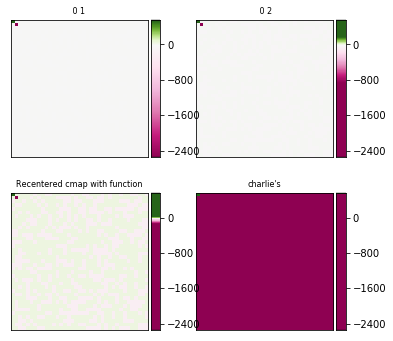

In [405]:
biased_data = np.random.random_integers(low=-15, high=5, size=(37,37))
biased_data[0,0]  = 550
biased_data[1,1]  = -2550

orig_cmap = plt.get_cmap('PiYG')

small = 1/(np.percentile(biased_data,5) / biased_data.min())
big = 1/np.percentile(biased_data,95) / biased_data.max()

cmap1 = customColorMap(orig_cmap, biased_data, start=0, stop=1)
cmap2 = customColorMap(orig_cmap, biased_data, start=-1, stop=2)
cmap3 = customColorMap(orig_cmap, biased_data, start=-10, stop=11)
cmap4 = customColorMap(orig_cmap, biased_data, start=0-small, stop=1+big)
#my_cmap = customColorMap(orig_cmap, biased_data, name='my_cmap')
#shrunk_cmap = shiftedColorMap(orig_cmap, start=0.15, midpoint=0.75, stop=0.85, name='shrunk')


fig = plt.figure(figsize=(6,6))
grid = AxesGrid(fig, 111, nrows_ncols=(2, 2), axes_pad=0.5,
                label_mode="1", share_all=True,
                cbar_location="right", cbar_mode="each",
                cbar_size="7%", cbar_pad="2%")

# normal cmap
im0 = grid[0].imshow(biased_data, interpolation="none", cmap=cmap1)
grid.cbar_axes[0].colorbar(im0)
grid[0].set_title(' 0 1 ', fontsize=8)

im1 = grid[1].imshow(biased_data, interpolation="none", cmap=cmap2)
grid.cbar_axes[1].colorbar(im1)
grid[1].set_title(' 0 2', fontsize=8)

im2 = grid[2].imshow(biased_data, interpolation="none", cmap=cmap3)
grid.cbar_axes[2].colorbar(im2)
grid[2].set_title('Recentered cmap with function', fontsize=8)

im3 = grid[3].imshow(biased_data, interpolation="none", cmap=cmap4)
grid.cbar_axes[3].colorbar(im3)
grid[3].set_title("charlie's", fontsize=8)

for ax in grid:
    ax.set_yticks([])
    ax.set_xticks([])

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/ipykernel/__main__.py:1: DeprecationWarning: This function is deprecated. Please call randint(-15, 5 + 1) instead
  if __name__ == '__main__':


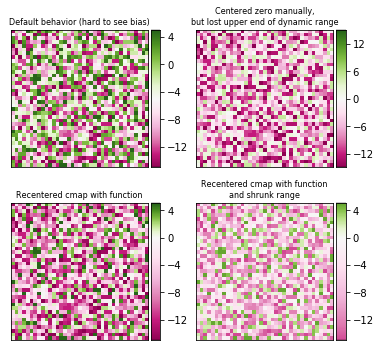

In [247]:
biased_data = np.random.random_integers(low=-15, high=5, size=(37,37))

orig_cmap = plt.get_cmap('PiYG')

shifted_cmap = shiftedColorMap(orig_cmap, midpoint=0.75, name='shifted')
shrunk_cmap = shiftedColorMap(orig_cmap, start=0.15, midpoint=0.75, stop=0.85, name='shrunk')

fig = plt.figure(figsize=(6,6))
grid = AxesGrid(fig, 111, nrows_ncols=(2, 2), axes_pad=0.5,
                label_mode="1", share_all=True,
                cbar_location="right", cbar_mode="each",
                cbar_size="7%", cbar_pad="2%")

# normal cmap
im0 = grid[0].imshow(biased_data, interpolation="none", cmap=orig_cmap)
grid.cbar_axes[0].colorbar(im0)
grid[0].set_title('Default behavior (hard to see bias)', fontsize=8)

im1 = grid[1].imshow(biased_data, interpolation="none", cmap=orig_cmap, vmax=15, vmin=-15)
grid.cbar_axes[1].colorbar(im1)
grid[1].set_title('Centered zero manually,\nbut lost upper end of dynamic range', fontsize=8)

im2 = grid[2].imshow(biased_data, interpolation="none", cmap=shifted_cmap)
grid.cbar_axes[2].colorbar(im2)
grid[2].set_title('Recentered cmap with function', fontsize=8)

im3 = grid[3].imshow(biased_data, interpolation="none", cmap=shrunk_cmap)
grid.cbar_axes[3].colorbar(im3)
grid[3].set_title('Recentered cmap with function\nand shrunk range', fontsize=8)

for ax in grid:
    ax.set_yticks([])
    ax.set_xticks([])

In [245]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid

def shiftedColorMap(cmap, start=0, midpoint=0.5, stop=1.0, name='shiftedcmap'):
    '''
    Function to offset the "center" of a colormap. Useful for
    data with a negative min and positive max and you want the
    middle of the colormap's dynamic range to be at zero.

    Input
    -----
      cmap : The matplotlib colormap to be altered
      start : Offset from lowest point in the colormap's range.
          Defaults to 0.0 (no lower offset). Should be between
          0.0 and `midpoint`.
      midpoint : The new center of the colormap. Defaults to 
          0.5 (no shift). Should be between 0.0 and 1.0. In
          general, this should be  1 - vmax / (vmax + abs(vmin))
          For example if your data range from -15.0 to +5.0 and
          you want the center of the colormap at 0.0, `midpoint`
          should be set to  1 - 5/(5 + 15)) or 0.75
      stop : Offset from highest point in the colormap's range.
          Defaults to 1.0 (no upper offset). Should be between
          `midpoint` and 1.0.
    '''
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

## Scatterplots (R2 by num_features)

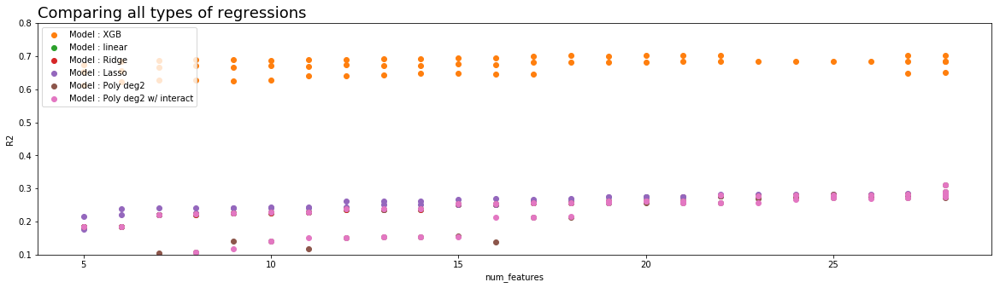

In [101]:
plot_R2_2params('num_features','Model',results_all,
                scatter=True,ylim=(0.10,0.8),
               title = 'Comparing all types of regressions',
               figsize = (20,5),
               color_palette = 'tab10')


# Several values for same model, same ≠ of features because different options (e.g different parameters alpha for Lasso,
# different subset of data for Poly: RFE vs. RFE BUT climzones.)


In [13]:
## Compare models by R2 scores

def plot_R2_2params(param_x, param_color, xgb_tuning,scatter=False,
                    ylim=None,title=None,figsize=(20,5),color_palette='Dark2'):

    fig, ax = plt.subplots(figsize=figsize)


    palette = plt.get_cmap(color_palette)
    num=0
    for param_color_value in xgb_tuning[param_color].unique():
        num+=1
        x = (xgb_tuning[xgb_tuning[param_color]==param_color_value][param_x])
        y = (xgb_tuning[xgb_tuning[param_color]==param_color_value]['R2'])
        #labels= (xgb_tuning[xgb_tuning[param_color]==learning_rate][param_color])
        if scatter == False:
            P = plt.plot(x,y, marker='.',color=palette(num), linewidth=2, alpha=0.9,
                 label=(str(param_color)+' : ' +str(param_color_value)))
        if scatter == True:
            P = plt.scatter(x,y, marker='o',color=palette(num),
                 label=(str(param_color)+' : ' +str(param_color_value)))
        
    plt.legend(loc=2, ncol=1)
    
    if title == None:
        title = "Comparing models by "+ param_x +" and "+ param_color
    plt.title(title, loc='left', fontsize=18, fontweight=0, color='black')

    plt.xlabel(param_x)
    plt.ylabel("R2")
    
    # Y lim
    if ylim != None:
        if scatter == False:
            P[0].axes.set_ylim(ylim)
        if scatter == True:
            P.axes.set_ylim(ylim)

In [33]:
# Subset of columns chosen to be metrics easily available for 2050.
# Soil : chosen "'workability_index'" because most often chosen among soil variables by RFE

simple_subset_cols = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'log_gpw_population',
                  'temp_avg','precip',
                  'calories_per_ha']

simple_subset_cols_gdp = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'gdp','log_gdp_per_capita','log_gpw_population'
                  'temp_avg','precip',
                  'calories_per_ha']

## heatmap examples

In [84]:
def make_heatmap(compare,title=None):
    x = compare['log(cal_per_ha)']
    y = compare['log(cal_per_ha) predicted']

    fig,ax = plt.subplots(1,1,figsize=(10,10))

    heatmap, xedges, yedges = np.histogram2d(x, y, bins=400)
    upper = max(xedges[-1],yedges[-1])
    lower = min(xedges[0],yedges[0])
    extent = [lower, upper, lower, upper]

    hm = plt.imshow(heatmap.T, extent=extent, origin='lower',cmap='gist_earth_r') #transparence = beaucoup !!
    cbar = plt.colorbar(hm, orientation='vertical')#,fraction=0.0234, pad=0.04)

    line = ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3",color='black',linewidth=1);

    if title != None:
        plt.title(title)
    plt.show()

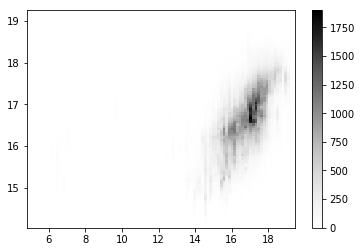

In [101]:
plt.hist2d(x=compare_lr['log(cal_per_ha)'], y=compare_lr['log(cal_per_ha) predicted'], bins=(100, 100),cmap=plt.cm.Greys);
plt.colorbar()

In [90]:
compare_lr.head()

,log(cal_per_ha),log(cal_per_ha) predicted,cal_per_ha,cal_per_ha predicted,prediction error (log),prediction diff (not log)
pixel_id,,,,,,
1090988,17.116737,17.295717,1.308389e+17,1.975681e+17,0.178980,6.672926e+16
1112598,17.461977,17.297556,2.897192e+17,1.984067e+17,-0.164421,-9.131251e+16
1121218,17.461977,17.298954,2.897192e+17,1.990463e+17,-0.163023,-9.067290e+16
1121236,17.461977,16.881792,2.897192e+17,7.617143e+16,-0.580185,-2.135478e+17
1181705,17.461977,17.096620,2.897192e+17,1.249166e+17,-0.365357,-1.648026e+17


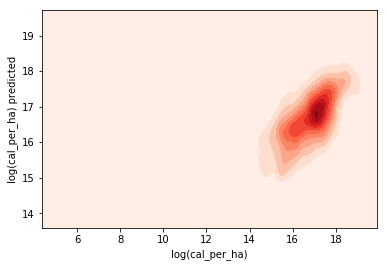

In [113]:
sns.kdeplot(compare_lr['log(cal_per_ha)'], compare_lr['log(cal_per_ha) predicted'], cmap="Reds", shade=True, bw=.15)

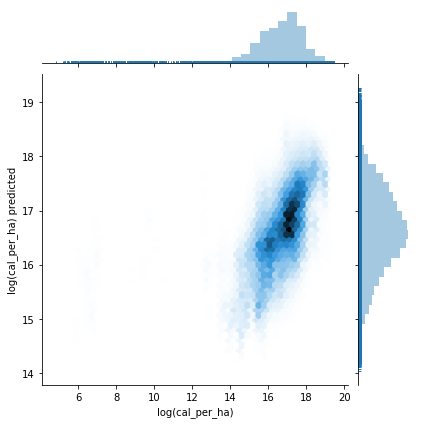

In [97]:
sns.jointplot(x=compare_lr['log(cal_per_ha)'], y=compare_lr['log(cal_per_ha) predicted'], kind='hex', marginal_kws=dict(bins=30, rug=True))

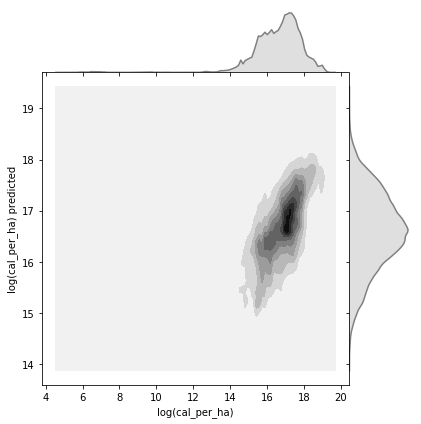

In [96]:
sns.jointplot(x=compare_lr['log(cal_per_ha)'],
              y=compare_lr['log(cal_per_ha) predicted'],
              kind='kde', color="grey", space=0)

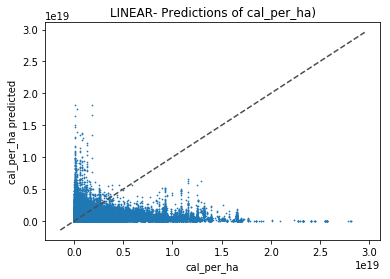

In [93]:
ax = compare_lr.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title='LINEAR- Predictions of cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


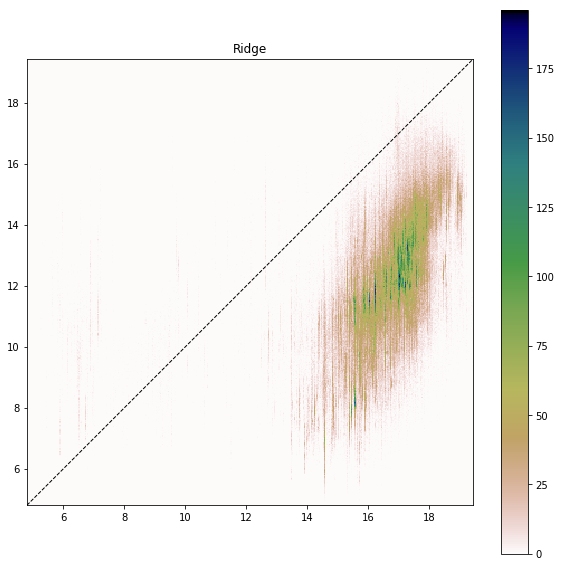

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


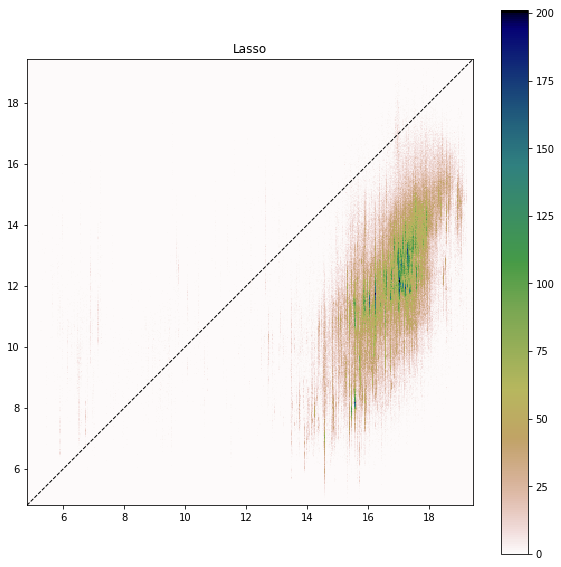

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


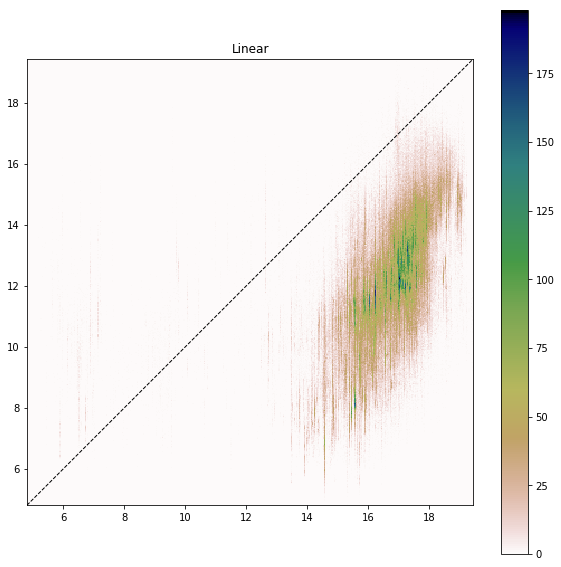

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


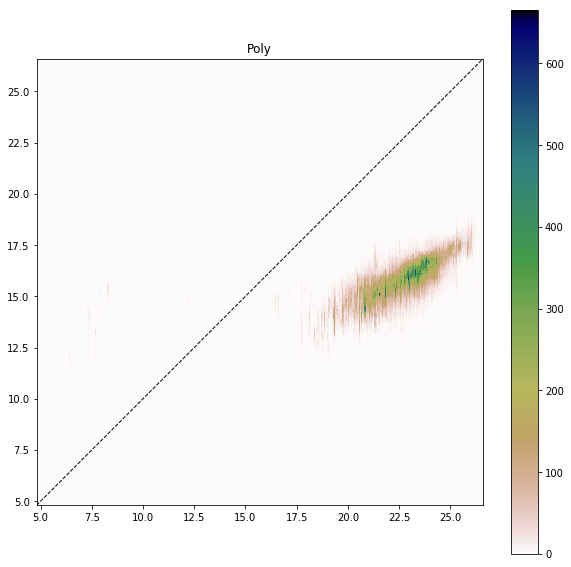

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


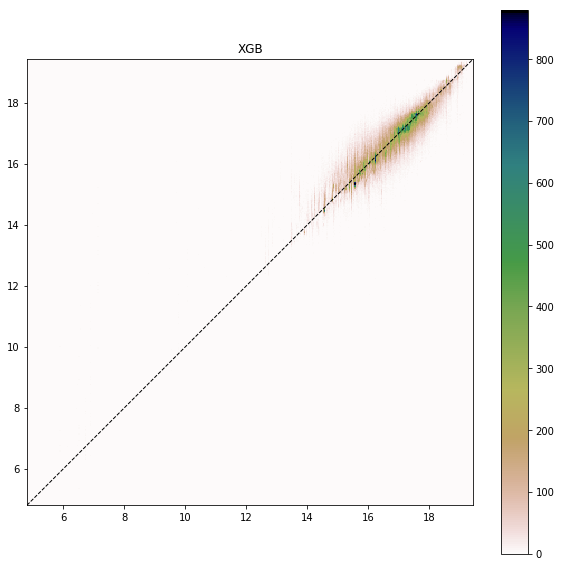

In [85]:
make_heatmap(compare_ridge,title='Ridge')
make_heatmap(compare_lasso,title='Lasso')
make_heatmap(compare_lr,title='Linear')
make_heatmap(compare_poly,title='Poly')
make_heatmap(compare_xgb,title='XGB')


Future steps: feature importances eli5, shap...